# 2. Clustering  
To solve this task, you must:  
1.Implement the k-means clustering algorithm (not ++: random initialization). We ask you to write the algorithm from scratch following what you learned in class.  
2.Run the algorithm on the food data. Then, use the already implemented version of k-means++, are there any differences in results?  
3.Analyse the obtained clusters:  
*Identify the kind of products in the cluster (e.g., chips, tea, coffee) using a visualization called word cloud.  
*Provide the number of product in each cluster  
*Compute the reviews' score distribution in each cluster. Once you get them, test if their mean differences are statistically significant!  
*Get the number of unique users writing reviews in each cluster  

## 2.1 Define the K-Means Algorithm

### 2.1.1 import modules

In [43]:
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer
from sklearn.decomposition import TruncatedSVD 
from sklearn.feature_extraction.text import TfidfVectorizer,CountVectorizer, TfidfTransformer 

### 2.1.2 Read Data

In [3]:
dataset = pd.read_csv('Reviews.csv')

In [4]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568438 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB


### 2.1.3 Data Clean-Up

In [5]:
dataset.isnull().sum()

Id                         0
ProductId                  0
UserId                     0
ProfileName               16
HelpfulnessNumerator       0
HelpfulnessDenominator     0
Score                      0
Time                       0
Summary                   27
Text                       0
dtype: int64

In [6]:
dataset['ProfileName'].fillna('',inplace=True)
dataset['Summary'].fillna('',inplace=True)

In [7]:
dataset.isnull().sum()

Id                        0
ProductId                 0
UserId                    0
ProfileName               0
HelpfulnessNumerator      0
HelpfulnessDenominator    0
Score                     0
Time                      0
Summary                   0
Text                      0
dtype: int64

In [8]:
dataset.head(5)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [9]:
dataset.iloc[0].Time

1303862400

In [10]:
pd.to_datetime(dataset.iloc[0].Time,unit='s')

Timestamp('2011-04-27 00:00:00')

In [11]:
dataset['Datetime'] = dataset.Time.apply(lambda value:pd.to_datetime(value,unit='s'))

### 2.1.4 Extract features

In [12]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [13]:
lemmatizer = WordNetLemmatizer()
stop_words=set(stopwords.words('english'))

In [14]:
def clean_text(text):
    words = word_tokenize(text)    
    filtered_words = []
    for word in words:        
        if word.lower() not in stop_words and word.isalpha():
            filtered_words.append(lemmatizer.lemmatize(word.lower()))
    return filtered_words

In [15]:
dataset['Summary'] = dataset['Summary'].apply(lambda text:clean_text(text))

In [16]:
dataset['Text'] = dataset['Text'].apply(lambda text:clean_text(text))

In [17]:
df=dataset[['ProductId','Summary','Text']]

In [18]:
df.head(5)

,ProductId,Summary,Text
0,B001E4KFG0,"[good, quality, dog, food]","[bought, several, vitality, canned, dog, food,..."
1,B00813GRG4,[advertised],"[product, arrived, labeled, jumbo, salted, pea..."
2,B000LQOCH0,"[delight, say]","[confection, around, century, light, pillowy, ..."
3,B000UA0QIQ,"[cough, medicine]","[looking, secret, ingredient, robitussin, beli..."
4,B006K2ZZ7K,"[great, taffy]","[great, taffy, great, price, wide, assortment,..."


In [19]:
type(df)

pandas.core.frame.DataFrame

In [20]:
words=[] 
all_words = [] 
for i in range(len(df)):
    c_all = []
    for wordt in df['Summary'][i]:
        words.append(wordt)
        c_all.append(wordt)
    for wordp in df['Text'][i]:
        words.append(wordp)
        c_all.append(wordp)
    all_words.append(c_all)
df["Discription"] = pd.Series(all_words)
df.head(5) 

<ipython-input-20-684dc4e01a49>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Discription"] = pd.Series(all_words)


,ProductId,Summary,Text,Discription
0,B001E4KFG0,"[good, quality, dog, food]","[bought, several, vitality, canned, dog, food,...","[good, quality, dog, food, bought, several, vi..."
1,B00813GRG4,[advertised],"[product, arrived, labeled, jumbo, salted, pea...","[advertised, product, arrived, labeled, jumbo,..."
2,B000LQOCH0,"[delight, say]","[confection, around, century, light, pillowy, ...","[delight, say, confection, around, century, li..."
3,B000UA0QIQ,"[cough, medicine]","[looking, secret, ingredient, robitussin, beli...","[cough, medicine, looking, secret, ingredient,..."
4,B006K2ZZ7K,"[great, taffy]","[great, taffy, great, price, wide, assortment,...","[great, taffy, great, taffy, great, price, wid..."


In [21]:
dfn = df[['ProductId','Discription']]

In [22]:
dfn.head()

,ProductId,Discription
0,B001E4KFG0,"[good, quality, dog, food, bought, several, vi..."
1,B00813GRG4,"[advertised, product, arrived, labeled, jumbo,..."
2,B000LQOCH0,"[delight, say, confection, around, century, li..."
3,B000UA0QIQ,"[cough, medicine, looking, secret, ingredient,..."
4,B006K2ZZ7K,"[great, taffy, great, taffy, great, price, wid..."


In [23]:
dfn = dfn['Discription'].agg(lambda x: ' '.join(x)).reset_index()

In [24]:
dfn

,index,Discription
0,0,good quality dog food bought several vitality ...
1,1,advertised product arrived labeled jumbo salte...
2,2,delight say confection around century light pi...
3,3,cough medicine looking secret ingredient robit...
4,4,great taffy great taffy great price wide assor...
...,...,...
568449,568449,without great sesame chicken good better restu...
568450,568450,disappointed disappointed flavor chocolate not...
568451,568451,perfect maltipoo star small give one training ...
568452,568452,favorite training reward treat best treat trai...


### 2.1.5 Skicit-learn K-means++

In [ ]:
vectorizer = CountVectorizer()
transformer = TfidfTransformer()
tfidf = transformer.fit_transform(vectorizer.fit_transform(dfn['Discription']))

#### reduce the dimensionality of the dataset's feature
 * a number of components that retain> 60% of the variance 

100%|███████████████████████████████████████████████████████████████████████████████| 14/14 [1:59:56<00:00, 514.00s/it]


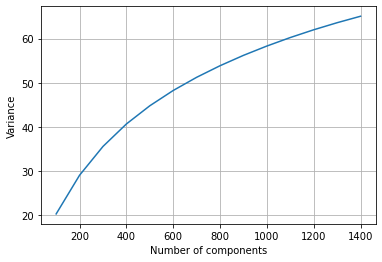

In [45]:
components= {}
for num in tqdm(range(100, 1500, 100)):
    svd = TruncatedSVD(n_components=num)
    svd.fit_transform(tfidf)
    components[num] = round(np.cumsum(svd.explained_variance_ratio_)[-1], 5) * 100
    del svd
plt.plot(list(components.keys()), list(components.values()))
plt.xlabel('Number of components')
plt.ylabel('Variance')
plt.grid()
plt.show()

In [46]:

svd = TruncatedSVD(n_components=1200)
normalizer = Normalizer(copy=False)
mp = make_pipeline(svd, normalizer)
reduced = mp.fit_transform(tfidf)

In [47]:
reduced

array([[ 0.26324182, -0.19594496, -0.04716568, ..., -0.01823233,
         0.04219661,  0.00635989],
       [ 0.091213  , -0.04244946, -0.00880783, ...,  0.03207198,
        -0.01137357, -0.02939239],
       [ 0.09773761, -0.05135853, -0.00896363, ..., -0.0049308 ,
         0.01373345,  0.03091342],
       ...,
       [ 0.26512699, -0.24435019, -0.05682201, ...,  0.01604051,
         0.02175232, -0.00195463],
       [ 0.1459005 , -0.12289729, -0.03295071, ...,  0.00425589,
        -0.00206819,  0.00847014],
       [ 0.09542786, -0.0117031 ,  0.00438408, ...,  0.00450961,
         0.02989111, -0.03254712]])

In [48]:
kmeans = KMeans(n_clusters=20)
kmeans.fit(reduced)

KMeans(n_clusters=20)

In [49]:
print(kmeans.cluster_centers_)
for index, label in enumerate(kmeans.labels_, 1):
    print("index: {}, label: {}".format(index, label))


[[ 1.57010694e-01 -1.97619247e-02 -3.99757184e-03 ...  1.67467693e-04
  -9.65374450e-05  1.53329268e-05]
 [ 1.76124978e-01 -3.19196642e-02 -3.70299667e-03 ...  2.03430555e-04
  -3.33744363e-04  3.25689024e-04]
 [ 3.17014779e-01 -1.20375118e-01 -1.34211291e-02 ... -3.00603981e-05
   2.02575392e-04 -4.18727111e-05]
 ...
 [ 1.76690977e-01 -2.27880958e-02 -4.22328662e-03 ...  5.80803757e-05
  -2.45457991e-04 -1.36519052e-04]
 [ 1.83757203e-01 -3.74281024e-02 -4.78222078e-03 ... -6.70102332e-05
  -1.77647732e-04 -3.32124449e-04]
 [ 2.14427384e-01 -1.64817094e-01 -3.50266095e-02 ... -8.13100885e-05
  -4.61792186e-05  4.23117355e-04]]
index: 1, label: 14
index: 2, label: 13
index: 3, label: 3
index: 4, label: 8
index: 5, label: 3
index: 6, label: 8
index: 7, label: 0
index: 8, label: 8
index: 9, label: 19
index: 10, label: 14
index: 11, label: 7
index: 12, label: 14
index: 13, label: 19
index: 14, label: 8
index: 15, label: 3
index: 16, label: 3
index: 17, label: 3
index: 18, label: 3
index: 

index: 2283, label: 5
index: 2284, label: 5
index: 2285, label: 3
index: 2286, label: 3
index: 2287, label: 2
index: 2288, label: 9
index: 2289, label: 3
index: 2290, label: 3
index: 2291, label: 3
index: 2292, label: 8
index: 2293, label: 2
index: 2294, label: 3
index: 2295, label: 2
index: 2296, label: 13
index: 2297, label: 5
index: 2298, label: 5
index: 2299, label: 5
index: 2300, label: 2
index: 2301, label: 2
index: 2302, label: 3
index: 2303, label: 10
index: 2304, label: 10
index: 2305, label: 10
index: 2306, label: 10
index: 2307, label: 10
index: 2308, label: 10
index: 2309, label: 10
index: 2310, label: 13
index: 2311, label: 3
index: 2312, label: 3
index: 2313, label: 8
index: 2314, label: 3
index: 2315, label: 3
index: 2316, label: 8
index: 2317, label: 3
index: 2318, label: 3
index: 2319, label: 2
index: 2320, label: 13
index: 2321, label: 3
index: 2322, label: 3
index: 2323, label: 3
index: 2324, label: 13
index: 2325, label: 3
index: 2326, label: 9
index: 2327, label: 3

index: 4429, label: 0
index: 4430, label: 0
index: 4431, label: 12
index: 4432, label: 3
index: 4433, label: 3
index: 4434, label: 3
index: 4435, label: 10
index: 4436, label: 3
index: 4437, label: 12
index: 4438, label: 3
index: 4439, label: 12
index: 4440, label: 2
index: 4441, label: 13
index: 4442, label: 7
index: 4443, label: 7
index: 4444, label: 3
index: 4445, label: 13
index: 4446, label: 13
index: 4447, label: 3
index: 4448, label: 3
index: 4449, label: 13
index: 4450, label: 3
index: 4451, label: 3
index: 4452, label: 2
index: 4453, label: 13
index: 4454, label: 3
index: 4455, label: 3
index: 4456, label: 2
index: 4457, label: 3
index: 4458, label: 3
index: 4459, label: 13
index: 4460, label: 13
index: 4461, label: 3
index: 4462, label: 3
index: 4463, label: 3
index: 4464, label: 3
index: 4465, label: 3
index: 4466, label: 3
index: 4467, label: 3
index: 4468, label: 13
index: 4469, label: 1
index: 4470, label: 3
index: 4471, label: 2
index: 4472, label: 13
index: 4473, label:

index: 6709, label: 3
index: 6710, label: 3
index: 6711, label: 8
index: 6712, label: 3
index: 6713, label: 8
index: 6714, label: 2
index: 6715, label: 8
index: 6716, label: 8
index: 6717, label: 2
index: 6718, label: 8
index: 6719, label: 2
index: 6720, label: 2
index: 6721, label: 3
index: 6722, label: 3
index: 6723, label: 8
index: 6724, label: 3
index: 6725, label: 8
index: 6726, label: 3
index: 6727, label: 3
index: 6728, label: 8
index: 6729, label: 8
index: 6730, label: 2
index: 6731, label: 8
index: 6732, label: 3
index: 6733, label: 2
index: 6734, label: 3
index: 6735, label: 3
index: 6736, label: 2
index: 6737, label: 8
index: 6738, label: 2
index: 6739, label: 3
index: 6740, label: 2
index: 6741, label: 2
index: 6742, label: 2
index: 6743, label: 8
index: 6744, label: 2
index: 6745, label: 3
index: 6746, label: 2
index: 6747, label: 3
index: 6748, label: 8
index: 6749, label: 8
index: 6750, label: 8
index: 6751, label: 8
index: 6752, label: 8
index: 6753, label: 2
index: 675

index: 9095, label: 4
index: 9096, label: 4
index: 9097, label: 4
index: 9098, label: 4
index: 9099, label: 4
index: 9100, label: 4
index: 9101, label: 8
index: 9102, label: 4
index: 9103, label: 4
index: 9104, label: 4
index: 9105, label: 4
index: 9106, label: 4
index: 9107, label: 4
index: 9108, label: 3
index: 9109, label: 8
index: 9110, label: 4
index: 9111, label: 4
index: 9112, label: 4
index: 9113, label: 8
index: 9114, label: 4
index: 9115, label: 17
index: 9116, label: 4
index: 9117, label: 4
index: 9118, label: 4
index: 9119, label: 4
index: 9120, label: 4
index: 9121, label: 13
index: 9122, label: 4
index: 9123, label: 4
index: 9124, label: 3
index: 9125, label: 8
index: 9126, label: 4
index: 9127, label: 4
index: 9128, label: 4
index: 9129, label: 8
index: 9130, label: 8
index: 9131, label: 3
index: 9132, label: 2
index: 9133, label: 4
index: 9134, label: 4
index: 9135, label: 8
index: 9136, label: 4
index: 9137, label: 4
index: 9138, label: 8
index: 9139, label: 4
index: 9

index: 12281, label: 3
index: 12282, label: 3
index: 12283, label: 13
index: 12284, label: 10
index: 12285, label: 10
index: 12286, label: 10
index: 12287, label: 10
index: 12288, label: 10
index: 12289, label: 10
index: 12290, label: 10
index: 12291, label: 10
index: 12292, label: 13
index: 12293, label: 3
index: 12294, label: 15
index: 12295, label: 5
index: 12296, label: 15
index: 12297, label: 3
index: 12298, label: 3
index: 12299, label: 2
index: 12300, label: 2
index: 12301, label: 2
index: 12302, label: 9
index: 12303, label: 2
index: 12304, label: 13
index: 12305, label: 13
index: 12306, label: 13
index: 12307, label: 2
index: 12308, label: 3
index: 12309, label: 2
index: 12310, label: 15
index: 12311, label: 2
index: 12312, label: 13
index: 12313, label: 8
index: 12314, label: 3
index: 12315, label: 3
index: 12316, label: 16
index: 12317, label: 16
index: 12318, label: 12
index: 12319, label: 16
index: 12320, label: 2
index: 12321, label: 9
index: 12322, label: 2
index: 12323,

index: 14843, label: 8
index: 14844, label: 3
index: 14845, label: 3
index: 14846, label: 2
index: 14847, label: 3
index: 14848, label: 3
index: 14849, label: 3
index: 14850, label: 10
index: 14851, label: 10
index: 14852, label: 3
index: 14853, label: 3
index: 14854, label: 13
index: 14855, label: 1
index: 14856, label: 1
index: 14857, label: 1
index: 14858, label: 1
index: 14859, label: 1
index: 14860, label: 3
index: 14861, label: 13
index: 14862, label: 3
index: 14863, label: 1
index: 14864, label: 1
index: 14865, label: 1
index: 14866, label: 1
index: 14867, label: 1
index: 14868, label: 1
index: 14869, label: 1
index: 14870, label: 9
index: 14871, label: 1
index: 14872, label: 16
index: 14873, label: 16
index: 14874, label: 1
index: 14875, label: 3
index: 14876, label: 2
index: 14877, label: 3
index: 14878, label: 15
index: 14879, label: 15
index: 14880, label: 15
index: 14881, label: 15
index: 14882, label: 15
index: 14883, label: 15
index: 14884, label: 3
index: 14885, label: 1

index: 17640, label: 10
index: 17641, label: 3
index: 17642, label: 12
index: 17643, label: 12
index: 17644, label: 16
index: 17645, label: 12
index: 17646, label: 16
index: 17647, label: 12
index: 17648, label: 16
index: 17649, label: 12
index: 17650, label: 12
index: 17651, label: 9
index: 17652, label: 12
index: 17653, label: 16
index: 17654, label: 3
index: 17655, label: 13
index: 17656, label: 2
index: 17657, label: 14
index: 17658, label: 13
index: 17659, label: 3
index: 17660, label: 5
index: 17661, label: 3
index: 17662, label: 0
index: 17663, label: 9
index: 17664, label: 3
index: 17665, label: 4
index: 17666, label: 13
index: 17667, label: 3
index: 17668, label: 8
index: 17669, label: 3
index: 17670, label: 3
index: 17671, label: 3
index: 17672, label: 3
index: 17673, label: 3
index: 17674, label: 3
index: 17675, label: 3
index: 17676, label: 13
index: 17677, label: 3
index: 17678, label: 3
index: 17679, label: 3
index: 17680, label: 3
index: 17681, label: 14
index: 17682, la

index: 20181, label: 3
index: 20182, label: 3
index: 20183, label: 2
index: 20184, label: 3
index: 20185, label: 3
index: 20186, label: 13
index: 20187, label: 3
index: 20188, label: 5
index: 20189, label: 5
index: 20190, label: 5
index: 20191, label: 5
index: 20192, label: 5
index: 20193, label: 5
index: 20194, label: 5
index: 20195, label: 5
index: 20196, label: 5
index: 20197, label: 5
index: 20198, label: 5
index: 20199, label: 5
index: 20200, label: 9
index: 20201, label: 9
index: 20202, label: 13
index: 20203, label: 3
index: 20204, label: 13
index: 20205, label: 9
index: 20206, label: 3
index: 20207, label: 9
index: 20208, label: 13
index: 20209, label: 3
index: 20210, label: 3
index: 20211, label: 3
index: 20212, label: 3
index: 20213, label: 3
index: 20214, label: 3
index: 20215, label: 3
index: 20216, label: 3
index: 20217, label: 3
index: 20218, label: 3
index: 20219, label: 3
index: 20220, label: 13
index: 20221, label: 8
index: 20222, label: 0
index: 20223, label: 3
index:

index: 22814, label: 2
index: 22815, label: 3
index: 22816, label: 10
index: 22817, label: 13
index: 22818, label: 10
index: 22819, label: 10
index: 22820, label: 10
index: 22821, label: 11
index: 22822, label: 9
index: 22823, label: 3
index: 22824, label: 3
index: 22825, label: 13
index: 22826, label: 2
index: 22827, label: 3
index: 22828, label: 3
index: 22829, label: 13
index: 22830, label: 3
index: 22831, label: 3
index: 22832, label: 0
index: 22833, label: 0
index: 22834, label: 3
index: 22835, label: 13
index: 22836, label: 8
index: 22837, label: 2
index: 22838, label: 13
index: 22839, label: 3
index: 22840, label: 3
index: 22841, label: 3
index: 22842, label: 3
index: 22843, label: 13
index: 22844, label: 8
index: 22845, label: 3
index: 22846, label: 13
index: 22847, label: 3
index: 22848, label: 3
index: 22849, label: 2
index: 22850, label: 3
index: 22851, label: 3
index: 22852, label: 3
index: 22853, label: 13
index: 22854, label: 3
index: 22855, label: 3
index: 22856, label: 

index: 25683, label: 3
index: 25684, label: 2
index: 25685, label: 3
index: 25686, label: 3
index: 25687, label: 10
index: 25688, label: 2
index: 25689, label: 13
index: 25690, label: 8
index: 25691, label: 13
index: 25692, label: 8
index: 25693, label: 2
index: 25694, label: 9
index: 25695, label: 2
index: 25696, label: 3
index: 25697, label: 8
index: 25698, label: 3
index: 25699, label: 8
index: 25700, label: 8
index: 25701, label: 3
index: 25702, label: 13
index: 25703, label: 8
index: 25704, label: 8
index: 25705, label: 3
index: 25706, label: 3
index: 25707, label: 13
index: 25708, label: 3
index: 25709, label: 3
index: 25710, label: 8
index: 25711, label: 0
index: 25712, label: 3
index: 25713, label: 3
index: 25714, label: 3
index: 25715, label: 9
index: 25716, label: 8
index: 25717, label: 8
index: 25718, label: 3
index: 25719, label: 3
index: 25720, label: 2
index: 25721, label: 8
index: 25722, label: 2
index: 25723, label: 3
index: 25724, label: 2
index: 25725, label: 2
index:

index: 28841, label: 3
index: 28842, label: 12
index: 28843, label: 3
index: 28844, label: 12
index: 28845, label: 12
index: 28846, label: 12
index: 28847, label: 12
index: 28848, label: 12
index: 28849, label: 3
index: 28850, label: 12
index: 28851, label: 14
index: 28852, label: 13
index: 28853, label: 9
index: 28854, label: 13
index: 28855, label: 16
index: 28856, label: 16
index: 28857, label: 16
index: 28858, label: 8
index: 28859, label: 16
index: 28860, label: 3
index: 28861, label: 0
index: 28862, label: 3
index: 28863, label: 9
index: 28864, label: 3
index: 28865, label: 3
index: 28866, label: 2
index: 28867, label: 0
index: 28868, label: 16
index: 28869, label: 3
index: 28870, label: 3
index: 28871, label: 3
index: 28872, label: 2
index: 28873, label: 0
index: 28874, label: 0
index: 28875, label: 3
index: 28876, label: 3
index: 28877, label: 0
index: 28878, label: 2
index: 28879, label: 3
index: 28880, label: 13
index: 28881, label: 16
index: 28882, label: 16
index: 28883, la

index: 31340, label: 8
index: 31341, label: 8
index: 31342, label: 2
index: 31343, label: 3
index: 31344, label: 15
index: 31345, label: 7
index: 31346, label: 3
index: 31347, label: 3
index: 31348, label: 2
index: 31349, label: 10
index: 31350, label: 3
index: 31351, label: 10
index: 31352, label: 10
index: 31353, label: 3
index: 31354, label: 9
index: 31355, label: 9
index: 31356, label: 13
index: 31357, label: 8
index: 31358, label: 3
index: 31359, label: 4
index: 31360, label: 8
index: 31361, label: 9
index: 31362, label: 5
index: 31363, label: 5
index: 31364, label: 3
index: 31365, label: 5
index: 31366, label: 5
index: 31367, label: 15
index: 31368, label: 0
index: 31369, label: 3
index: 31370, label: 9
index: 31371, label: 8
index: 31372, label: 10
index: 31373, label: 10
index: 31374, label: 10
index: 31375, label: 10
index: 31376, label: 10
index: 31377, label: 10
index: 31378, label: 10
index: 31379, label: 10
index: 31380, label: 10
index: 31381, label: 8
index: 31382, label

index: 33764, label: 8
index: 33765, label: 4
index: 33766, label: 4
index: 33767, label: 8
index: 33768, label: 3
index: 33769, label: 4
index: 33770, label: 3
index: 33771, label: 5
index: 33772, label: 15
index: 33773, label: 13
index: 33774, label: 4
index: 33775, label: 15
index: 33776, label: 15
index: 33777, label: 2
index: 33778, label: 3
index: 33779, label: 10
index: 33780, label: 2
index: 33781, label: 10
index: 33782, label: 5
index: 33783, label: 5
index: 33784, label: 5
index: 33785, label: 3
index: 33786, label: 3
index: 33787, label: 8
index: 33788, label: 2
index: 33789, label: 3
index: 33790, label: 8
index: 33791, label: 9
index: 33792, label: 3
index: 33793, label: 8
index: 33794, label: 8
index: 33795, label: 8
index: 33796, label: 3
index: 33797, label: 8
index: 33798, label: 3
index: 33799, label: 2
index: 33800, label: 2
index: 33801, label: 8
index: 33802, label: 3
index: 33803, label: 3
index: 33804, label: 16
index: 33805, label: 3
index: 33806, label: 3
inde

index: 36543, label: 15
index: 36544, label: 15
index: 36545, label: 13
index: 36546, label: 15
index: 36547, label: 7
index: 36548, label: 15
index: 36549, label: 3
index: 36550, label: 15
index: 36551, label: 15
index: 36552, label: 15
index: 36553, label: 3
index: 36554, label: 3
index: 36555, label: 15
index: 36556, label: 15
index: 36557, label: 15
index: 36558, label: 3
index: 36559, label: 7
index: 36560, label: 3
index: 36561, label: 15
index: 36562, label: 3
index: 36563, label: 15
index: 36564, label: 3
index: 36565, label: 15
index: 36566, label: 3
index: 36567, label: 15
index: 36568, label: 15
index: 36569, label: 15
index: 36570, label: 7
index: 36571, label: 8
index: 36572, label: 15
index: 36573, label: 15
index: 36574, label: 15
index: 36575, label: 15
index: 36576, label: 3
index: 36577, label: 15
index: 36578, label: 15
index: 36579, label: 15
index: 36580, label: 2
index: 36581, label: 3
index: 36582, label: 3
index: 36583, label: 8
index: 36584, label: 15
index: 36

index: 39215, label: 2
index: 39216, label: 13
index: 39217, label: 0
index: 39218, label: 8
index: 39219, label: 15
index: 39220, label: 3
index: 39221, label: 13
index: 39222, label: 15
index: 39223, label: 17
index: 39224, label: 3
index: 39225, label: 17
index: 39226, label: 17
index: 39227, label: 8
index: 39228, label: 15
index: 39229, label: 17
index: 39230, label: 2
index: 39231, label: 13
index: 39232, label: 3
index: 39233, label: 3
index: 39234, label: 3
index: 39235, label: 1
index: 39236, label: 1
index: 39237, label: 1
index: 39238, label: 3
index: 39239, label: 1
index: 39240, label: 5
index: 39241, label: 5
index: 39242, label: 9
index: 39243, label: 5
index: 39244, label: 5
index: 39245, label: 3
index: 39246, label: 8
index: 39247, label: 13
index: 39248, label: 8
index: 39249, label: 5
index: 39250, label: 5
index: 39251, label: 5
index: 39252, label: 2
index: 39253, label: 12
index: 39254, label: 12
index: 39255, label: 18
index: 39256, label: 12
index: 39257, label

index: 41946, label: 19
index: 41947, label: 10
index: 41948, label: 10
index: 41949, label: 19
index: 41950, label: 10
index: 41951, label: 19
index: 41952, label: 19
index: 41953, label: 19
index: 41954, label: 10
index: 41955, label: 3
index: 41956, label: 10
index: 41957, label: 10
index: 41958, label: 19
index: 41959, label: 10
index: 41960, label: 2
index: 41961, label: 10
index: 41962, label: 19
index: 41963, label: 19
index: 41964, label: 10
index: 41965, label: 19
index: 41966, label: 10
index: 41967, label: 10
index: 41968, label: 10
index: 41969, label: 10
index: 41970, label: 10
index: 41971, label: 10
index: 41972, label: 10
index: 41973, label: 19
index: 41974, label: 19
index: 41975, label: 10
index: 41976, label: 19
index: 41977, label: 10
index: 41978, label: 19
index: 41979, label: 19
index: 41980, label: 10
index: 41981, label: 19
index: 41982, label: 19
index: 41983, label: 10
index: 41984, label: 19
index: 41985, label: 19
index: 41986, label: 13
index: 41987, labe

index: 44838, label: 3
index: 44839, label: 3
index: 44840, label: 10
index: 44841, label: 2
index: 44842, label: 10
index: 44843, label: 10
index: 44844, label: 3
index: 44845, label: 3
index: 44846, label: 10
index: 44847, label: 10
index: 44848, label: 3
index: 44849, label: 2
index: 44850, label: 10
index: 44851, label: 2
index: 44852, label: 10
index: 44853, label: 10
index: 44854, label: 3
index: 44855, label: 3
index: 44856, label: 10
index: 44857, label: 13
index: 44858, label: 3
index: 44859, label: 8
index: 44860, label: 15
index: 44861, label: 7
index: 44862, label: 7
index: 44863, label: 7
index: 44864, label: 7
index: 44865, label: 7
index: 44866, label: 9
index: 44867, label: 7
index: 44868, label: 15
index: 44869, label: 7
index: 44870, label: 3
index: 44871, label: 3
index: 44872, label: 8
index: 44873, label: 17
index: 44874, label: 8
index: 44875, label: 8
index: 44876, label: 0
index: 44877, label: 3
index: 44878, label: 10
index: 44879, label: 10
index: 44880, label

index: 46837, label: 7
index: 46838, label: 7
index: 46839, label: 3
index: 46840, label: 8
index: 46841, label: 17
index: 46842, label: 17
index: 46843, label: 3
index: 46844, label: 17
index: 46845, label: 17
index: 46846, label: 3
index: 46847, label: 17
index: 46848, label: 17
index: 46849, label: 17
index: 46850, label: 3
index: 46851, label: 17
index: 46852, label: 17
index: 46853, label: 17
index: 46854, label: 17
index: 46855, label: 3
index: 46856, label: 17
index: 46857, label: 2
index: 46858, label: 3
index: 46859, label: 2
index: 46860, label: 17
index: 46861, label: 3
index: 46862, label: 2
index: 46863, label: 17
index: 46864, label: 17
index: 46865, label: 2
index: 46866, label: 17
index: 46867, label: 17
index: 46868, label: 17
index: 46869, label: 2
index: 46870, label: 17
index: 46871, label: 17
index: 46872, label: 2
index: 46873, label: 2
index: 46874, label: 13
index: 46875, label: 5
index: 46876, label: 5
index: 46877, label: 3
index: 46878, label: 9
index: 46879,

index: 49337, label: 3
index: 49338, label: 8
index: 49339, label: 8
index: 49340, label: 3
index: 49341, label: 3
index: 49342, label: 13
index: 49343, label: 3
index: 49344, label: 3
index: 49345, label: 3
index: 49346, label: 3
index: 49347, label: 3
index: 49348, label: 8
index: 49349, label: 3
index: 49350, label: 2
index: 49351, label: 13
index: 49352, label: 3
index: 49353, label: 3
index: 49354, label: 3
index: 49355, label: 8
index: 49356, label: 8
index: 49357, label: 3
index: 49358, label: 2
index: 49359, label: 11
index: 49360, label: 8
index: 49361, label: 3
index: 49362, label: 3
index: 49363, label: 3
index: 49364, label: 3
index: 49365, label: 3
index: 49366, label: 8
index: 49367, label: 8
index: 49368, label: 3
index: 49369, label: 3
index: 49370, label: 3
index: 49371, label: 2
index: 49372, label: 3
index: 49373, label: 3
index: 49374, label: 3
index: 49375, label: 3
index: 49376, label: 3
index: 49377, label: 3
index: 49378, label: 3
index: 49379, label: 3
index: 4

index: 52135, label: 8
index: 52136, label: 16
index: 52137, label: 16
index: 52138, label: 16
index: 52139, label: 3
index: 52140, label: 16
index: 52141, label: 2
index: 52142, label: 3
index: 52143, label: 1
index: 52144, label: 16
index: 52145, label: 17
index: 52146, label: 13
index: 52147, label: 9
index: 52148, label: 18
index: 52149, label: 18
index: 52150, label: 18
index: 52151, label: 18
index: 52152, label: 18
index: 52153, label: 18
index: 52154, label: 18
index: 52155, label: 13
index: 52156, label: 3
index: 52157, label: 3
index: 52158, label: 15
index: 52159, label: 15
index: 52160, label: 3
index: 52161, label: 2
index: 52162, label: 2
index: 52163, label: 3
index: 52164, label: 3
index: 52165, label: 3
index: 52166, label: 2
index: 52167, label: 13
index: 52168, label: 13
index: 52169, label: 2
index: 52170, label: 2
index: 52171, label: 3
index: 52172, label: 3
index: 52173, label: 3
index: 52174, label: 2
index: 52175, label: 3
index: 52176, label: 2
index: 52177, l

index: 54765, label: 17
index: 54766, label: 17
index: 54767, label: 13
index: 54768, label: 17
index: 54769, label: 17
index: 54770, label: 17
index: 54771, label: 13
index: 54772, label: 13
index: 54773, label: 17
index: 54774, label: 17
index: 54775, label: 17
index: 54776, label: 17
index: 54777, label: 17
index: 54778, label: 17
index: 54779, label: 17
index: 54780, label: 17
index: 54781, label: 17
index: 54782, label: 3
index: 54783, label: 17
index: 54784, label: 17
index: 54785, label: 17
index: 54786, label: 17
index: 54787, label: 2
index: 54788, label: 2
index: 54789, label: 9
index: 54790, label: 17
index: 54791, label: 13
index: 54792, label: 13
index: 54793, label: 13
index: 54794, label: 17
index: 54795, label: 3
index: 54796, label: 17
index: 54797, label: 17
index: 54798, label: 13
index: 54799, label: 17
index: 54800, label: 13
index: 54801, label: 11
index: 54802, label: 11
index: 54803, label: 11
index: 54804, label: 10
index: 54805, label: 10
index: 54806, label: 

index: 57079, label: 9
index: 57080, label: 3
index: 57081, label: 3
index: 57082, label: 5
index: 57083, label: 5
index: 57084, label: 5
index: 57085, label: 8
index: 57086, label: 5
index: 57087, label: 5
index: 57088, label: 5
index: 57089, label: 3
index: 57090, label: 3
index: 57091, label: 8
index: 57092, label: 5
index: 57093, label: 5
index: 57094, label: 8
index: 57095, label: 5
index: 57096, label: 8
index: 57097, label: 13
index: 57098, label: 2
index: 57099, label: 10
index: 57100, label: 3
index: 57101, label: 3
index: 57102, label: 8
index: 57103, label: 8
index: 57104, label: 3
index: 57105, label: 13
index: 57106, label: 1
index: 57107, label: 3
index: 57108, label: 3
index: 57109, label: 18
index: 57110, label: 18
index: 57111, label: 3
index: 57112, label: 18
index: 57113, label: 18
index: 57114, label: 18
index: 57115, label: 13
index: 57116, label: 18
index: 57117, label: 18
index: 57118, label: 2
index: 57119, label: 18
index: 57120, label: 3
index: 57121, label: 3

index: 59835, label: 2
index: 59836, label: 3
index: 59837, label: 4
index: 59838, label: 3
index: 59839, label: 0
index: 59840, label: 0
index: 59841, label: 13
index: 59842, label: 9
index: 59843, label: 2
index: 59844, label: 2
index: 59845, label: 13
index: 59846, label: 13
index: 59847, label: 13
index: 59848, label: 3
index: 59849, label: 5
index: 59850, label: 5
index: 59851, label: 3
index: 59852, label: 5
index: 59853, label: 13
index: 59854, label: 5
index: 59855, label: 5
index: 59856, label: 5
index: 59857, label: 2
index: 59858, label: 16
index: 59859, label: 5
index: 59860, label: 5
index: 59861, label: 5
index: 59862, label: 5
index: 59863, label: 15
index: 59864, label: 15
index: 59865, label: 15
index: 59866, label: 15
index: 59867, label: 15
index: 59868, label: 15
index: 59869, label: 11
index: 59870, label: 8
index: 59871, label: 3
index: 59872, label: 12
index: 59873, label: 0
index: 59874, label: 3
index: 59875, label: 9
index: 59876, label: 12
index: 59877, label

index: 62112, label: 3
index: 62113, label: 5
index: 62114, label: 5
index: 62115, label: 5
index: 62116, label: 5
index: 62117, label: 3
index: 62118, label: 5
index: 62119, label: 5
index: 62120, label: 5
index: 62121, label: 5
index: 62122, label: 5
index: 62123, label: 5
index: 62124, label: 5
index: 62125, label: 5
index: 62126, label: 5
index: 62127, label: 5
index: 62128, label: 5
index: 62129, label: 5
index: 62130, label: 5
index: 62131, label: 5
index: 62132, label: 5
index: 62133, label: 8
index: 62134, label: 3
index: 62135, label: 5
index: 62136, label: 8
index: 62137, label: 5
index: 62138, label: 5
index: 62139, label: 5
index: 62140, label: 2
index: 62141, label: 5
index: 62142, label: 5
index: 62143, label: 5
index: 62144, label: 5
index: 62145, label: 2
index: 62146, label: 3
index: 62147, label: 5
index: 62148, label: 5
index: 62149, label: 5
index: 62150, label: 5
index: 62151, label: 3
index: 62152, label: 5
index: 62153, label: 5
index: 62154, label: 5
index: 6215

index: 65509, label: 2
index: 65510, label: 2
index: 65511, label: 3
index: 65512, label: 8
index: 65513, label: 2
index: 65514, label: 8
index: 65515, label: 2
index: 65516, label: 3
index: 65517, label: 3
index: 65518, label: 8
index: 65519, label: 3
index: 65520, label: 8
index: 65521, label: 2
index: 65522, label: 3
index: 65523, label: 8
index: 65524, label: 8
index: 65525, label: 8
index: 65526, label: 2
index: 65527, label: 8
index: 65528, label: 3
index: 65529, label: 2
index: 65530, label: 3
index: 65531, label: 3
index: 65532, label: 3
index: 65533, label: 8
index: 65534, label: 2
index: 65535, label: 2
index: 65536, label: 2
index: 65537, label: 2
index: 65538, label: 8
index: 65539, label: 2
index: 65540, label: 2
index: 65541, label: 3
index: 65542, label: 3
index: 65543, label: 2
index: 65544, label: 2
index: 65545, label: 3
index: 65546, label: 3
index: 65547, label: 3
index: 65548, label: 8
index: 65549, label: 2
index: 65550, label: 3
index: 65551, label: 2
index: 6555

index: 68102, label: 16
index: 68103, label: 5
index: 68104, label: 5
index: 68105, label: 5
index: 68106, label: 5
index: 68107, label: 3
index: 68108, label: 5
index: 68109, label: 5
index: 68110, label: 5
index: 68111, label: 1
index: 68112, label: 13
index: 68113, label: 13
index: 68114, label: 8
index: 68115, label: 13
index: 68116, label: 8
index: 68117, label: 13
index: 68118, label: 3
index: 68119, label: 13
index: 68120, label: 3
index: 68121, label: 3
index: 68122, label: 3
index: 68123, label: 13
index: 68124, label: 3
index: 68125, label: 3
index: 68126, label: 2
index: 68127, label: 13
index: 68128, label: 3
index: 68129, label: 8
index: 68130, label: 10
index: 68131, label: 10
index: 68132, label: 3
index: 68133, label: 3
index: 68134, label: 3
index: 68135, label: 8
index: 68136, label: 3
index: 68137, label: 2
index: 68138, label: 9
index: 68139, label: 3
index: 68140, label: 3
index: 68141, label: 3
index: 68142, label: 3
index: 68143, label: 3
index: 68144, label: 3
i

index: 70598, label: 8
index: 70599, label: 1
index: 70600, label: 1
index: 70601, label: 9
index: 70602, label: 3
index: 70603, label: 16
index: 70604, label: 1
index: 70605, label: 9
index: 70606, label: 1
index: 70607, label: 1
index: 70608, label: 1
index: 70609, label: 1
index: 70610, label: 3
index: 70611, label: 1
index: 70612, label: 1
index: 70613, label: 2
index: 70614, label: 1
index: 70615, label: 1
index: 70616, label: 1
index: 70617, label: 1
index: 70618, label: 1
index: 70619, label: 3
index: 70620, label: 16
index: 70621, label: 1
index: 70622, label: 3
index: 70623, label: 3
index: 70624, label: 1
index: 70625, label: 2
index: 70626, label: 1
index: 70627, label: 11
index: 70628, label: 1
index: 70629, label: 1
index: 70630, label: 1
index: 70631, label: 1
index: 70632, label: 11
index: 70633, label: 1
index: 70634, label: 15
index: 70635, label: 1
index: 70636, label: 3
index: 70637, label: 1
index: 70638, label: 16
index: 70639, label: 3
index: 70640, label: 1
index

index: 73178, label: 0
index: 73179, label: 14
index: 73180, label: 4
index: 73181, label: 1
index: 73182, label: 3
index: 73183, label: 3
index: 73184, label: 3
index: 73185, label: 16
index: 73186, label: 13
index: 73187, label: 2
index: 73188, label: 3
index: 73189, label: 3
index: 73190, label: 3
index: 73191, label: 13
index: 73192, label: 3
index: 73193, label: 3
index: 73194, label: 3
index: 73195, label: 13
index: 73196, label: 8
index: 73197, label: 18
index: 73198, label: 2
index: 73199, label: 2
index: 73200, label: 4
index: 73201, label: 8
index: 73202, label: 9
index: 73203, label: 3
index: 73204, label: 4
index: 73205, label: 8
index: 73206, label: 3
index: 73207, label: 3
index: 73208, label: 4
index: 73209, label: 8
index: 73210, label: 3
index: 73211, label: 4
index: 73212, label: 4
index: 73213, label: 8
index: 73214, label: 2
index: 73215, label: 19
index: 73216, label: 3
index: 73217, label: 3
index: 73218, label: 6
index: 73219, label: 2
index: 73220, label: 3
inde

index: 75820, label: 3
index: 75821, label: 13
index: 75822, label: 4
index: 75823, label: 9
index: 75824, label: 2
index: 75825, label: 3
index: 75826, label: 3
index: 75827, label: 2
index: 75828, label: 2
index: 75829, label: 8
index: 75830, label: 13
index: 75831, label: 2
index: 75832, label: 3
index: 75833, label: 3
index: 75834, label: 3
index: 75835, label: 13
index: 75836, label: 8
index: 75837, label: 9
index: 75838, label: 3
index: 75839, label: 13
index: 75840, label: 3
index: 75841, label: 13
index: 75842, label: 9
index: 75843, label: 8
index: 75844, label: 3
index: 75845, label: 3
index: 75846, label: 3
index: 75847, label: 8
index: 75848, label: 3
index: 75849, label: 3
index: 75850, label: 3
index: 75851, label: 8
index: 75852, label: 3
index: 75853, label: 8
index: 75854, label: 8
index: 75855, label: 3
index: 75856, label: 3
index: 75857, label: 8
index: 75858, label: 8
index: 75859, label: 8
index: 75860, label: 8
index: 75861, label: 9
index: 75862, label: 3
index:

index: 78859, label: 3
index: 78860, label: 3
index: 78861, label: 3
index: 78862, label: 13
index: 78863, label: 13
index: 78864, label: 13
index: 78865, label: 3
index: 78866, label: 2
index: 78867, label: 8
index: 78868, label: 3
index: 78869, label: 9
index: 78870, label: 2
index: 78871, label: 3
index: 78872, label: 2
index: 78873, label: 2
index: 78874, label: 3
index: 78875, label: 16
index: 78876, label: 8
index: 78877, label: 3
index: 78878, label: 16
index: 78879, label: 3
index: 78880, label: 3
index: 78881, label: 16
index: 78882, label: 4
index: 78883, label: 16
index: 78884, label: 3
index: 78885, label: 13
index: 78886, label: 16
index: 78887, label: 3
index: 78888, label: 7
index: 78889, label: 3
index: 78890, label: 16
index: 78891, label: 16
index: 78892, label: 3
index: 78893, label: 3
index: 78894, label: 16
index: 78895, label: 3
index: 78896, label: 8
index: 78897, label: 3
index: 78898, label: 2
index: 78899, label: 16
index: 78900, label: 3
index: 78901, label: 

index: 81247, label: 3
index: 81248, label: 13
index: 81249, label: 10
index: 81250, label: 3
index: 81251, label: 3
index: 81252, label: 4
index: 81253, label: 13
index: 81254, label: 5
index: 81255, label: 5
index: 81256, label: 5
index: 81257, label: 3
index: 81258, label: 3
index: 81259, label: 3
index: 81260, label: 3
index: 81261, label: 3
index: 81262, label: 3
index: 81263, label: 13
index: 81264, label: 3
index: 81265, label: 3
index: 81266, label: 3
index: 81267, label: 3
index: 81268, label: 3
index: 81269, label: 3
index: 81270, label: 3
index: 81271, label: 8
index: 81272, label: 3
index: 81273, label: 2
index: 81274, label: 3
index: 81275, label: 13
index: 81276, label: 3
index: 81277, label: 0
index: 81278, label: 8
index: 81279, label: 13
index: 81280, label: 8
index: 81281, label: 3
index: 81282, label: 8
index: 81283, label: 8
index: 81284, label: 2
index: 81285, label: 3
index: 81286, label: 8
index: 81287, label: 3
index: 81288, label: 3
index: 81289, label: 3
index

index: 84192, label: 3
index: 84193, label: 3
index: 84194, label: 2
index: 84195, label: 13
index: 84196, label: 0
index: 84197, label: 16
index: 84198, label: 16
index: 84199, label: 11
index: 84200, label: 3
index: 84201, label: 3
index: 84202, label: 3
index: 84203, label: 3
index: 84204, label: 3
index: 84205, label: 9
index: 84206, label: 13
index: 84207, label: 7
index: 84208, label: 3
index: 84209, label: 13
index: 84210, label: 18
index: 84211, label: 3
index: 84212, label: 8
index: 84213, label: 5
index: 84214, label: 3
index: 84215, label: 2
index: 84216, label: 3
index: 84217, label: 2
index: 84218, label: 3
index: 84219, label: 3
index: 84220, label: 9
index: 84221, label: 3
index: 84222, label: 2
index: 84223, label: 2
index: 84224, label: 8
index: 84225, label: 3
index: 84226, label: 3
index: 84227, label: 3
index: 84228, label: 2
index: 84229, label: 3
index: 84230, label: 3
index: 84231, label: 3
index: 84232, label: 3
index: 84233, label: 3
index: 84234, label: 2
inde

index: 86358, label: 1
index: 86359, label: 3
index: 86360, label: 3
index: 86361, label: 3
index: 86362, label: 3
index: 86363, label: 16
index: 86364, label: 0
index: 86365, label: 5
index: 86366, label: 5
index: 86367, label: 5
index: 86368, label: 3
index: 86369, label: 13
index: 86370, label: 3
index: 86371, label: 3
index: 86372, label: 13
index: 86373, label: 13
index: 86374, label: 13
index: 86375, label: 13
index: 86376, label: 16
index: 86377, label: 17
index: 86378, label: 3
index: 86379, label: 3
index: 86380, label: 3
index: 86381, label: 8
index: 86382, label: 3
index: 86383, label: 3
index: 86384, label: 3
index: 86385, label: 1
index: 86386, label: 1
index: 86387, label: 3
index: 86388, label: 1
index: 86389, label: 1
index: 86390, label: 8
index: 86391, label: 3
index: 86392, label: 9
index: 86393, label: 13
index: 86394, label: 13
index: 86395, label: 2
index: 86396, label: 9
index: 86397, label: 3
index: 86398, label: 3
index: 86399, label: 3
index: 86400, label: 3
i

index: 88962, label: 3
index: 88963, label: 2
index: 88964, label: 8
index: 88965, label: 9
index: 88966, label: 4
index: 88967, label: 9
index: 88968, label: 4
index: 88969, label: 4
index: 88970, label: 4
index: 88971, label: 9
index: 88972, label: 4
index: 88973, label: 4
index: 88974, label: 4
index: 88975, label: 4
index: 88976, label: 4
index: 88977, label: 3
index: 88978, label: 8
index: 88979, label: 3
index: 88980, label: 17
index: 88981, label: 3
index: 88982, label: 3
index: 88983, label: 3
index: 88984, label: 3
index: 88985, label: 9
index: 88986, label: 13
index: 88987, label: 3
index: 88988, label: 8
index: 88989, label: 13
index: 88990, label: 12
index: 88991, label: 16
index: 88992, label: 3
index: 88993, label: 2
index: 88994, label: 8
index: 88995, label: 9
index: 88996, label: 3
index: 88997, label: 13
index: 88998, label: 3
index: 88999, label: 3
index: 89000, label: 3
index: 89001, label: 2
index: 89002, label: 3
index: 89003, label: 3
index: 89004, label: 2
index

index: 91829, label: 15
index: 91830, label: 15
index: 91831, label: 15
index: 91832, label: 15
index: 91833, label: 15
index: 91834, label: 3
index: 91835, label: 15
index: 91836, label: 13
index: 91837, label: 15
index: 91838, label: 3
index: 91839, label: 15
index: 91840, label: 15
index: 91841, label: 15
index: 91842, label: 15
index: 91843, label: 3
index: 91844, label: 3
index: 91845, label: 2
index: 91846, label: 13
index: 91847, label: 3
index: 91848, label: 8
index: 91849, label: 3
index: 91850, label: 3
index: 91851, label: 12
index: 91852, label: 13
index: 91853, label: 5
index: 91854, label: 5
index: 91855, label: 5
index: 91856, label: 9
index: 91857, label: 5
index: 91858, label: 8
index: 91859, label: 3
index: 91860, label: 13
index: 91861, label: 19
index: 91862, label: 19
index: 91863, label: 19
index: 91864, label: 19
index: 91865, label: 19
index: 91866, label: 13
index: 91867, label: 3
index: 91868, label: 13
index: 91869, label: 3
index: 91870, label: 3
index: 9187

index: 94390, label: 5
index: 94391, label: 11
index: 94392, label: 11
index: 94393, label: 11
index: 94394, label: 11
index: 94395, label: 14
index: 94396, label: 11
index: 94397, label: 11
index: 94398, label: 7
index: 94399, label: 8
index: 94400, label: 13
index: 94401, label: 11
index: 94402, label: 11
index: 94403, label: 11
index: 94404, label: 11
index: 94405, label: 11
index: 94406, label: 11
index: 94407, label: 11
index: 94408, label: 11
index: 94409, label: 11
index: 94410, label: 11
index: 94411, label: 11
index: 94412, label: 11
index: 94413, label: 11
index: 94414, label: 11
index: 94415, label: 11
index: 94416, label: 3
index: 94417, label: 11
index: 94418, label: 13
index: 94419, label: 11
index: 94420, label: 11
index: 94421, label: 11
index: 94422, label: 17
index: 94423, label: 3
index: 94424, label: 11
index: 94425, label: 11
index: 94426, label: 11
index: 94427, label: 11
index: 94428, label: 11
index: 94429, label: 3
index: 94430, label: 11
index: 94431, label: 1

index: 97328, label: 13
index: 97329, label: 11
index: 97330, label: 3
index: 97331, label: 8
index: 97332, label: 11
index: 97333, label: 3
index: 97334, label: 7
index: 97335, label: 3
index: 97336, label: 9
index: 97337, label: 2
index: 97338, label: 1
index: 97339, label: 3
index: 97340, label: 1
index: 97341, label: 1
index: 97342, label: 1
index: 97343, label: 3
index: 97344, label: 1
index: 97345, label: 3
index: 97346, label: 3
index: 97347, label: 3
index: 97348, label: 1
index: 97349, label: 9
index: 97350, label: 2
index: 97351, label: 2
index: 97352, label: 1
index: 97353, label: 13
index: 97354, label: 1
index: 97355, label: 1
index: 97356, label: 3
index: 97357, label: 1
index: 97358, label: 2
index: 97359, label: 13
index: 97360, label: 2
index: 97361, label: 3
index: 97362, label: 1
index: 97363, label: 1
index: 97364, label: 13
index: 97365, label: 1
index: 97366, label: 13
index: 97367, label: 3
index: 97368, label: 1
index: 97369, label: 1
index: 97370, label: 3
inde

index: 99591, label: 6
index: 99592, label: 13
index: 99593, label: 6
index: 99594, label: 6
index: 99595, label: 4
index: 99596, label: 3
index: 99597, label: 13
index: 99598, label: 3
index: 99599, label: 13
index: 99600, label: 10
index: 99601, label: 13
index: 99602, label: 3
index: 99603, label: 13
index: 99604, label: 13
index: 99605, label: 8
index: 99606, label: 9
index: 99607, label: 13
index: 99608, label: 19
index: 99609, label: 3
index: 99610, label: 2
index: 99611, label: 10
index: 99612, label: 3
index: 99613, label: 13
index: 99614, label: 10
index: 99615, label: 13
index: 99616, label: 5
index: 99617, label: 5
index: 99618, label: 5
index: 99619, label: 5
index: 99620, label: 14
index: 99621, label: 14
index: 99622, label: 14
index: 99623, label: 14
index: 99624, label: 14
index: 99625, label: 14
index: 99626, label: 0
index: 99627, label: 4
index: 99628, label: 2
index: 99629, label: 2
index: 99630, label: 2
index: 99631, label: 3
index: 99632, label: 13
index: 99633, 

index: 102827, label: 10
index: 102828, label: 3
index: 102829, label: 10
index: 102830, label: 10
index: 102831, label: 10
index: 102832, label: 13
index: 102833, label: 10
index: 102834, label: 3
index: 102835, label: 10
index: 102836, label: 10
index: 102837, label: 10
index: 102838, label: 10
index: 102839, label: 10
index: 102840, label: 3
index: 102841, label: 10
index: 102842, label: 10
index: 102843, label: 10
index: 102844, label: 10
index: 102845, label: 10
index: 102846, label: 10
index: 102847, label: 3
index: 102848, label: 10
index: 102849, label: 10
index: 102850, label: 10
index: 102851, label: 10
index: 102852, label: 10
index: 102853, label: 10
index: 102854, label: 3
index: 102855, label: 13
index: 102856, label: 10
index: 102857, label: 10
index: 102858, label: 13
index: 102859, label: 9
index: 102860, label: 10
index: 102861, label: 10
index: 102862, label: 10
index: 102863, label: 10
index: 102864, label: 10
index: 102865, label: 10
index: 102866, label: 3
index: 

index: 105509, label: 14
index: 105510, label: 14
index: 105511, label: 14
index: 105512, label: 14
index: 105513, label: 14
index: 105514, label: 14
index: 105515, label: 14
index: 105516, label: 2
index: 105517, label: 14
index: 105518, label: 14
index: 105519, label: 14
index: 105520, label: 3
index: 105521, label: 18
index: 105522, label: 0
index: 105523, label: 3
index: 105524, label: 0
index: 105525, label: 12
index: 105526, label: 5
index: 105527, label: 2
index: 105528, label: 5
index: 105529, label: 3
index: 105530, label: 5
index: 105531, label: 3
index: 105532, label: 3
index: 105533, label: 9
index: 105534, label: 3
index: 105535, label: 9
index: 105536, label: 15
index: 105537, label: 2
index: 105538, label: 3
index: 105539, label: 3
index: 105540, label: 8
index: 105541, label: 13
index: 105542, label: 9
index: 105543, label: 3
index: 105544, label: 9
index: 105545, label: 13
index: 105546, label: 3
index: 105547, label: 9
index: 105548, label: 3
index: 105549, label: 3
i

index: 108149, label: 8
index: 108150, label: 8
index: 108151, label: 4
index: 108152, label: 4
index: 108153, label: 4
index: 108154, label: 4
index: 108155, label: 4
index: 108156, label: 4
index: 108157, label: 3
index: 108158, label: 4
index: 108159, label: 4
index: 108160, label: 3
index: 108161, label: 4
index: 108162, label: 4
index: 108163, label: 4
index: 108164, label: 4
index: 108165, label: 4
index: 108166, label: 4
index: 108167, label: 4
index: 108168, label: 4
index: 108169, label: 4
index: 108170, label: 4
index: 108171, label: 8
index: 108172, label: 4
index: 108173, label: 4
index: 108174, label: 4
index: 108175, label: 4
index: 108176, label: 4
index: 108177, label: 4
index: 108178, label: 4
index: 108179, label: 4
index: 108180, label: 4
index: 108181, label: 4
index: 108182, label: 4
index: 108183, label: 4
index: 108184, label: 4
index: 108185, label: 3
index: 108186, label: 4
index: 108187, label: 4
index: 108188, label: 4
index: 108189, label: 13
index: 108190, 

index: 110648, label: 4
index: 110649, label: 13
index: 110650, label: 13
index: 110651, label: 9
index: 110652, label: 3
index: 110653, label: 3
index: 110654, label: 4
index: 110655, label: 9
index: 110656, label: 2
index: 110657, label: 4
index: 110658, label: 4
index: 110659, label: 4
index: 110660, label: 4
index: 110661, label: 3
index: 110662, label: 3
index: 110663, label: 3
index: 110664, label: 4
index: 110665, label: 2
index: 110666, label: 4
index: 110667, label: 13
index: 110668, label: 2
index: 110669, label: 3
index: 110670, label: 4
index: 110671, label: 4
index: 110672, label: 3
index: 110673, label: 4
index: 110674, label: 4
index: 110675, label: 4
index: 110676, label: 4
index: 110677, label: 9
index: 110678, label: 3
index: 110679, label: 3
index: 110680, label: 4
index: 110681, label: 3
index: 110682, label: 4
index: 110683, label: 13
index: 110684, label: 4
index: 110685, label: 13
index: 110686, label: 4
index: 110687, label: 2
index: 110688, label: 2
index: 1106

index: 113548, label: 3
index: 113549, label: 3
index: 113550, label: 3
index: 113551, label: 13
index: 113552, label: 2
index: 113553, label: 2
index: 113554, label: 2
index: 113555, label: 13
index: 113556, label: 3
index: 113557, label: 13
index: 113558, label: 2
index: 113559, label: 9
index: 113560, label: 3
index: 113561, label: 3
index: 113562, label: 9
index: 113563, label: 3
index: 113564, label: 3
index: 113565, label: 3
index: 113566, label: 9
index: 113567, label: 2
index: 113568, label: 3
index: 113569, label: 13
index: 113570, label: 18
index: 113571, label: 3
index: 113572, label: 2
index: 113573, label: 13
index: 113574, label: 3
index: 113575, label: 3
index: 113576, label: 3
index: 113577, label: 3
index: 113578, label: 13
index: 113579, label: 3
index: 113580, label: 13
index: 113581, label: 2
index: 113582, label: 3
index: 113583, label: 13
index: 113584, label: 3
index: 113585, label: 3
index: 113586, label: 3
index: 113587, label: 13
index: 113588, label: 13
index

index: 116570, label: 6
index: 116571, label: 6
index: 116572, label: 6
index: 116573, label: 6
index: 116574, label: 6
index: 116575, label: 6
index: 116576, label: 6
index: 116577, label: 6
index: 116578, label: 6
index: 116579, label: 6
index: 116580, label: 6
index: 116581, label: 6
index: 116582, label: 6
index: 116583, label: 6
index: 116584, label: 6
index: 116585, label: 6
index: 116586, label: 6
index: 116587, label: 6
index: 116588, label: 6
index: 116589, label: 6
index: 116590, label: 6
index: 116591, label: 6
index: 116592, label: 6
index: 116593, label: 9
index: 116594, label: 6
index: 116595, label: 6
index: 116596, label: 6
index: 116597, label: 6
index: 116598, label: 6
index: 116599, label: 6
index: 116600, label: 13
index: 116601, label: 6
index: 116602, label: 6
index: 116603, label: 2
index: 116604, label: 6
index: 116605, label: 6
index: 116606, label: 3
index: 116607, label: 6
index: 116608, label: 6
index: 116609, label: 6
index: 116610, label: 6
index: 116611, 

index: 119175, label: 2
index: 119176, label: 3
index: 119177, label: 3
index: 119178, label: 3
index: 119179, label: 3
index: 119180, label: 8
index: 119181, label: 8
index: 119182, label: 3
index: 119183, label: 2
index: 119184, label: 3
index: 119185, label: 3
index: 119186, label: 3
index: 119187, label: 13
index: 119188, label: 3
index: 119189, label: 8
index: 119190, label: 5
index: 119191, label: 4
index: 119192, label: 3
index: 119193, label: 3
index: 119194, label: 13
index: 119195, label: 2
index: 119196, label: 3
index: 119197, label: 3
index: 119198, label: 8
index: 119199, label: 9
index: 119200, label: 3
index: 119201, label: 3
index: 119202, label: 3
index: 119203, label: 4
index: 119204, label: 4
index: 119205, label: 11
index: 119206, label: 11
index: 119207, label: 3
index: 119208, label: 11
index: 119209, label: 3
index: 119210, label: 11
index: 119211, label: 11
index: 119212, label: 11
index: 119213, label: 11
index: 119214, label: 11
index: 119215, label: 11
index

index: 121973, label: 14
index: 121974, label: 14
index: 121975, label: 14
index: 121976, label: 14
index: 121977, label: 14
index: 121978, label: 14
index: 121979, label: 8
index: 121980, label: 14
index: 121981, label: 14
index: 121982, label: 10
index: 121983, label: 2
index: 121984, label: 14
index: 121985, label: 14
index: 121986, label: 14
index: 121987, label: 14
index: 121988, label: 14
index: 121989, label: 14
index: 121990, label: 14
index: 121991, label: 14
index: 121992, label: 14
index: 121993, label: 10
index: 121994, label: 3
index: 121995, label: 14
index: 121996, label: 7
index: 121997, label: 7
index: 121998, label: 7
index: 121999, label: 9
index: 122000, label: 8
index: 122001, label: 2
index: 122002, label: 2
index: 122003, label: 4
index: 122004, label: 17
index: 122005, label: 17
index: 122006, label: 3
index: 122007, label: 2
index: 122008, label: 17
index: 122009, label: 17
index: 122010, label: 7
index: 122011, label: 17
index: 122012, label: 13
index: 122013,

index: 124288, label: 4
index: 124289, label: 8
index: 124290, label: 3
index: 124291, label: 4
index: 124292, label: 3
index: 124293, label: 3
index: 124294, label: 4
index: 124295, label: 2
index: 124296, label: 4
index: 124297, label: 3
index: 124298, label: 4
index: 124299, label: 4
index: 124300, label: 2
index: 124301, label: 2
index: 124302, label: 3
index: 124303, label: 2
index: 124304, label: 4
index: 124305, label: 4
index: 124306, label: 4
index: 124307, label: 4
index: 124308, label: 4
index: 124309, label: 2
index: 124310, label: 4
index: 124311, label: 4
index: 124312, label: 4
index: 124313, label: 4
index: 124314, label: 4
index: 124315, label: 4
index: 124316, label: 4
index: 124317, label: 4
index: 124318, label: 4
index: 124319, label: 4
index: 124320, label: 4
index: 124321, label: 4
index: 124322, label: 3
index: 124323, label: 4
index: 124324, label: 3
index: 124325, label: 2
index: 124326, label: 4
index: 124327, label: 4
index: 124328, label: 3
index: 124329, l

index: 126963, label: 18
index: 126964, label: 18
index: 126965, label: 18
index: 126966, label: 13
index: 126967, label: 18
index: 126968, label: 18
index: 126969, label: 18
index: 126970, label: 18
index: 126971, label: 11
index: 126972, label: 3
index: 126973, label: 18
index: 126974, label: 2
index: 126975, label: 18
index: 126976, label: 18
index: 126977, label: 18
index: 126978, label: 18
index: 126979, label: 18
index: 126980, label: 3
index: 126981, label: 3
index: 126982, label: 18
index: 126983, label: 3
index: 126984, label: 5
index: 126985, label: 3
index: 126986, label: 3
index: 126987, label: 3
index: 126988, label: 9
index: 126989, label: 0
index: 126990, label: 3
index: 126991, label: 2
index: 126992, label: 19
index: 126993, label: 2
index: 126994, label: 19
index: 126995, label: 3
index: 126996, label: 19
index: 126997, label: 14
index: 126998, label: 9
index: 126999, label: 3
index: 127000, label: 8
index: 127001, label: 9
index: 127002, label: 3
index: 127003, label

index: 129663, label: 11
index: 129664, label: 11
index: 129665, label: 11
index: 129666, label: 11
index: 129667, label: 13
index: 129668, label: 11
index: 129669, label: 11
index: 129670, label: 11
index: 129671, label: 9
index: 129672, label: 11
index: 129673, label: 11
index: 129674, label: 8
index: 129675, label: 11
index: 129676, label: 11
index: 129677, label: 11
index: 129678, label: 11
index: 129679, label: 11
index: 129680, label: 11
index: 129681, label: 11
index: 129682, label: 3
index: 129683, label: 11
index: 129684, label: 11
index: 129685, label: 11
index: 129686, label: 3
index: 129687, label: 11
index: 129688, label: 2
index: 129689, label: 2
index: 129690, label: 11
index: 129691, label: 3
index: 129692, label: 11
index: 129693, label: 11
index: 129694, label: 11
index: 129695, label: 11
index: 129696, label: 11
index: 129697, label: 11
index: 129698, label: 11
index: 129699, label: 11
index: 129700, label: 17
index: 129701, label: 11
index: 129702, label: 11
index: 

index: 132521, label: 8
index: 132522, label: 3
index: 132523, label: 2
index: 132524, label: 3
index: 132525, label: 3
index: 132526, label: 5
index: 132527, label: 9
index: 132528, label: 3
index: 132529, label: 13
index: 132530, label: 4
index: 132531, label: 13
index: 132532, label: 8
index: 132533, label: 3
index: 132534, label: 8
index: 132535, label: 3
index: 132536, label: 1
index: 132537, label: 1
index: 132538, label: 1
index: 132539, label: 8
index: 132540, label: 8
index: 132541, label: 2
index: 132542, label: 3
index: 132543, label: 3
index: 132544, label: 13
index: 132545, label: 4
index: 132546, label: 10
index: 132547, label: 2
index: 132548, label: 13
index: 132549, label: 10
index: 132550, label: 10
index: 132551, label: 3
index: 132552, label: 10
index: 132553, label: 10
index: 132554, label: 10
index: 132555, label: 10
index: 132556, label: 10
index: 132557, label: 13
index: 132558, label: 10
index: 132559, label: 10
index: 132560, label: 10
index: 132561, label: 10

index: 135176, label: 9
index: 135177, label: 3
index: 135178, label: 3
index: 135179, label: 3
index: 135180, label: 2
index: 135181, label: 13
index: 135182, label: 9
index: 135183, label: 3
index: 135184, label: 3
index: 135185, label: 3
index: 135186, label: 3
index: 135187, label: 9
index: 135188, label: 9
index: 135189, label: 3
index: 135190, label: 9
index: 135191, label: 13
index: 135192, label: 9
index: 135193, label: 3
index: 135194, label: 2
index: 135195, label: 3
index: 135196, label: 3
index: 135197, label: 3
index: 135198, label: 3
index: 135199, label: 2
index: 135200, label: 8
index: 135201, label: 16
index: 135202, label: 16
index: 135203, label: 16
index: 135204, label: 16
index: 135205, label: 16
index: 135206, label: 3
index: 135207, label: 3
index: 135208, label: 3
index: 135209, label: 3
index: 135210, label: 16
index: 135211, label: 3
index: 135212, label: 3
index: 135213, label: 13
index: 135214, label: 16
index: 135215, label: 8
index: 135216, label: 8
index:

index: 138281, label: 1
index: 138282, label: 2
index: 138283, label: 3
index: 138284, label: 1
index: 138285, label: 1
index: 138286, label: 1
index: 138287, label: 1
index: 138288, label: 16
index: 138289, label: 9
index: 138290, label: 9
index: 138291, label: 16
index: 138292, label: 8
index: 138293, label: 2
index: 138294, label: 8
index: 138295, label: 1
index: 138296, label: 1
index: 138297, label: 3
index: 138298, label: 3
index: 138299, label: 3
index: 138300, label: 9
index: 138301, label: 1
index: 138302, label: 3
index: 138303, label: 3
index: 138304, label: 3
index: 138305, label: 8
index: 138306, label: 2
index: 138307, label: 2
index: 138308, label: 3
index: 138309, label: 9
index: 138310, label: 13
index: 138311, label: 3
index: 138312, label: 3
index: 138313, label: 1
index: 138314, label: 13
index: 138315, label: 1
index: 138316, label: 9
index: 138317, label: 3
index: 138318, label: 3
index: 138319, label: 3
index: 138320, label: 3
index: 138321, label: 1
index: 13832

index: 141320, label: 4
index: 141321, label: 13
index: 141322, label: 4
index: 141323, label: 3
index: 141324, label: 4
index: 141325, label: 4
index: 141326, label: 4
index: 141327, label: 4
index: 141328, label: 4
index: 141329, label: 4
index: 141330, label: 3
index: 141331, label: 3
index: 141332, label: 4
index: 141333, label: 4
index: 141334, label: 3
index: 141335, label: 4
index: 141336, label: 13
index: 141337, label: 4
index: 141338, label: 9
index: 141339, label: 4
index: 141340, label: 2
index: 141341, label: 4
index: 141342, label: 2
index: 141343, label: 4
index: 141344, label: 13
index: 141345, label: 9
index: 141346, label: 4
index: 141347, label: 3
index: 141348, label: 4
index: 141349, label: 2
index: 141350, label: 4
index: 141351, label: 8
index: 141352, label: 4
index: 141353, label: 4
index: 141354, label: 4
index: 141355, label: 13
index: 141356, label: 4
index: 141357, label: 4
index: 141358, label: 4
index: 141359, label: 3
index: 141360, label: 4
index: 14136

index: 144320, label: 10
index: 144321, label: 0
index: 144322, label: 19
index: 144323, label: 19
index: 144324, label: 19
index: 144325, label: 19
index: 144326, label: 19
index: 144327, label: 19
index: 144328, label: 3
index: 144329, label: 16
index: 144330, label: 16
index: 144331, label: 16
index: 144332, label: 16
index: 144333, label: 2
index: 144334, label: 3
index: 144335, label: 8
index: 144336, label: 8
index: 144337, label: 2
index: 144338, label: 5
index: 144339, label: 16
index: 144340, label: 5
index: 144341, label: 3
index: 144342, label: 13
index: 144343, label: 16
index: 144344, label: 2
index: 144345, label: 3
index: 144346, label: 3
index: 144347, label: 3
index: 144348, label: 3
index: 144349, label: 3
index: 144350, label: 3
index: 144351, label: 13
index: 144352, label: 4
index: 144353, label: 3
index: 144354, label: 3
index: 144355, label: 3
index: 144356, label: 3
index: 144357, label: 16
index: 144358, label: 3
index: 144359, label: 16
index: 144360, label: 1

index: 147819, label: 3
index: 147820, label: 13
index: 147821, label: 3
index: 147822, label: 9
index: 147823, label: 3
index: 147824, label: 10
index: 147825, label: 10
index: 147826, label: 16
index: 147827, label: 12
index: 147828, label: 16
index: 147829, label: 12
index: 147830, label: 0
index: 147831, label: 0
index: 147832, label: 16
index: 147833, label: 12
index: 147834, label: 16
index: 147835, label: 16
index: 147836, label: 3
index: 147837, label: 0
index: 147838, label: 3
index: 147839, label: 3
index: 147840, label: 3
index: 147841, label: 12
index: 147842, label: 2
index: 147843, label: 3
index: 147844, label: 16
index: 147845, label: 16
index: 147846, label: 16
index: 147847, label: 13
index: 147848, label: 0
index: 147849, label: 3
index: 147850, label: 16
index: 147851, label: 13
index: 147852, label: 0
index: 147853, label: 3
index: 147854, label: 3
index: 147855, label: 13
index: 147856, label: 9
index: 147857, label: 3
index: 147858, label: 1
index: 147859, label:

index: 150818, label: 16
index: 150819, label: 13
index: 150820, label: 13
index: 150821, label: 3
index: 150822, label: 3
index: 150823, label: 0
index: 150824, label: 3
index: 150825, label: 2
index: 150826, label: 16
index: 150827, label: 2
index: 150828, label: 16
index: 150829, label: 3
index: 150830, label: 0
index: 150831, label: 3
index: 150832, label: 2
index: 150833, label: 3
index: 150834, label: 7
index: 150835, label: 7
index: 150836, label: 7
index: 150837, label: 7
index: 150838, label: 7
index: 150839, label: 7
index: 150840, label: 2
index: 150841, label: 17
index: 150842, label: 17
index: 150843, label: 17
index: 150844, label: 4
index: 150845, label: 3
index: 150846, label: 7
index: 150847, label: 19
index: 150848, label: 2
index: 150849, label: 0
index: 150850, label: 13
index: 150851, label: 8
index: 150852, label: 2
index: 150853, label: 3
index: 150854, label: 0
index: 150855, label: 3
index: 150856, label: 2
index: 150857, label: 8
index: 150858, label: 0
index:

index: 153328, label: 4
index: 153329, label: 4
index: 153330, label: 4
index: 153331, label: 4
index: 153332, label: 4
index: 153333, label: 8
index: 153334, label: 3
index: 153335, label: 3
index: 153336, label: 3
index: 153337, label: 3
index: 153338, label: 3
index: 153339, label: 13
index: 153340, label: 0
index: 153341, label: 13
index: 153342, label: 2
index: 153343, label: 2
index: 153344, label: 9
index: 153345, label: 2
index: 153346, label: 3
index: 153347, label: 2
index: 153348, label: 3
index: 153349, label: 3
index: 153350, label: 13
index: 153351, label: 8
index: 153352, label: 13
index: 153353, label: 3
index: 153354, label: 9
index: 153355, label: 13
index: 153356, label: 9
index: 153357, label: 3
index: 153358, label: 2
index: 153359, label: 3
index: 153360, label: 12
index: 153361, label: 3
index: 153362, label: 9
index: 153363, label: 3
index: 153364, label: 8
index: 153365, label: 13
index: 153366, label: 9
index: 153367, label: 3
index: 153368, label: 4
index: 15

index: 156317, label: 3
index: 156318, label: 3
index: 156319, label: 3
index: 156320, label: 4
index: 156321, label: 8
index: 156322, label: 15
index: 156323, label: 3
index: 156324, label: 9
index: 156325, label: 3
index: 156326, label: 3
index: 156327, label: 3
index: 156328, label: 5
index: 156329, label: 4
index: 156330, label: 4
index: 156331, label: 5
index: 156332, label: 5
index: 156333, label: 15
index: 156334, label: 15
index: 156335, label: 15
index: 156336, label: 15
index: 156337, label: 15
index: 156338, label: 15
index: 156339, label: 3
index: 156340, label: 15
index: 156341, label: 15
index: 156342, label: 15
index: 156343, label: 3
index: 156344, label: 2
index: 156345, label: 15
index: 156346, label: 5
index: 156347, label: 13
index: 156348, label: 0
index: 156349, label: 9
index: 156350, label: 16
index: 156351, label: 8
index: 156352, label: 0
index: 156353, label: 3
index: 156354, label: 3
index: 156355, label: 3
index: 156356, label: 3
index: 156357, label: 8
ind

index: 158667, label: 3
index: 158668, label: 13
index: 158669, label: 13
index: 158670, label: 2
index: 158671, label: 3
index: 158672, label: 13
index: 158673, label: 2
index: 158674, label: 13
index: 158675, label: 4
index: 158676, label: 3
index: 158677, label: 3
index: 158678, label: 3
index: 158679, label: 13
index: 158680, label: 3
index: 158681, label: 13
index: 158682, label: 13
index: 158683, label: 2
index: 158684, label: 9
index: 158685, label: 3
index: 158686, label: 3
index: 158687, label: 3
index: 158688, label: 13
index: 158689, label: 4
index: 158690, label: 3
index: 158691, label: 13
index: 158692, label: 13
index: 158693, label: 2
index: 158694, label: 4
index: 158695, label: 13
index: 158696, label: 3
index: 158697, label: 13
index: 158698, label: 13
index: 158699, label: 2
index: 158700, label: 13
index: 158701, label: 5
index: 158702, label: 13
index: 158703, label: 2
index: 158704, label: 3
index: 158705, label: 3
index: 158706, label: 2
index: 158707, label: 3
i

index: 161583, label: 3
index: 161584, label: 9
index: 161585, label: 13
index: 161586, label: 2
index: 161587, label: 13
index: 161588, label: 13
index: 161589, label: 2
index: 161590, label: 8
index: 161591, label: 8
index: 161592, label: 3
index: 161593, label: 13
index: 161594, label: 0
index: 161595, label: 3
index: 161596, label: 0
index: 161597, label: 0
index: 161598, label: 3
index: 161599, label: 16
index: 161600, label: 0
index: 161601, label: 16
index: 161602, label: 3
index: 161603, label: 0
index: 161604, label: 8
index: 161605, label: 8
index: 161606, label: 8
index: 161607, label: 3
index: 161608, label: 8
index: 161609, label: 4
index: 161610, label: 13
index: 161611, label: 4
index: 161612, label: 3
index: 161613, label: 3
index: 161614, label: 4
index: 161615, label: 3
index: 161616, label: 3
index: 161617, label: 4
index: 161618, label: 13
index: 161619, label: 4
index: 161620, label: 4
index: 161621, label: 4
index: 161622, label: 13
index: 161623, label: 4
index: 

index: 163998, label: 19
index: 163999, label: 19
index: 164000, label: 19
index: 164001, label: 19
index: 164002, label: 2
index: 164003, label: 0
index: 164004, label: 3
index: 164005, label: 3
index: 164006, label: 9
index: 164007, label: 4
index: 164008, label: 3
index: 164009, label: 3
index: 164010, label: 3
index: 164011, label: 3
index: 164012, label: 15
index: 164013, label: 3
index: 164014, label: 15
index: 164015, label: 8
index: 164016, label: 8
index: 164017, label: 3
index: 164018, label: 13
index: 164019, label: 3
index: 164020, label: 3
index: 164021, label: 0
index: 164022, label: 13
index: 164023, label: 13
index: 164024, label: 3
index: 164025, label: 13
index: 164026, label: 3
index: 164027, label: 3
index: 164028, label: 13
index: 164029, label: 3
index: 164030, label: 5
index: 164031, label: 5
index: 164032, label: 5
index: 164033, label: 5
index: 164034, label: 3
index: 164035, label: 5
index: 164036, label: 5
index: 164037, label: 5
index: 164038, label: 5
index

index: 167315, label: 12
index: 167316, label: 12
index: 167317, label: 8
index: 167318, label: 12
index: 167319, label: 12
index: 167320, label: 12
index: 167321, label: 12
index: 167322, label: 12
index: 167323, label: 12
index: 167324, label: 2
index: 167325, label: 3
index: 167326, label: 12
index: 167327, label: 12
index: 167328, label: 12
index: 167329, label: 16
index: 167330, label: 12
index: 167331, label: 12
index: 167332, label: 12
index: 167333, label: 12
index: 167334, label: 2
index: 167335, label: 12
index: 167336, label: 12
index: 167337, label: 12
index: 167338, label: 12
index: 167339, label: 12
index: 167340, label: 12
index: 167341, label: 12
index: 167342, label: 12
index: 167343, label: 16
index: 167344, label: 12
index: 167345, label: 12
index: 167346, label: 12
index: 167347, label: 12
index: 167348, label: 16
index: 167349, label: 12
index: 167350, label: 12
index: 167351, label: 12
index: 167352, label: 12
index: 167353, label: 12
index: 167354, label: 2
index

index: 170315, label: 3
index: 170316, label: 3
index: 170317, label: 3
index: 170318, label: 3
index: 170319, label: 8
index: 170320, label: 3
index: 170321, label: 8
index: 170322, label: 3
index: 170323, label: 3
index: 170324, label: 9
index: 170325, label: 2
index: 170326, label: 0
index: 170327, label: 2
index: 170328, label: 8
index: 170329, label: 3
index: 170330, label: 3
index: 170331, label: 13
index: 170332, label: 14
index: 170333, label: 2
index: 170334, label: 3
index: 170335, label: 8
index: 170336, label: 3
index: 170337, label: 3
index: 170338, label: 3
index: 170339, label: 3
index: 170340, label: 8
index: 170341, label: 3
index: 170342, label: 3
index: 170343, label: 17
index: 170344, label: 7
index: 170345, label: 5
index: 170346, label: 5
index: 170347, label: 3
index: 170348, label: 3
index: 170349, label: 3
index: 170350, label: 3
index: 170351, label: 3
index: 170352, label: 9
index: 170353, label: 0
index: 170354, label: 2
index: 170355, label: 0
index: 170356

index: 172655, label: 9
index: 172656, label: 0
index: 172657, label: 5
index: 172658, label: 13
index: 172659, label: 3
index: 172660, label: 8
index: 172661, label: 5
index: 172662, label: 13
index: 172663, label: 3
index: 172664, label: 3
index: 172665, label: 13
index: 172666, label: 3
index: 172667, label: 13
index: 172668, label: 13
index: 172669, label: 3
index: 172670, label: 2
index: 172671, label: 3
index: 172672, label: 3
index: 172673, label: 5
index: 172674, label: 3
index: 172675, label: 2
index: 172676, label: 8
index: 172677, label: 8
index: 172678, label: 3
index: 172679, label: 5
index: 172680, label: 7
index: 172681, label: 2
index: 172682, label: 3
index: 172683, label: 3
index: 172684, label: 2
index: 172685, label: 2
index: 172686, label: 4
index: 172687, label: 4
index: 172688, label: 3
index: 172689, label: 3
index: 172690, label: 4
index: 172691, label: 4
index: 172692, label: 13
index: 172693, label: 3
index: 172694, label: 19
index: 172695, label: 0
index: 17

index: 175308, label: 13
index: 175309, label: 3
index: 175310, label: 10
index: 175311, label: 3
index: 175312, label: 2
index: 175313, label: 3
index: 175314, label: 10
index: 175315, label: 2
index: 175316, label: 10
index: 175317, label: 10
index: 175318, label: 2
index: 175319, label: 3
index: 175320, label: 3
index: 175321, label: 10
index: 175322, label: 10
index: 175323, label: 2
index: 175324, label: 2
index: 175325, label: 10
index: 175326, label: 10
index: 175327, label: 10
index: 175328, label: 10
index: 175329, label: 3
index: 175330, label: 10
index: 175331, label: 10
index: 175332, label: 3
index: 175333, label: 10
index: 175334, label: 10
index: 175335, label: 2
index: 175336, label: 10
index: 175337, label: 13
index: 175338, label: 10
index: 175339, label: 10
index: 175340, label: 10
index: 175341, label: 10
index: 175342, label: 10
index: 175343, label: 10
index: 175344, label: 10
index: 175345, label: 10
index: 175346, label: 3
index: 175347, label: 10
index: 175348,

index: 178229, label: 3
index: 178230, label: 5
index: 178231, label: 3
index: 178232, label: 5
index: 178233, label: 5
index: 178234, label: 3
index: 178235, label: 5
index: 178236, label: 3
index: 178237, label: 5
index: 178238, label: 5
index: 178239, label: 5
index: 178240, label: 13
index: 178241, label: 5
index: 178242, label: 5
index: 178243, label: 5
index: 178244, label: 3
index: 178245, label: 3
index: 178246, label: 5
index: 178247, label: 5
index: 178248, label: 5
index: 178249, label: 13
index: 178250, label: 5
index: 178251, label: 5
index: 178252, label: 5
index: 178253, label: 5
index: 178254, label: 5
index: 178255, label: 5
index: 178256, label: 5
index: 178257, label: 3
index: 178258, label: 3
index: 178259, label: 13
index: 178260, label: 5
index: 178261, label: 5
index: 178262, label: 13
index: 178263, label: 5
index: 178264, label: 5
index: 178265, label: 5
index: 178266, label: 3
index: 178267, label: 5
index: 178268, label: 3
index: 178269, label: 3
index: 17827

index: 181005, label: 8
index: 181006, label: 4
index: 181007, label: 4
index: 181008, label: 4
index: 181009, label: 4
index: 181010, label: 2
index: 181011, label: 4
index: 181012, label: 4
index: 181013, label: 8
index: 181014, label: 4
index: 181015, label: 4
index: 181016, label: 3
index: 181017, label: 13
index: 181018, label: 3
index: 181019, label: 4
index: 181020, label: 4
index: 181021, label: 4
index: 181022, label: 4
index: 181023, label: 4
index: 181024, label: 4
index: 181025, label: 4
index: 181026, label: 4
index: 181027, label: 13
index: 181028, label: 4
index: 181029, label: 3
index: 181030, label: 4
index: 181031, label: 13
index: 181032, label: 4
index: 181033, label: 4
index: 181034, label: 3
index: 181035, label: 4
index: 181036, label: 4
index: 181037, label: 4
index: 181038, label: 2
index: 181039, label: 4
index: 181040, label: 4
index: 181041, label: 4
index: 181042, label: 4
index: 181043, label: 3
index: 181044, label: 4
index: 181045, label: 4
index: 181046

index: 183526, label: 16
index: 183527, label: 1
index: 183528, label: 11
index: 183529, label: 2
index: 183530, label: 2
index: 183531, label: 1
index: 183532, label: 1
index: 183533, label: 1
index: 183534, label: 2
index: 183535, label: 11
index: 183536, label: 1
index: 183537, label: 1
index: 183538, label: 16
index: 183539, label: 2
index: 183540, label: 1
index: 183541, label: 3
index: 183542, label: 1
index: 183543, label: 1
index: 183544, label: 9
index: 183545, label: 3
index: 183546, label: 13
index: 183547, label: 9
index: 183548, label: 10
index: 183549, label: 9
index: 183550, label: 3
index: 183551, label: 3
index: 183552, label: 13
index: 183553, label: 3
index: 183554, label: 9
index: 183555, label: 3
index: 183556, label: 3
index: 183557, label: 14
index: 183558, label: 2
index: 183559, label: 14
index: 183560, label: 19
index: 183561, label: 3
index: 183562, label: 13
index: 183563, label: 8
index: 183564, label: 9
index: 183565, label: 9
index: 183566, label: 2
index

index: 186278, label: 13
index: 186279, label: 3
index: 186280, label: 2
index: 186281, label: 13
index: 186282, label: 9
index: 186283, label: 2
index: 186284, label: 3
index: 186285, label: 13
index: 186286, label: 3
index: 186287, label: 3
index: 186288, label: 13
index: 186289, label: 13
index: 186290, label: 13
index: 186291, label: 3
index: 186292, label: 13
index: 186293, label: 3
index: 186294, label: 3
index: 186295, label: 13
index: 186296, label: 3
index: 186297, label: 3
index: 186298, label: 3
index: 186299, label: 2
index: 186300, label: 2
index: 186301, label: 2
index: 186302, label: 2
index: 186303, label: 13
index: 186304, label: 2
index: 186305, label: 3
index: 186306, label: 2
index: 186307, label: 8
index: 186308, label: 3
index: 186309, label: 3
index: 186310, label: 3
index: 186311, label: 3
index: 186312, label: 13
index: 186313, label: 9
index: 186314, label: 2
index: 186315, label: 13
index: 186316, label: 8
index: 186317, label: 13
index: 186318, label: 13
ind

index: 188802, label: 1
index: 188803, label: 14
index: 188804, label: 1
index: 188805, label: 2
index: 188806, label: 1
index: 188807, label: 1
index: 188808, label: 3
index: 188809, label: 3
index: 188810, label: 3
index: 188811, label: 13
index: 188812, label: 13
index: 188813, label: 3
index: 188814, label: 13
index: 188815, label: 3
index: 188816, label: 3
index: 188817, label: 2
index: 188818, label: 2
index: 188819, label: 3
index: 188820, label: 3
index: 188821, label: 3
index: 188822, label: 13
index: 188823, label: 13
index: 188824, label: 13
index: 188825, label: 13
index: 188826, label: 13
index: 188827, label: 13
index: 188828, label: 3
index: 188829, label: 13
index: 188830, label: 13
index: 188831, label: 13
index: 188832, label: 2
index: 188833, label: 2
index: 188834, label: 3
index: 188835, label: 8
index: 188836, label: 13
index: 188837, label: 3
index: 188838, label: 3
index: 188839, label: 13
index: 188840, label: 13
index: 188841, label: 13
index: 188842, label: 3

index: 191811, label: 9
index: 191812, label: 3
index: 191813, label: 9
index: 191814, label: 13
index: 191815, label: 1
index: 191816, label: 3
index: 191817, label: 2
index: 191818, label: 3
index: 191819, label: 13
index: 191820, label: 3
index: 191821, label: 13
index: 191822, label: 9
index: 191823, label: 9
index: 191824, label: 1
index: 191825, label: 3
index: 191826, label: 3
index: 191827, label: 13
index: 191828, label: 13
index: 191829, label: 9
index: 191830, label: 3
index: 191831, label: 3
index: 191832, label: 2
index: 191833, label: 3
index: 191834, label: 3
index: 191835, label: 3
index: 191836, label: 3
index: 191837, label: 3
index: 191838, label: 3
index: 191839, label: 3
index: 191840, label: 8
index: 191841, label: 3
index: 191842, label: 3
index: 191843, label: 3
index: 191844, label: 14
index: 191845, label: 2
index: 191846, label: 10
index: 191847, label: 0
index: 191848, label: 8
index: 191849, label: 3
index: 191850, label: 2
index: 191851, label: 3
index: 19

index: 194045, label: 5
index: 194046, label: 5
index: 194047, label: 5
index: 194048, label: 9
index: 194049, label: 3
index: 194050, label: 13
index: 194051, label: 9
index: 194052, label: 3
index: 194053, label: 17
index: 194054, label: 2
index: 194055, label: 3
index: 194056, label: 2
index: 194057, label: 3
index: 194058, label: 3
index: 194059, label: 3
index: 194060, label: 3
index: 194061, label: 3
index: 194062, label: 3
index: 194063, label: 2
index: 194064, label: 2
index: 194065, label: 3
index: 194066, label: 3
index: 194067, label: 0
index: 194068, label: 13
index: 194069, label: 8
index: 194070, label: 3
index: 194071, label: 3
index: 194072, label: 9
index: 194073, label: 3
index: 194074, label: 2
index: 194075, label: 13
index: 194076, label: 3
index: 194077, label: 3
index: 194078, label: 9
index: 194079, label: 3
index: 194080, label: 3
index: 194081, label: 3
index: 194082, label: 3
index: 194083, label: 3
index: 194084, label: 10
index: 194085, label: 3
index: 1940

index: 196889, label: 12
index: 196890, label: 12
index: 196891, label: 3
index: 196892, label: 12
index: 196893, label: 3
index: 196894, label: 3
index: 196895, label: 3
index: 196896, label: 12
index: 196897, label: 12
index: 196898, label: 12
index: 196899, label: 12
index: 196900, label: 2
index: 196901, label: 12
index: 196902, label: 8
index: 196903, label: 3
index: 196904, label: 12
index: 196905, label: 12
index: 196906, label: 12
index: 196907, label: 8
index: 196908, label: 12
index: 196909, label: 3
index: 196910, label: 2
index: 196911, label: 12
index: 196912, label: 12
index: 196913, label: 12
index: 196914, label: 12
index: 196915, label: 12
index: 196916, label: 12
index: 196917, label: 12
index: 196918, label: 12
index: 196919, label: 12
index: 196920, label: 16
index: 196921, label: 12
index: 196922, label: 12
index: 196923, label: 12
index: 196924, label: 12
index: 196925, label: 12
index: 196926, label: 3
index: 196927, label: 12
index: 196928, label: 3
index: 19692

index: 199804, label: 13
index: 199805, label: 9
index: 199806, label: 2
index: 199807, label: 3
index: 199808, label: 16
index: 199809, label: 12
index: 199810, label: 16
index: 199811, label: 8
index: 199812, label: 2
index: 199813, label: 3
index: 199814, label: 13
index: 199815, label: 3
index: 199816, label: 3
index: 199817, label: 3
index: 199818, label: 3
index: 199819, label: 19
index: 199820, label: 19
index: 199821, label: 13
index: 199822, label: 7
index: 199823, label: 7
index: 199824, label: 7
index: 199825, label: 5
index: 199826, label: 5
index: 199827, label: 3
index: 199828, label: 5
index: 199829, label: 5
index: 199830, label: 13
index: 199831, label: 9
index: 199832, label: 3
index: 199833, label: 3
index: 199834, label: 3
index: 199835, label: 3
index: 199836, label: 3
index: 199837, label: 3
index: 199838, label: 8
index: 199839, label: 3
index: 199840, label: 13
index: 199841, label: 15
index: 199842, label: 15
index: 199843, label: 13
index: 199844, label: 3
ind

index: 202392, label: 3
index: 202393, label: 13
index: 202394, label: 13
index: 202395, label: 1
index: 202396, label: 3
index: 202397, label: 3
index: 202398, label: 13
index: 202399, label: 3
index: 202400, label: 3
index: 202401, label: 3
index: 202402, label: 3
index: 202403, label: 3
index: 202404, label: 17
index: 202405, label: 3
index: 202406, label: 3
index: 202407, label: 3
index: 202408, label: 2
index: 202409, label: 5
index: 202410, label: 8
index: 202411, label: 3
index: 202412, label: 5
index: 202413, label: 5
index: 202414, label: 8
index: 202415, label: 2
index: 202416, label: 3
index: 202417, label: 3
index: 202418, label: 5
index: 202419, label: 8
index: 202420, label: 3
index: 202421, label: 3
index: 202422, label: 16
index: 202423, label: 0
index: 202424, label: 16
index: 202425, label: 9
index: 202426, label: 0
index: 202427, label: 13
index: 202428, label: 13
index: 202429, label: 8
index: 202430, label: 8
index: 202431, label: 8
index: 202432, label: 8
index: 2

index: 204733, label: 9
index: 204734, label: 3
index: 204735, label: 3
index: 204736, label: 9
index: 204737, label: 9
index: 204738, label: 3
index: 204739, label: 3
index: 204740, label: 8
index: 204741, label: 3
index: 204742, label: 13
index: 204743, label: 2
index: 204744, label: 13
index: 204745, label: 2
index: 204746, label: 2
index: 204747, label: 3
index: 204748, label: 5
index: 204749, label: 2
index: 204750, label: 2
index: 204751, label: 13
index: 204752, label: 1
index: 204753, label: 8
index: 204754, label: 15
index: 204755, label: 8
index: 204756, label: 15
index: 204757, label: 15
index: 204758, label: 0
index: 204759, label: 12
index: 204760, label: 2
index: 204761, label: 0
index: 204762, label: 12
index: 204763, label: 7
index: 204764, label: 3
index: 204765, label: 2
index: 204766, label: 15
index: 204767, label: 3
index: 204768, label: 3
index: 204769, label: 15
index: 204770, label: 15
index: 204771, label: 15
index: 204772, label: 15
index: 204773, label: 4
ind

index: 207839, label: 5
index: 207840, label: 2
index: 207841, label: 3
index: 207842, label: 5
index: 207843, label: 5
index: 207844, label: 5
index: 207845, label: 9
index: 207846, label: 8
index: 207847, label: 5
index: 207848, label: 5
index: 207849, label: 5
index: 207850, label: 5
index: 207851, label: 5
index: 207852, label: 5
index: 207853, label: 3
index: 207854, label: 5
index: 207855, label: 5
index: 207856, label: 2
index: 207857, label: 5
index: 207858, label: 5
index: 207859, label: 13
index: 207860, label: 5
index: 207861, label: 5
index: 207862, label: 3
index: 207863, label: 5
index: 207864, label: 5
index: 207865, label: 5
index: 207866, label: 9
index: 207867, label: 5
index: 207868, label: 5
index: 207869, label: 5
index: 207870, label: 5
index: 207871, label: 3
index: 207872, label: 5
index: 207873, label: 5
index: 207874, label: 3
index: 207875, label: 3
index: 207876, label: 5
index: 207877, label: 5
index: 207878, label: 5
index: 207879, label: 5
index: 207880, 

index: 210868, label: 13
index: 210869, label: 2
index: 210870, label: 3
index: 210871, label: 9
index: 210872, label: 3
index: 210873, label: 2
index: 210874, label: 3
index: 210875, label: 9
index: 210876, label: 8
index: 210877, label: 9
index: 210878, label: 3
index: 210879, label: 3
index: 210880, label: 3
index: 210881, label: 13
index: 210882, label: 3
index: 210883, label: 3
index: 210884, label: 3
index: 210885, label: 3
index: 210886, label: 13
index: 210887, label: 3
index: 210888, label: 8
index: 210889, label: 3
index: 210890, label: 3
index: 210891, label: 3
index: 210892, label: 3
index: 210893, label: 9
index: 210894, label: 9
index: 210895, label: 2
index: 210896, label: 3
index: 210897, label: 3
index: 210898, label: 9
index: 210899, label: 3
index: 210900, label: 9
index: 210901, label: 3
index: 210902, label: 3
index: 210903, label: 3
index: 210904, label: 3
index: 210905, label: 3
index: 210906, label: 9
index: 210907, label: 9
index: 210908, label: 3
index: 210909

index: 213807, label: 8
index: 213808, label: 11
index: 213809, label: 8
index: 213810, label: 3
index: 213811, label: 13
index: 213812, label: 8
index: 213813, label: 8
index: 213814, label: 11
index: 213815, label: 3
index: 213816, label: 3
index: 213817, label: 3
index: 213818, label: 8
index: 213819, label: 3
index: 213820, label: 11
index: 213821, label: 3
index: 213822, label: 3
index: 213823, label: 3
index: 213824, label: 3
index: 213825, label: 8
index: 213826, label: 8
index: 213827, label: 3
index: 213828, label: 2
index: 213829, label: 15
index: 213830, label: 13
index: 213831, label: 3
index: 213832, label: 3
index: 213833, label: 3
index: 213834, label: 3
index: 213835, label: 8
index: 213836, label: 13
index: 213837, label: 2
index: 213838, label: 9
index: 213839, label: 3
index: 213840, label: 3
index: 213841, label: 9
index: 213842, label: 14
index: 213843, label: 14
index: 213844, label: 14
index: 213845, label: 14
index: 213846, label: 14
index: 213847, label: 14
ind

index: 216416, label: 16
index: 216417, label: 4
index: 216418, label: 4
index: 216419, label: 2
index: 216420, label: 9
index: 216421, label: 4
index: 216422, label: 8
index: 216423, label: 8
index: 216424, label: 3
index: 216425, label: 8
index: 216426, label: 4
index: 216427, label: 4
index: 216428, label: 4
index: 216429, label: 4
index: 216430, label: 4
index: 216431, label: 4
index: 216432, label: 8
index: 216433, label: 4
index: 216434, label: 9
index: 216435, label: 16
index: 216436, label: 16
index: 216437, label: 4
index: 216438, label: 4
index: 216439, label: 4
index: 216440, label: 4
index: 216441, label: 8
index: 216442, label: 4
index: 216443, label: 4
index: 216444, label: 8
index: 216445, label: 8
index: 216446, label: 16
index: 216447, label: 2
index: 216448, label: 4
index: 216449, label: 4
index: 216450, label: 4
index: 216451, label: 16
index: 216452, label: 8
index: 216453, label: 4
index: 216454, label: 4
index: 216455, label: 4
index: 216456, label: 4
index: 2164

index: 219157, label: 9
index: 219158, label: 3
index: 219159, label: 13
index: 219160, label: 10
index: 219161, label: 10
index: 219162, label: 13
index: 219163, label: 10
index: 219164, label: 10
index: 219165, label: 10
index: 219166, label: 3
index: 219167, label: 10
index: 219168, label: 3
index: 219169, label: 2
index: 219170, label: 10
index: 219171, label: 10
index: 219172, label: 3
index: 219173, label: 10
index: 219174, label: 13
index: 219175, label: 10
index: 219176, label: 3
index: 219177, label: 10
index: 219178, label: 10
index: 219179, label: 13
index: 219180, label: 3
index: 219181, label: 2
index: 219182, label: 4
index: 219183, label: 4
index: 219184, label: 2
index: 219185, label: 3
index: 219186, label: 9
index: 219187, label: 3
index: 219188, label: 10
index: 219189, label: 13
index: 219190, label: 10
index: 219191, label: 13
index: 219192, label: 10
index: 219193, label: 10
index: 219194, label: 10
index: 219195, label: 2
index: 219196, label: 10
index: 219197, l

index: 222064, label: 3
index: 222065, label: 3
index: 222066, label: 13
index: 222067, label: 11
index: 222068, label: 2
index: 222069, label: 8
index: 222070, label: 3
index: 222071, label: 3
index: 222072, label: 14
index: 222073, label: 14
index: 222074, label: 14
index: 222075, label: 14
index: 222076, label: 13
index: 222077, label: 3
index: 222078, label: 3
index: 222079, label: 3
index: 222080, label: 13
index: 222081, label: 9
index: 222082, label: 3
index: 222083, label: 3
index: 222084, label: 9
index: 222085, label: 8
index: 222086, label: 8
index: 222087, label: 3
index: 222088, label: 8
index: 222089, label: 8
index: 222090, label: 13
index: 222091, label: 16
index: 222092, label: 16
index: 222093, label: 0
index: 222094, label: 16
index: 222095, label: 2
index: 222096, label: 16
index: 222097, label: 9
index: 222098, label: 3
index: 222099, label: 3
index: 222100, label: 0
index: 222101, label: 16
index: 222102, label: 16
index: 222103, label: 3
index: 222104, label: 16


index: 224820, label: 13
index: 224821, label: 3
index: 224822, label: 13
index: 224823, label: 4
index: 224824, label: 2
index: 224825, label: 3
index: 224826, label: 3
index: 224827, label: 3
index: 224828, label: 3
index: 224829, label: 3
index: 224830, label: 2
index: 224831, label: 3
index: 224832, label: 13
index: 224833, label: 3
index: 224834, label: 3
index: 224835, label: 3
index: 224836, label: 13
index: 224837, label: 2
index: 224838, label: 13
index: 224839, label: 2
index: 224840, label: 13
index: 224841, label: 2
index: 224842, label: 3
index: 224843, label: 3
index: 224844, label: 3
index: 224845, label: 3
index: 224846, label: 9
index: 224847, label: 3
index: 224848, label: 3
index: 224849, label: 3
index: 224850, label: 3
index: 224851, label: 13
index: 224852, label: 9
index: 224853, label: 3
index: 224854, label: 2
index: 224855, label: 8
index: 224856, label: 13
index: 224857, label: 3
index: 224858, label: 16
index: 224859, label: 3
index: 224860, label: 3
index: 

index: 227320, label: 7
index: 227321, label: 3
index: 227322, label: 3
index: 227323, label: 3
index: 227324, label: 13
index: 227325, label: 19
index: 227326, label: 2
index: 227327, label: 8
index: 227328, label: 3
index: 227329, label: 8
index: 227330, label: 3
index: 227331, label: 2
index: 227332, label: 8
index: 227333, label: 2
index: 227334, label: 3
index: 227335, label: 8
index: 227336, label: 8
index: 227337, label: 8
index: 227338, label: 3
index: 227339, label: 3
index: 227340, label: 8
index: 227341, label: 3
index: 227342, label: 3
index: 227343, label: 8
index: 227344, label: 8
index: 227345, label: 8
index: 227346, label: 3
index: 227347, label: 13
index: 227348, label: 3
index: 227349, label: 2
index: 227350, label: 8
index: 227351, label: 3
index: 227352, label: 3
index: 227353, label: 3
index: 227354, label: 8
index: 227355, label: 13
index: 227356, label: 3
index: 227357, label: 8
index: 227358, label: 8
index: 227359, label: 3
index: 227360, label: 18
index: 2273

index: 230035, label: 5
index: 230036, label: 5
index: 230037, label: 5
index: 230038, label: 5
index: 230039, label: 5
index: 230040, label: 5
index: 230041, label: 5
index: 230042, label: 5
index: 230043, label: 5
index: 230044, label: 5
index: 230045, label: 3
index: 230046, label: 5
index: 230047, label: 5
index: 230048, label: 5
index: 230049, label: 5
index: 230050, label: 5
index: 230051, label: 2
index: 230052, label: 5
index: 230053, label: 3
index: 230054, label: 5
index: 230055, label: 5
index: 230056, label: 5
index: 230057, label: 5
index: 230058, label: 5
index: 230059, label: 5
index: 230060, label: 5
index: 230061, label: 5
index: 230062, label: 2
index: 230063, label: 5
index: 230064, label: 5
index: 230065, label: 2
index: 230066, label: 5
index: 230067, label: 5
index: 230068, label: 8
index: 230069, label: 5
index: 230070, label: 5
index: 230071, label: 5
index: 230072, label: 2
index: 230073, label: 13
index: 230074, label: 5
index: 230075, label: 5
index: 230076, 

index: 232527, label: 10
index: 232528, label: 13
index: 232529, label: 10
index: 232530, label: 10
index: 232531, label: 10
index: 232532, label: 10
index: 232533, label: 10
index: 232534, label: 3
index: 232535, label: 10
index: 232536, label: 10
index: 232537, label: 10
index: 232538, label: 10
index: 232539, label: 3
index: 232540, label: 13
index: 232541, label: 3
index: 232542, label: 13
index: 232543, label: 13
index: 232544, label: 13
index: 232545, label: 2
index: 232546, label: 11
index: 232547, label: 2
index: 232548, label: 11
index: 232549, label: 8
index: 232550, label: 8
index: 232551, label: 11
index: 232552, label: 3
index: 232553, label: 14
index: 232554, label: 11
index: 232555, label: 8
index: 232556, label: 11
index: 232557, label: 11
index: 232558, label: 11
index: 232559, label: 2
index: 232560, label: 8
index: 232561, label: 2
index: 232562, label: 3
index: 232563, label: 3
index: 232564, label: 3
index: 232565, label: 2
index: 232566, label: 8
index: 232567, la

index: 234977, label: 3
index: 234978, label: 10
index: 234979, label: 10
index: 234980, label: 10
index: 234981, label: 10
index: 234982, label: 3
index: 234983, label: 3
index: 234984, label: 13
index: 234985, label: 10
index: 234986, label: 3
index: 234987, label: 10
index: 234988, label: 14
index: 234989, label: 3
index: 234990, label: 3
index: 234991, label: 10
index: 234992, label: 3
index: 234993, label: 3
index: 234994, label: 10
index: 234995, label: 3
index: 234996, label: 9
index: 234997, label: 14
index: 234998, label: 10
index: 234999, label: 10
index: 235000, label: 3
index: 235001, label: 10
index: 235002, label: 10
index: 235003, label: 10
index: 235004, label: 2
index: 235005, label: 3
index: 235006, label: 14
index: 235007, label: 10
index: 235008, label: 14
index: 235009, label: 10
index: 235010, label: 2
index: 235011, label: 3
index: 235012, label: 10
index: 235013, label: 14
index: 235014, label: 14
index: 235015, label: 10
index: 235016, label: 10
index: 235017, 

index: 237523, label: 13
index: 237524, label: 14
index: 237525, label: 14
index: 237526, label: 14
index: 237527, label: 14
index: 237528, label: 13
index: 237529, label: 14
index: 237530, label: 14
index: 237531, label: 13
index: 237532, label: 2
index: 237533, label: 3
index: 237534, label: 14
index: 237535, label: 11
index: 237536, label: 8
index: 237537, label: 2
index: 237538, label: 3
index: 237539, label: 3
index: 237540, label: 0
index: 237541, label: 3
index: 237542, label: 3
index: 237543, label: 3
index: 237544, label: 8
index: 237545, label: 8
index: 237546, label: 8
index: 237547, label: 3
index: 237548, label: 8
index: 237549, label: 8
index: 237550, label: 5
index: 237551, label: 5
index: 237552, label: 13
index: 237553, label: 4
index: 237554, label: 4
index: 237555, label: 4
index: 237556, label: 3
index: 237557, label: 4
index: 237558, label: 4
index: 237559, label: 2
index: 237560, label: 4
index: 237561, label: 4
index: 237562, label: 4
index: 237563, label: 4
inde

index: 240802, label: 13
index: 240803, label: 3
index: 240804, label: 3
index: 240805, label: 3
index: 240806, label: 13
index: 240807, label: 13
index: 240808, label: 3
index: 240809, label: 13
index: 240810, label: 13
index: 240811, label: 3
index: 240812, label: 3
index: 240813, label: 3
index: 240814, label: 3
index: 240815, label: 13
index: 240816, label: 3
index: 240817, label: 3
index: 240818, label: 13
index: 240819, label: 13
index: 240820, label: 3
index: 240821, label: 3
index: 240822, label: 13
index: 240823, label: 3
index: 240824, label: 13
index: 240825, label: 3
index: 240826, label: 3
index: 240827, label: 13
index: 240828, label: 3
index: 240829, label: 2
index: 240830, label: 13
index: 240831, label: 3
index: 240832, label: 3
index: 240833, label: 3
index: 240834, label: 2
index: 240835, label: 13
index: 240836, label: 3
index: 240837, label: 13
index: 240838, label: 13
index: 240839, label: 3
index: 240840, label: 3
index: 240841, label: 13
index: 240842, label: 13

index: 243171, label: 13
index: 243172, label: 3
index: 243173, label: 13
index: 243174, label: 2
index: 243175, label: 3
index: 243176, label: 3
index: 243177, label: 15
index: 243178, label: 10
index: 243179, label: 10
index: 243180, label: 10
index: 243181, label: 10
index: 243182, label: 10
index: 243183, label: 10
index: 243184, label: 10
index: 243185, label: 10
index: 243186, label: 10
index: 243187, label: 10
index: 243188, label: 10
index: 243189, label: 10
index: 243190, label: 8
index: 243191, label: 3
index: 243192, label: 3
index: 243193, label: 10
index: 243194, label: 10
index: 243195, label: 10
index: 243196, label: 10
index: 243197, label: 10
index: 243198, label: 10
index: 243199, label: 10
index: 243200, label: 10
index: 243201, label: 10
index: 243202, label: 13
index: 243203, label: 3
index: 243204, label: 13
index: 243205, label: 8
index: 243206, label: 4
index: 243207, label: 4
index: 243208, label: 7
index: 243209, label: 15
index: 243210, label: 0
index: 243211

index: 245966, label: 3
index: 245967, label: 5
index: 245968, label: 5
index: 245969, label: 5
index: 245970, label: 5
index: 245971, label: 5
index: 245972, label: 5
index: 245973, label: 5
index: 245974, label: 5
index: 245975, label: 5
index: 245976, label: 5
index: 245977, label: 5
index: 245978, label: 5
index: 245979, label: 5
index: 245980, label: 3
index: 245981, label: 13
index: 245982, label: 16
index: 245983, label: 13
index: 245984, label: 3
index: 245985, label: 8
index: 245986, label: 8
index: 245987, label: 3
index: 245988, label: 8
index: 245989, label: 3
index: 245990, label: 3
index: 245991, label: 3
index: 245992, label: 8
index: 245993, label: 15
index: 245994, label: 15
index: 245995, label: 15
index: 245996, label: 15
index: 245997, label: 15
index: 245998, label: 15
index: 245999, label: 15
index: 246000, label: 8
index: 246001, label: 15
index: 246002, label: 8
index: 246003, label: 13
index: 246004, label: 2
index: 246005, label: 3
index: 246006, label: 3
inde

index: 248273, label: 8
index: 248274, label: 14
index: 248275, label: 13
index: 248276, label: 0
index: 248277, label: 3
index: 248278, label: 0
index: 248279, label: 3
index: 248280, label: 3
index: 248281, label: 0
index: 248282, label: 0
index: 248283, label: 3
index: 248284, label: 0
index: 248285, label: 0
index: 248286, label: 0
index: 248287, label: 0
index: 248288, label: 0
index: 248289, label: 0
index: 248290, label: 0
index: 248291, label: 0
index: 248292, label: 0
index: 248293, label: 0
index: 248294, label: 0
index: 248295, label: 0
index: 248296, label: 0
index: 248297, label: 0
index: 248298, label: 3
index: 248299, label: 0
index: 248300, label: 0
index: 248301, label: 0
index: 248302, label: 0
index: 248303, label: 3
index: 248304, label: 3
index: 248305, label: 0
index: 248306, label: 5
index: 248307, label: 3
index: 248308, label: 13
index: 248309, label: 13
index: 248310, label: 2
index: 248311, label: 13
index: 248312, label: 13
index: 248313, label: 3
index: 248

index: 251112, label: 19
index: 251113, label: 19
index: 251114, label: 10
index: 251115, label: 10
index: 251116, label: 3
index: 251117, label: 3
index: 251118, label: 19
index: 251119, label: 19
index: 251120, label: 3
index: 251121, label: 3
index: 251122, label: 2
index: 251123, label: 19
index: 251124, label: 19
index: 251125, label: 3
index: 251126, label: 19
index: 251127, label: 19
index: 251128, label: 3
index: 251129, label: 19
index: 251130, label: 13
index: 251131, label: 19
index: 251132, label: 19
index: 251133, label: 19
index: 251134, label: 19
index: 251135, label: 19
index: 251136, label: 10
index: 251137, label: 2
index: 251138, label: 19
index: 251139, label: 3
index: 251140, label: 19
index: 251141, label: 3
index: 251142, label: 19
index: 251143, label: 19
index: 251144, label: 19
index: 251145, label: 3
index: 251146, label: 19
index: 251147, label: 13
index: 251148, label: 10
index: 251149, label: 19
index: 251150, label: 19
index: 251151, label: 19
index: 2511

index: 254299, label: 3
index: 254300, label: 13
index: 254301, label: 3
index: 254302, label: 5
index: 254303, label: 3
index: 254304, label: 3
index: 254305, label: 3
index: 254306, label: 0
index: 254307, label: 3
index: 254308, label: 13
index: 254309, label: 13
index: 254310, label: 3
index: 254311, label: 2
index: 254312, label: 3
index: 254313, label: 2
index: 254314, label: 3
index: 254315, label: 3
index: 254316, label: 3
index: 254317, label: 2
index: 254318, label: 4
index: 254319, label: 2
index: 254320, label: 2
index: 254321, label: 3
index: 254322, label: 3
index: 254323, label: 4
index: 254324, label: 19
index: 254325, label: 19
index: 254326, label: 10
index: 254327, label: 19
index: 254328, label: 19
index: 254329, label: 10
index: 254330, label: 19
index: 254331, label: 19
index: 254332, label: 10
index: 254333, label: 19
index: 254334, label: 13
index: 254335, label: 10
index: 254336, label: 3
index: 254337, label: 2
index: 254338, label: 10
index: 254339, label: 19

index: 256799, label: 4
index: 256800, label: 4
index: 256801, label: 17
index: 256802, label: 8
index: 256803, label: 4
index: 256804, label: 3
index: 256805, label: 4
index: 256806, label: 4
index: 256807, label: 17
index: 256808, label: 17
index: 256809, label: 8
index: 256810, label: 17
index: 256811, label: 4
index: 256812, label: 4
index: 256813, label: 17
index: 256814, label: 17
index: 256815, label: 4
index: 256816, label: 17
index: 256817, label: 8
index: 256818, label: 4
index: 256819, label: 4
index: 256820, label: 4
index: 256821, label: 17
index: 256822, label: 4
index: 256823, label: 4
index: 256824, label: 4
index: 256825, label: 4
index: 256826, label: 17
index: 256827, label: 8
index: 256828, label: 4
index: 256829, label: 17
index: 256830, label: 17
index: 256831, label: 17
index: 256832, label: 13
index: 256833, label: 4
index: 256834, label: 4
index: 256835, label: 4
index: 256836, label: 4
index: 256837, label: 4
index: 256838, label: 17
index: 256839, label: 17
i

index: 259352, label: 3
index: 259353, label: 3
index: 259354, label: 9
index: 259355, label: 3
index: 259356, label: 13
index: 259357, label: 3
index: 259358, label: 0
index: 259359, label: 3
index: 259360, label: 9
index: 259361, label: 3
index: 259362, label: 3
index: 259363, label: 3
index: 259364, label: 3
index: 259365, label: 9
index: 259366, label: 3
index: 259367, label: 3
index: 259368, label: 16
index: 259369, label: 2
index: 259370, label: 8
index: 259371, label: 3
index: 259372, label: 2
index: 259373, label: 3
index: 259374, label: 3
index: 259375, label: 3
index: 259376, label: 13
index: 259377, label: 3
index: 259378, label: 3
index: 259379, label: 3
index: 259380, label: 2
index: 259381, label: 3
index: 259382, label: 3
index: 259383, label: 18
index: 259384, label: 3
index: 259385, label: 13
index: 259386, label: 3
index: 259387, label: 3
index: 259388, label: 3
index: 259389, label: 3
index: 259390, label: 3
index: 259391, label: 18
index: 259392, label: 3
index: 259

index: 262249, label: 2
index: 262250, label: 1
index: 262251, label: 1
index: 262252, label: 2
index: 262253, label: 3
index: 262254, label: 1
index: 262255, label: 1
index: 262256, label: 1
index: 262257, label: 1
index: 262258, label: 1
index: 262259, label: 1
index: 262260, label: 1
index: 262261, label: 1
index: 262262, label: 2
index: 262263, label: 1
index: 262264, label: 1
index: 262265, label: 1
index: 262266, label: 1
index: 262267, label: 1
index: 262268, label: 1
index: 262269, label: 2
index: 262270, label: 3
index: 262271, label: 3
index: 262272, label: 3
index: 262273, label: 3
index: 262274, label: 14
index: 262275, label: 3
index: 262276, label: 9
index: 262277, label: 13
index: 262278, label: 14
index: 262279, label: 3
index: 262280, label: 2
index: 262281, label: 10
index: 262282, label: 10
index: 262283, label: 10
index: 262284, label: 2
index: 262285, label: 19
index: 262286, label: 19
index: 262287, label: 3
index: 262288, label: 19
index: 262289, label: 19
index:

index: 265170, label: 15
index: 265171, label: 15
index: 265172, label: 15
index: 265173, label: 15
index: 265174, label: 15
index: 265175, label: 15
index: 265176, label: 15
index: 265177, label: 15
index: 265178, label: 15
index: 265179, label: 15
index: 265180, label: 9
index: 265181, label: 15
index: 265182, label: 15
index: 265183, label: 15
index: 265184, label: 15
index: 265185, label: 15
index: 265186, label: 15
index: 265187, label: 15
index: 265188, label: 15
index: 265189, label: 15
index: 265190, label: 15
index: 265191, label: 13
index: 265192, label: 3
index: 265193, label: 3
index: 265194, label: 3
index: 265195, label: 3
index: 265196, label: 2
index: 265197, label: 3
index: 265198, label: 3
index: 265199, label: 0
index: 265200, label: 3
index: 265201, label: 3
index: 265202, label: 11
index: 265203, label: 13
index: 265204, label: 3
index: 265205, label: 5
index: 265206, label: 5
index: 265207, label: 5
index: 265208, label: 5
index: 265209, label: 5
index: 265210, la

index: 267558, label: 2
index: 267559, label: 3
index: 267560, label: 7
index: 267561, label: 15
index: 267562, label: 15
index: 267563, label: 9
index: 267564, label: 3
index: 267565, label: 15
index: 267566, label: 15
index: 267567, label: 3
index: 267568, label: 15
index: 267569, label: 15
index: 267570, label: 15
index: 267571, label: 3
index: 267572, label: 9
index: 267573, label: 13
index: 267574, label: 2
index: 267575, label: 9
index: 267576, label: 3
index: 267577, label: 3
index: 267578, label: 3
index: 267579, label: 3
index: 267580, label: 3
index: 267581, label: 8
index: 267582, label: 3
index: 267583, label: 9
index: 267584, label: 11
index: 267585, label: 3
index: 267586, label: 11
index: 267587, label: 3
index: 267588, label: 3
index: 267589, label: 11
index: 267590, label: 3
index: 267591, label: 8
index: 267592, label: 3
index: 267593, label: 13
index: 267594, label: 11
index: 267595, label: 11
index: 267596, label: 9
index: 267597, label: 3
index: 267598, label: 3
in

index: 270796, label: 15
index: 270797, label: 15
index: 270798, label: 15
index: 270799, label: 15
index: 270800, label: 15
index: 270801, label: 15
index: 270802, label: 15
index: 270803, label: 15
index: 270804, label: 15
index: 270805, label: 15
index: 270806, label: 15
index: 270807, label: 15
index: 270808, label: 15
index: 270809, label: 15
index: 270810, label: 9
index: 270811, label: 13
index: 270812, label: 3
index: 270813, label: 9
index: 270814, label: 2
index: 270815, label: 3
index: 270816, label: 3
index: 270817, label: 2
index: 270818, label: 3
index: 270819, label: 9
index: 270820, label: 13
index: 270821, label: 17
index: 270822, label: 19
index: 270823, label: 19
index: 270824, label: 12
index: 270825, label: 3
index: 270826, label: 11
index: 270827, label: 3
index: 270828, label: 4
index: 270829, label: 2
index: 270830, label: 8
index: 270831, label: 3
index: 270832, label: 3
index: 270833, label: 2
index: 270834, label: 3
index: 270835, label: 3
index: 270836, labe

index: 273796, label: 3
index: 273797, label: 3
index: 273798, label: 3
index: 273799, label: 2
index: 273800, label: 2
index: 273801, label: 2
index: 273802, label: 3
index: 273803, label: 2
index: 273804, label: 3
index: 273805, label: 3
index: 273806, label: 2
index: 273807, label: 13
index: 273808, label: 3
index: 273809, label: 3
index: 273810, label: 3
index: 273811, label: 4
index: 273812, label: 3
index: 273813, label: 0
index: 273814, label: 9
index: 273815, label: 8
index: 273816, label: 19
index: 273817, label: 3
index: 273818, label: 13
index: 273819, label: 16
index: 273820, label: 16
index: 273821, label: 16
index: 273822, label: 16
index: 273823, label: 9
index: 273824, label: 8
index: 273825, label: 3
index: 273826, label: 16
index: 273827, label: 3
index: 273828, label: 3
index: 273829, label: 0
index: 273830, label: 10
index: 273831, label: 3
index: 273832, label: 5
index: 273833, label: 5
index: 273834, label: 5
index: 273835, label: 11
index: 273836, label: 11
index

index: 276795, label: 4
index: 276796, label: 2
index: 276797, label: 3
index: 276798, label: 15
index: 276799, label: 8
index: 276800, label: 0
index: 276801, label: 0
index: 276802, label: 3
index: 276803, label: 7
index: 276804, label: 13
index: 276805, label: 2
index: 276806, label: 17
index: 276807, label: 3
index: 276808, label: 3
index: 276809, label: 3
index: 276810, label: 3
index: 276811, label: 1
index: 276812, label: 3
index: 276813, label: 13
index: 276814, label: 13
index: 276815, label: 13
index: 276816, label: 14
index: 276817, label: 14
index: 276818, label: 7
index: 276819, label: 3
index: 276820, label: 6
index: 276821, label: 3
index: 276822, label: 3
index: 276823, label: 14
index: 276824, label: 14
index: 276825, label: 2
index: 276826, label: 14
index: 276827, label: 14
index: 276828, label: 10
index: 276829, label: 14
index: 276830, label: 14
index: 276831, label: 10
index: 276832, label: 14
index: 276833, label: 14
index: 276834, label: 2
index: 276835, label: 

index: 279795, label: 3
index: 279796, label: 3
index: 279797, label: 2
index: 279798, label: 3
index: 279799, label: 7
index: 279800, label: 3
index: 279801, label: 15
index: 279802, label: 9
index: 279803, label: 15
index: 279804, label: 3
index: 279805, label: 3
index: 279806, label: 15
index: 279807, label: 2
index: 279808, label: 8
index: 279809, label: 3
index: 279810, label: 3
index: 279811, label: 15
index: 279812, label: 13
index: 279813, label: 15
index: 279814, label: 3
index: 279815, label: 3
index: 279816, label: 3
index: 279817, label: 3
index: 279818, label: 13
index: 279819, label: 15
index: 279820, label: 15
index: 279821, label: 15
index: 279822, label: 3
index: 279823, label: 13
index: 279824, label: 3
index: 279825, label: 13
index: 279826, label: 15
index: 279827, label: 3
index: 279828, label: 13
index: 279829, label: 3
index: 279830, label: 9
index: 279831, label: 3
index: 279832, label: 3
index: 279833, label: 8
index: 279834, label: 3
index: 279835, label: 13
i

index: 282385, label: 10
index: 282386, label: 10
index: 282387, label: 10
index: 282388, label: 10
index: 282389, label: 10
index: 282390, label: 10
index: 282391, label: 10
index: 282392, label: 10
index: 282393, label: 10
index: 282394, label: 10
index: 282395, label: 10
index: 282396, label: 10
index: 282397, label: 10
index: 282398, label: 10
index: 282399, label: 3
index: 282400, label: 2
index: 282401, label: 3
index: 282402, label: 10
index: 282403, label: 10
index: 282404, label: 10
index: 282405, label: 10
index: 282406, label: 13
index: 282407, label: 10
index: 282408, label: 2
index: 282409, label: 10
index: 282410, label: 10
index: 282411, label: 2
index: 282412, label: 10
index: 282413, label: 10
index: 282414, label: 10
index: 282415, label: 10
index: 282416, label: 3
index: 282417, label: 10
index: 282418, label: 10
index: 282419, label: 10
index: 282420, label: 10
index: 282421, label: 10
index: 282422, label: 10
index: 282423, label: 10
index: 282424, label: 10
index:

index: 285278, label: 16
index: 285279, label: 16
index: 285280, label: 16
index: 285281, label: 3
index: 285282, label: 13
index: 285283, label: 13
index: 285284, label: 3
index: 285285, label: 3
index: 285286, label: 3
index: 285287, label: 3
index: 285288, label: 13
index: 285289, label: 5
index: 285290, label: 3
index: 285291, label: 3
index: 285292, label: 9
index: 285293, label: 3
index: 285294, label: 11
index: 285295, label: 13
index: 285296, label: 5
index: 285297, label: 3
index: 285298, label: 3
index: 285299, label: 3
index: 285300, label: 15
index: 285301, label: 3
index: 285302, label: 3
index: 285303, label: 3
index: 285304, label: 3
index: 285305, label: 3
index: 285306, label: 7
index: 285307, label: 3
index: 285308, label: 3
index: 285309, label: 3
index: 285310, label: 3
index: 285311, label: 8
index: 285312, label: 13
index: 285313, label: 2
index: 285314, label: 13
index: 285315, label: 3
index: 285316, label: 13
index: 285317, label: 10
index: 285318, label: 13
in

index: 287887, label: 3
index: 287888, label: 3
index: 287889, label: 3
index: 287890, label: 9
index: 287891, label: 8
index: 287892, label: 2
index: 287893, label: 8
index: 287894, label: 3
index: 287895, label: 8
index: 287896, label: 3
index: 287897, label: 3
index: 287898, label: 3
index: 287899, label: 13
index: 287900, label: 2
index: 287901, label: 8
index: 287902, label: 13
index: 287903, label: 3
index: 287904, label: 3
index: 287905, label: 3
index: 287906, label: 5
index: 287907, label: 5
index: 287908, label: 0
index: 287909, label: 0
index: 287910, label: 0
index: 287911, label: 0
index: 287912, label: 0
index: 287913, label: 0
index: 287914, label: 12
index: 287915, label: 0
index: 287916, label: 2
index: 287917, label: 3
index: 287918, label: 3
index: 287919, label: 3
index: 287920, label: 3
index: 287921, label: 13
index: 287922, label: 3
index: 287923, label: 3
index: 287924, label: 3
index: 287925, label: 16
index: 287926, label: 0
index: 287927, label: 2
index: 2879

index: 290593, label: 5
index: 290594, label: 8
index: 290595, label: 8
index: 290596, label: 8
index: 290597, label: 3
index: 290598, label: 10
index: 290599, label: 8
index: 290600, label: 2
index: 290601, label: 9
index: 290602, label: 3
index: 290603, label: 3
index: 290604, label: 3
index: 290605, label: 2
index: 290606, label: 3
index: 290607, label: 8
index: 290608, label: 12
index: 290609, label: 3
index: 290610, label: 16
index: 290611, label: 3
index: 290612, label: 3
index: 290613, label: 9
index: 290614, label: 2
index: 290615, label: 3
index: 290616, label: 3
index: 290617, label: 3
index: 290618, label: 3
index: 290619, label: 3
index: 290620, label: 3
index: 290621, label: 3
index: 290622, label: 8
index: 290623, label: 3
index: 290624, label: 3
index: 290625, label: 3
index: 290626, label: 2
index: 290627, label: 3
index: 290628, label: 3
index: 290629, label: 3
index: 290630, label: 3
index: 290631, label: 2
index: 290632, label: 3
index: 290633, label: 3
index: 290634

index: 293330, label: 1
index: 293331, label: 13
index: 293332, label: 16
index: 293333, label: 1
index: 293334, label: 11
index: 293335, label: 1
index: 293336, label: 1
index: 293337, label: 16
index: 293338, label: 1
index: 293339, label: 13
index: 293340, label: 1
index: 293341, label: 16
index: 293342, label: 16
index: 293343, label: 1
index: 293344, label: 3
index: 293345, label: 1
index: 293346, label: 3
index: 293347, label: 16
index: 293348, label: 2
index: 293349, label: 1
index: 293350, label: 11
index: 293351, label: 1
index: 293352, label: 3
index: 293353, label: 1
index: 293354, label: 3
index: 293355, label: 1
index: 293356, label: 16
index: 293357, label: 1
index: 293358, label: 1
index: 293359, label: 1
index: 293360, label: 3
index: 293361, label: 2
index: 293362, label: 1
index: 293363, label: 1
index: 293364, label: 1
index: 293365, label: 1
index: 293366, label: 2
index: 293367, label: 3
index: 293368, label: 9
index: 293369, label: 2
index: 293370, label: 1
index:

index: 296294, label: 4
index: 296295, label: 13
index: 296296, label: 9
index: 296297, label: 3
index: 296298, label: 3
index: 296299, label: 3
index: 296300, label: 13
index: 296301, label: 13
index: 296302, label: 13
index: 296303, label: 4
index: 296304, label: 7
index: 296305, label: 15
index: 296306, label: 12
index: 296307, label: 12
index: 296308, label: 3
index: 296309, label: 8
index: 296310, label: 13
index: 296311, label: 19
index: 296312, label: 3
index: 296313, label: 2
index: 296314, label: 2
index: 296315, label: 3
index: 296316, label: 8
index: 296317, label: 14
index: 296318, label: 4
index: 296319, label: 3
index: 296320, label: 15
index: 296321, label: 19
index: 296322, label: 19
index: 296323, label: 19
index: 296324, label: 13
index: 296325, label: 19
index: 296326, label: 19
index: 296327, label: 19
index: 296328, label: 19
index: 296329, label: 19
index: 296330, label: 14
index: 296331, label: 19
index: 296332, label: 19
index: 296333, label: 19
index: 296334, l

index: 299071, label: 0
index: 299072, label: 12
index: 299073, label: 8
index: 299074, label: 12
index: 299075, label: 3
index: 299076, label: 12
index: 299077, label: 12
index: 299078, label: 13
index: 299079, label: 12
index: 299080, label: 3
index: 299081, label: 16
index: 299082, label: 16
index: 299083, label: 12
index: 299084, label: 8
index: 299085, label: 13
index: 299086, label: 2
index: 299087, label: 12
index: 299088, label: 0
index: 299089, label: 16
index: 299090, label: 8
index: 299091, label: 12
index: 299092, label: 16
index: 299093, label: 16
index: 299094, label: 12
index: 299095, label: 16
index: 299096, label: 12
index: 299097, label: 12
index: 299098, label: 8
index: 299099, label: 12
index: 299100, label: 12
index: 299101, label: 3
index: 299102, label: 3
index: 299103, label: 8
index: 299104, label: 12
index: 299105, label: 4
index: 299106, label: 12
index: 299107, label: 12
index: 299108, label: 8
index: 299109, label: 3
index: 299110, label: 4
index: 299111, l

index: 301744, label: 2
index: 301745, label: 3
index: 301746, label: 3
index: 301747, label: 3
index: 301748, label: 3
index: 301749, label: 3
index: 301750, label: 3
index: 301751, label: 3
index: 301752, label: 3
index: 301753, label: 3
index: 301754, label: 13
index: 301755, label: 13
index: 301756, label: 8
index: 301757, label: 9
index: 301758, label: 13
index: 301759, label: 13
index: 301760, label: 3
index: 301761, label: 13
index: 301762, label: 3
index: 301763, label: 10
index: 301764, label: 10
index: 301765, label: 3
index: 301766, label: 3
index: 301767, label: 3
index: 301768, label: 10
index: 301769, label: 10
index: 301770, label: 13
index: 301771, label: 3
index: 301772, label: 3
index: 301773, label: 13
index: 301774, label: 2
index: 301775, label: 3
index: 301776, label: 3
index: 301777, label: 13
index: 301778, label: 4
index: 301779, label: 5
index: 301780, label: 3
index: 301781, label: 14
index: 301782, label: 14
index: 301783, label: 14
index: 301784, label: 3
i

index: 304580, label: 3
index: 304581, label: 5
index: 304582, label: 2
index: 304583, label: 3
index: 304584, label: 9
index: 304585, label: 3
index: 304586, label: 2
index: 304587, label: 1
index: 304588, label: 16
index: 304589, label: 3
index: 304590, label: 2
index: 304591, label: 3
index: 304592, label: 2
index: 304593, label: 12
index: 304594, label: 12
index: 304595, label: 12
index: 304596, label: 12
index: 304597, label: 13
index: 304598, label: 11
index: 304599, label: 11
index: 304600, label: 11
index: 304601, label: 11
index: 304602, label: 14
index: 304603, label: 11
index: 304604, label: 11
index: 304605, label: 7
index: 304606, label: 8
index: 304607, label: 13
index: 304608, label: 11
index: 304609, label: 11
index: 304610, label: 11
index: 304611, label: 11
index: 304612, label: 11
index: 304613, label: 11
index: 304614, label: 11
index: 304615, label: 11
index: 304616, label: 11
index: 304617, label: 11
index: 304618, label: 11
index: 304619, label: 11
index: 304620,

index: 307253, label: 16
index: 307254, label: 2
index: 307255, label: 16
index: 307256, label: 16
index: 307257, label: 4
index: 307258, label: 16
index: 307259, label: 16
index: 307260, label: 16
index: 307261, label: 16
index: 307262, label: 13
index: 307263, label: 0
index: 307264, label: 5
index: 307265, label: 10
index: 307266, label: 3
index: 307267, label: 5
index: 307268, label: 8
index: 307269, label: 8
index: 307270, label: 13
index: 307271, label: 3
index: 307272, label: 13
index: 307273, label: 13
index: 307274, label: 8
index: 307275, label: 16
index: 307276, label: 0
index: 307277, label: 0
index: 307278, label: 0
index: 307279, label: 0
index: 307280, label: 0
index: 307281, label: 0
index: 307282, label: 0
index: 307283, label: 0
index: 307284, label: 3
index: 307285, label: 16
index: 307286, label: 13
index: 307287, label: 3
index: 307288, label: 13
index: 307289, label: 3
index: 307290, label: 3
index: 307291, label: 16
index: 307292, label: 9
index: 307293, label: 1

index: 309703, label: 16
index: 309704, label: 1
index: 309705, label: 1
index: 309706, label: 1
index: 309707, label: 11
index: 309708, label: 1
index: 309709, label: 1
index: 309710, label: 1
index: 309711, label: 1
index: 309712, label: 3
index: 309713, label: 9
index: 309714, label: 1
index: 309715, label: 1
index: 309716, label: 1
index: 309717, label: 1
index: 309718, label: 1
index: 309719, label: 3
index: 309720, label: 1
index: 309721, label: 1
index: 309722, label: 13
index: 309723, label: 16
index: 309724, label: 1
index: 309725, label: 11
index: 309726, label: 1
index: 309727, label: 1
index: 309728, label: 16
index: 309729, label: 1
index: 309730, label: 13
index: 309731, label: 1
index: 309732, label: 16
index: 309733, label: 16
index: 309734, label: 1
index: 309735, label: 3
index: 309736, label: 1
index: 309737, label: 3
index: 309738, label: 16
index: 309739, label: 2
index: 309740, label: 1
index: 309741, label: 11
index: 309742, label: 1
index: 309743, label: 3
index

index: 312469, label: 10
index: 312470, label: 10
index: 312471, label: 10
index: 312472, label: 10
index: 312473, label: 10
index: 312474, label: 10
index: 312475, label: 3
index: 312476, label: 13
index: 312477, label: 3
index: 312478, label: 3
index: 312479, label: 3
index: 312480, label: 13
index: 312481, label: 3
index: 312482, label: 3
index: 312483, label: 3
index: 312484, label: 13
index: 312485, label: 3
index: 312486, label: 3
index: 312487, label: 13
index: 312488, label: 3
index: 312489, label: 13
index: 312490, label: 3
index: 312491, label: 14
index: 312492, label: 13
index: 312493, label: 3
index: 312494, label: 13
index: 312495, label: 13
index: 312496, label: 2
index: 312497, label: 13
index: 312498, label: 3
index: 312499, label: 13
index: 312500, label: 3
index: 312501, label: 3
index: 312502, label: 3
index: 312503, label: 13
index: 312504, label: 3
index: 312505, label: 2
index: 312506, label: 3
index: 312507, label: 3
index: 312508, label: 3
index: 312509, label: 

index: 315024, label: 17
index: 315025, label: 17
index: 315026, label: 17
index: 315027, label: 2
index: 315028, label: 17
index: 315029, label: 17
index: 315030, label: 17
index: 315031, label: 17
index: 315032, label: 3
index: 315033, label: 17
index: 315034, label: 17
index: 315035, label: 9
index: 315036, label: 17
index: 315037, label: 17
index: 315038, label: 17
index: 315039, label: 17
index: 315040, label: 9
index: 315041, label: 17
index: 315042, label: 17
index: 315043, label: 17
index: 315044, label: 17
index: 315045, label: 17
index: 315046, label: 9
index: 315047, label: 17
index: 315048, label: 17
index: 315049, label: 17
index: 315050, label: 3
index: 315051, label: 17
index: 315052, label: 13
index: 315053, label: 17
index: 315054, label: 17
index: 315055, label: 3
index: 315056, label: 17
index: 315057, label: 17
index: 315058, label: 2
index: 315059, label: 17
index: 315060, label: 17
index: 315061, label: 17
index: 315062, label: 10
index: 315063, label: 14
index: 3

index: 318083, label: 5
index: 318084, label: 5
index: 318085, label: 5
index: 318086, label: 5
index: 318087, label: 5
index: 318088, label: 5
index: 318089, label: 2
index: 318090, label: 3
index: 318091, label: 3
index: 318092, label: 3
index: 318093, label: 6
index: 318094, label: 3
index: 318095, label: 13
index: 318096, label: 1
index: 318097, label: 1
index: 318098, label: 1
index: 318099, label: 1
index: 318100, label: 1
index: 318101, label: 1
index: 318102, label: 1
index: 318103, label: 1
index: 318104, label: 3
index: 318105, label: 2
index: 318106, label: 3
index: 318107, label: 3
index: 318108, label: 3
index: 318109, label: 3
index: 318110, label: 4
index: 318111, label: 4
index: 318112, label: 3
index: 318113, label: 16
index: 318114, label: 4
index: 318115, label: 16
index: 318116, label: 3
index: 318117, label: 14
index: 318118, label: 14
index: 318119, label: 14
index: 318120, label: 14
index: 318121, label: 14
index: 318122, label: 14
index: 318123, label: 14
index:

index: 320548, label: 2
index: 320549, label: 10
index: 320550, label: 10
index: 320551, label: 10
index: 320552, label: 10
index: 320553, label: 10
index: 320554, label: 10
index: 320555, label: 3
index: 320556, label: 10
index: 320557, label: 10
index: 320558, label: 10
index: 320559, label: 10
index: 320560, label: 10
index: 320561, label: 10
index: 320562, label: 3
index: 320563, label: 10
index: 320564, label: 10
index: 320565, label: 10
index: 320566, label: 2
index: 320567, label: 10
index: 320568, label: 2
index: 320569, label: 3
index: 320570, label: 6
index: 320571, label: 6
index: 320572, label: 6
index: 320573, label: 6
index: 320574, label: 6
index: 320575, label: 3
index: 320576, label: 2
index: 320577, label: 3
index: 320578, label: 3
index: 320579, label: 3
index: 320580, label: 8
index: 320581, label: 17
index: 320582, label: 19
index: 320583, label: 19
index: 320584, label: 19
index: 320585, label: 13
index: 320586, label: 3
index: 320587, label: 10
index: 320588, lab

index: 323110, label: 2
index: 323111, label: 3
index: 323112, label: 8
index: 323113, label: 13
index: 323114, label: 3
index: 323115, label: 3
index: 323116, label: 13
index: 323117, label: 13
index: 323118, label: 13
index: 323119, label: 3
index: 323120, label: 13
index: 323121, label: 3
index: 323122, label: 3
index: 323123, label: 3
index: 323124, label: 3
index: 323125, label: 13
index: 323126, label: 13
index: 323127, label: 3
index: 323128, label: 3
index: 323129, label: 3
index: 323130, label: 3
index: 323131, label: 2
index: 323132, label: 13
index: 323133, label: 13
index: 323134, label: 3
index: 323135, label: 13
index: 323136, label: 13
index: 323137, label: 13
index: 323138, label: 13
index: 323139, label: 8
index: 323140, label: 13
index: 323141, label: 9
index: 323142, label: 13
index: 323143, label: 13
index: 323144, label: 3
index: 323145, label: 13
index: 323146, label: 5
index: 323147, label: 13
index: 323148, label: 8
index: 323149, label: 13
index: 323150, label:

index: 325867, label: 3
index: 325868, label: 3
index: 325869, label: 3
index: 325870, label: 3
index: 325871, label: 9
index: 325872, label: 13
index: 325873, label: 9
index: 325874, label: 9
index: 325875, label: 3
index: 325876, label: 3
index: 325877, label: 3
index: 325878, label: 13
index: 325879, label: 3
index: 325880, label: 8
index: 325881, label: 3
index: 325882, label: 2
index: 325883, label: 2
index: 325884, label: 10
index: 325885, label: 10
index: 325886, label: 14
index: 325887, label: 3
index: 325888, label: 10
index: 325889, label: 10
index: 325890, label: 2
index: 325891, label: 13
index: 325892, label: 2
index: 325893, label: 3
index: 325894, label: 3
index: 325895, label: 3
index: 325896, label: 0
index: 325897, label: 3
index: 325898, label: 7
index: 325899, label: 15
index: 325900, label: 15
index: 325901, label: 15
index: 325902, label: 3
index: 325903, label: 4
index: 325904, label: 13
index: 325905, label: 3
index: 325906, label: 2
index: 325907, label: 3
inde

index: 328784, label: 14
index: 328785, label: 14
index: 328786, label: 3
index: 328787, label: 14
index: 328788, label: 8
index: 328789, label: 14
index: 328790, label: 14
index: 328791, label: 14
index: 328792, label: 14
index: 328793, label: 14
index: 328794, label: 14
index: 328795, label: 9
index: 328796, label: 14
index: 328797, label: 13
index: 328798, label: 14
index: 328799, label: 14
index: 328800, label: 14
index: 328801, label: 14
index: 328802, label: 14
index: 328803, label: 14
index: 328804, label: 14
index: 328805, label: 14
index: 328806, label: 14
index: 328807, label: 10
index: 328808, label: 2
index: 328809, label: 16
index: 328810, label: 9
index: 328811, label: 17
index: 328812, label: 2
index: 328813, label: 2
index: 328814, label: 9
index: 328815, label: 3
index: 328816, label: 3
index: 328817, label: 13
index: 328818, label: 3
index: 328819, label: 2
index: 328820, label: 15
index: 328821, label: 2
index: 328822, label: 3
index: 328823, label: 3
index: 328824, 

index: 331752, label: 3
index: 331753, label: 9
index: 331754, label: 19
index: 331755, label: 19
index: 331756, label: 13
index: 331757, label: 2
index: 331758, label: 19
index: 331759, label: 2
index: 331760, label: 19
index: 331761, label: 5
index: 331762, label: 19
index: 331763, label: 2
index: 331764, label: 19
index: 331765, label: 3
index: 331766, label: 19
index: 331767, label: 3
index: 331768, label: 2
index: 331769, label: 5
index: 331770, label: 3
index: 331771, label: 19
index: 331772, label: 3
index: 331773, label: 11
index: 331774, label: 11
index: 331775, label: 2
index: 331776, label: 3
index: 331777, label: 11
index: 331778, label: 11
index: 331779, label: 11
index: 331780, label: 11
index: 331781, label: 11
index: 331782, label: 3
index: 331783, label: 11
index: 331784, label: 11
index: 331785, label: 8
index: 331786, label: 11
index: 331787, label: 3
index: 331788, label: 11
index: 331789, label: 11
index: 331790, label: 11
index: 331791, label: 11
index: 331792, la

index: 334209, label: 15
index: 334210, label: 3
index: 334211, label: 3
index: 334212, label: 3
index: 334213, label: 3
index: 334214, label: 3
index: 334215, label: 3
index: 334216, label: 13
index: 334217, label: 2
index: 334218, label: 2
index: 334219, label: 9
index: 334220, label: 3
index: 334221, label: 2
index: 334222, label: 3
index: 334223, label: 13
index: 334224, label: 3
index: 334225, label: 13
index: 334226, label: 3
index: 334227, label: 3
index: 334228, label: 2
index: 334229, label: 4
index: 334230, label: 4
index: 334231, label: 4
index: 334232, label: 4
index: 334233, label: 4
index: 334234, label: 8
index: 334235, label: 2
index: 334236, label: 4
index: 334237, label: 1
index: 334238, label: 2
index: 334239, label: 13
index: 334240, label: 3
index: 334241, label: 3
index: 334242, label: 3
index: 334243, label: 13
index: 334244, label: 9
index: 334245, label: 3
index: 334246, label: 3
index: 334247, label: 3
index: 334248, label: 3
index: 334249, label: 3
index: 334

index: 336896, label: 19
index: 336897, label: 13
index: 336898, label: 19
index: 336899, label: 19
index: 336900, label: 10
index: 336901, label: 10
index: 336902, label: 19
index: 336903, label: 19
index: 336904, label: 19
index: 336905, label: 10
index: 336906, label: 19
index: 336907, label: 0
index: 336908, label: 19
index: 336909, label: 19
index: 336910, label: 19
index: 336911, label: 19
index: 336912, label: 7
index: 336913, label: 9
index: 336914, label: 2
index: 336915, label: 7
index: 336916, label: 4
index: 336917, label: 9
index: 336918, label: 3
index: 336919, label: 8
index: 336920, label: 2
index: 336921, label: 10
index: 336922, label: 1
index: 336923, label: 1
index: 336924, label: 1
index: 336925, label: 2
index: 336926, label: 3
index: 336927, label: 3
index: 336928, label: 3
index: 336929, label: 3
index: 336930, label: 3
index: 336931, label: 13
index: 336932, label: 0
index: 336933, label: 4
index: 336934, label: 0
index: 336935, label: 3
index: 336936, label: 5

index: 339170, label: 3
index: 339171, label: 3
index: 339172, label: 16
index: 339173, label: 3
index: 339174, label: 3
index: 339175, label: 3
index: 339176, label: 13
index: 339177, label: 2
index: 339178, label: 13
index: 339179, label: 3
index: 339180, label: 3
index: 339181, label: 1
index: 339182, label: 3
index: 339183, label: 3
index: 339184, label: 9
index: 339185, label: 8
index: 339186, label: 2
index: 339187, label: 9
index: 339188, label: 2
index: 339189, label: 3
index: 339190, label: 13
index: 339191, label: 8
index: 339192, label: 3
index: 339193, label: 3
index: 339194, label: 3
index: 339195, label: 3
index: 339196, label: 16
index: 339197, label: 4
index: 339198, label: 16
index: 339199, label: 1
index: 339200, label: 2
index: 339201, label: 3
index: 339202, label: 9
index: 339203, label: 2
index: 339204, label: 9
index: 339205, label: 16
index: 339206, label: 3
index: 339207, label: 3
index: 339208, label: 1
index: 339209, label: 3
index: 339210, label: 13
index: 3

index: 341584, label: 11
index: 341585, label: 9
index: 341586, label: 11
index: 341587, label: 8
index: 341588, label: 11
index: 341589, label: 11
index: 341590, label: 11
index: 341591, label: 11
index: 341592, label: 11
index: 341593, label: 11
index: 341594, label: 11
index: 341595, label: 11
index: 341596, label: 11
index: 341597, label: 11
index: 341598, label: 2
index: 341599, label: 11
index: 341600, label: 11
index: 341601, label: 11
index: 341602, label: 8
index: 341603, label: 11
index: 341604, label: 11
index: 341605, label: 6
index: 341606, label: 8
index: 341607, label: 11
index: 341608, label: 9
index: 341609, label: 11
index: 341610, label: 3
index: 341611, label: 11
index: 341612, label: 11
index: 341613, label: 8
index: 341614, label: 11
index: 341615, label: 11
index: 341616, label: 11
index: 341617, label: 8
index: 341618, label: 3
index: 341619, label: 3
index: 341620, label: 11
index: 341621, label: 9
index: 341622, label: 11
index: 341623, label: 2
index: 341624,

index: 344783, label: 8
index: 344784, label: 3
index: 344785, label: 4
index: 344786, label: 4
index: 344787, label: 8
index: 344788, label: 3
index: 344789, label: 3
index: 344790, label: 3
index: 344791, label: 3
index: 344792, label: 3
index: 344793, label: 3
index: 344794, label: 3
index: 344795, label: 5
index: 344796, label: 3
index: 344797, label: 8
index: 344798, label: 8
index: 344799, label: 8
index: 344800, label: 8
index: 344801, label: 2
index: 344802, label: 16
index: 344803, label: 13
index: 344804, label: 16
index: 344805, label: 3
index: 344806, label: 2
index: 344807, label: 2
index: 344808, label: 3
index: 344809, label: 3
index: 344810, label: 3
index: 344811, label: 18
index: 344812, label: 18
index: 344813, label: 9
index: 344814, label: 18
index: 344815, label: 5
index: 344816, label: 2
index: 344817, label: 3
index: 344818, label: 9
index: 344819, label: 13
index: 344820, label: 9
index: 344821, label: 9
index: 344822, label: 13
index: 344823, label: 8
index: 3

index: 347237, label: 2
index: 347238, label: 3
index: 347239, label: 3
index: 347240, label: 5
index: 347241, label: 3
index: 347242, label: 5
index: 347243, label: 13
index: 347244, label: 5
index: 347245, label: 5
index: 347246, label: 5
index: 347247, label: 5
index: 347248, label: 5
index: 347249, label: 5
index: 347250, label: 5
index: 347251, label: 5
index: 347252, label: 5
index: 347253, label: 5
index: 347254, label: 5
index: 347255, label: 5
index: 347256, label: 9
index: 347257, label: 5
index: 347258, label: 5
index: 347259, label: 3
index: 347260, label: 13
index: 347261, label: 3
index: 347262, label: 5
index: 347263, label: 5
index: 347264, label: 5
index: 347265, label: 5
index: 347266, label: 5
index: 347267, label: 5
index: 347268, label: 5
index: 347269, label: 3
index: 347270, label: 5
index: 347271, label: 5
index: 347272, label: 5
index: 347273, label: 5
index: 347274, label: 5
index: 347275, label: 3
index: 347276, label: 3
index: 347277, label: 3
index: 347278,

index: 349839, label: 2
index: 349840, label: 15
index: 349841, label: 13
index: 349842, label: 10
index: 349843, label: 10
index: 349844, label: 10
index: 349845, label: 10
index: 349846, label: 10
index: 349847, label: 10
index: 349848, label: 3
index: 349849, label: 3
index: 349850, label: 3
index: 349851, label: 0
index: 349852, label: 2
index: 349853, label: 7
index: 349854, label: 7
index: 349855, label: 9
index: 349856, label: 7
index: 349857, label: 3
index: 349858, label: 3
index: 349859, label: 19
index: 349860, label: 7
index: 349861, label: 3
index: 349862, label: 3
index: 349863, label: 3
index: 349864, label: 3
index: 349865, label: 8
index: 349866, label: 8
index: 349867, label: 3
index: 349868, label: 9
index: 349869, label: 3
index: 349870, label: 3
index: 349871, label: 4
index: 349872, label: 4
index: 349873, label: 4
index: 349874, label: 4
index: 349875, label: 3
index: 349876, label: 3
index: 349877, label: 3
index: 349878, label: 13
index: 349879, label: 3
index:

index: 352781, label: 4
index: 352782, label: 8
index: 352783, label: 4
index: 352784, label: 3
index: 352785, label: 4
index: 352786, label: 4
index: 352787, label: 4
index: 352788, label: 4
index: 352789, label: 19
index: 352790, label: 2
index: 352791, label: 19
index: 352792, label: 19
index: 352793, label: 3
index: 352794, label: 0
index: 352795, label: 0
index: 352796, label: 9
index: 352797, label: 2
index: 352798, label: 13
index: 352799, label: 3
index: 352800, label: 3
index: 352801, label: 0
index: 352802, label: 5
index: 352803, label: 2
index: 352804, label: 2
index: 352805, label: 3
index: 352806, label: 3
index: 352807, label: 3
index: 352808, label: 9
index: 352809, label: 3
index: 352810, label: 2
index: 352811, label: 2
index: 352812, label: 8
index: 352813, label: 17
index: 352814, label: 17
index: 352815, label: 15
index: 352816, label: 4
index: 352817, label: 3
index: 352818, label: 3
index: 352819, label: 9
index: 352820, label: 8
index: 352821, label: 5
index: 35

index: 355281, label: 5
index: 355282, label: 5
index: 355283, label: 5
index: 355284, label: 5
index: 355285, label: 5
index: 355286, label: 5
index: 355287, label: 5
index: 355288, label: 3
index: 355289, label: 4
index: 355290, label: 15
index: 355291, label: 15
index: 355292, label: 15
index: 355293, label: 15
index: 355294, label: 15
index: 355295, label: 3
index: 355296, label: 3
index: 355297, label: 3
index: 355298, label: 3
index: 355299, label: 3
index: 355300, label: 3
index: 355301, label: 3
index: 355302, label: 13
index: 355303, label: 3
index: 355304, label: 3
index: 355305, label: 3
index: 355306, label: 3
index: 355307, label: 3
index: 355308, label: 3
index: 355309, label: 2
index: 355310, label: 3
index: 355311, label: 13
index: 355312, label: 9
index: 355313, label: 3
index: 355314, label: 2
index: 355315, label: 13
index: 355316, label: 3
index: 355317, label: 13
index: 355318, label: 3
index: 355319, label: 2
index: 355320, label: 9
index: 355321, label: 2
index: 

index: 357531, label: 14
index: 357532, label: 14
index: 357533, label: 14
index: 357534, label: 3
index: 357535, label: 3
index: 357536, label: 2
index: 357537, label: 14
index: 357538, label: 14
index: 357539, label: 14
index: 357540, label: 2
index: 357541, label: 14
index: 357542, label: 14
index: 357543, label: 14
index: 357544, label: 14
index: 357545, label: 13
index: 357546, label: 10
index: 357547, label: 14
index: 357548, label: 3
index: 357549, label: 14
index: 357550, label: 3
index: 357551, label: 14
index: 357552, label: 14
index: 357553, label: 14
index: 357554, label: 2
index: 357555, label: 14
index: 357556, label: 14
index: 357557, label: 14
index: 357558, label: 2
index: 357559, label: 14
index: 357560, label: 3
index: 357561, label: 2
index: 357562, label: 14
index: 357563, label: 5
index: 357564, label: 2
index: 357565, label: 8
index: 357566, label: 3
index: 357567, label: 3
index: 357568, label: 5
index: 357569, label: 5
index: 357570, label: 8
index: 357571, lab

index: 360030, label: 3
index: 360031, label: 3
index: 360032, label: 18
index: 360033, label: 18
index: 360034, label: 8
index: 360035, label: 3
index: 360036, label: 14
index: 360037, label: 3
index: 360038, label: 14
index: 360039, label: 3
index: 360040, label: 9
index: 360041, label: 3
index: 360042, label: 3
index: 360043, label: 18
index: 360044, label: 3
index: 360045, label: 15
index: 360046, label: 2
index: 360047, label: 3
index: 360048, label: 3
index: 360049, label: 3
index: 360050, label: 3
index: 360051, label: 8
index: 360052, label: 9
index: 360053, label: 3
index: 360054, label: 0
index: 360055, label: 3
index: 360056, label: 3
index: 360057, label: 11
index: 360058, label: 11
index: 360059, label: 11
index: 360060, label: 13
index: 360061, label: 11
index: 360062, label: 2
index: 360063, label: 10
index: 360064, label: 10
index: 360065, label: 3
index: 360066, label: 3
index: 360067, label: 13
index: 360068, label: 4
index: 360069, label: 3
index: 360070, label: 3
in

index: 362878, label: 6
index: 362879, label: 6
index: 362880, label: 6
index: 362881, label: 3
index: 362882, label: 19
index: 362883, label: 19
index: 362884, label: 3
index: 362885, label: 14
index: 362886, label: 3
index: 362887, label: 2
index: 362888, label: 9
index: 362889, label: 2
index: 362890, label: 9
index: 362891, label: 2
index: 362892, label: 8
index: 362893, label: 3
index: 362894, label: 2
index: 362895, label: 13
index: 362896, label: 13
index: 362897, label: 9
index: 362898, label: 9
index: 362899, label: 8
index: 362900, label: 13
index: 362901, label: 8
index: 362902, label: 3
index: 362903, label: 16
index: 362904, label: 8
index: 362905, label: 9
index: 362906, label: 14
index: 362907, label: 2
index: 362908, label: 14
index: 362909, label: 3
index: 362910, label: 14
index: 362911, label: 10
index: 362912, label: 13
index: 362913, label: 14
index: 362914, label: 14
index: 362915, label: 9
index: 362916, label: 15
index: 362917, label: 9
index: 362918, label: 2
i

index: 365779, label: 10
index: 365780, label: 3
index: 365781, label: 2
index: 365782, label: 14
index: 365783, label: 14
index: 365784, label: 3
index: 365785, label: 13
index: 365786, label: 14
index: 365787, label: 10
index: 365788, label: 14
index: 365789, label: 1
index: 365790, label: 3
index: 365791, label: 13
index: 365792, label: 3
index: 365793, label: 3
index: 365794, label: 3
index: 365795, label: 3
index: 365796, label: 3
index: 365797, label: 11
index: 365798, label: 11
index: 365799, label: 11
index: 365800, label: 11
index: 365801, label: 3
index: 365802, label: 11
index: 365803, label: 11
index: 365804, label: 11
index: 365805, label: 11
index: 365806, label: 19
index: 365807, label: 4
index: 365808, label: 4
index: 365809, label: 4
index: 365810, label: 4
index: 365811, label: 4
index: 365812, label: 8
index: 365813, label: 4
index: 365814, label: 4
index: 365815, label: 4
index: 365816, label: 4
index: 365817, label: 4
index: 365818, label: 4
index: 365819, label: 9

index: 368473, label: 2
index: 368474, label: 3
index: 368475, label: 3
index: 368476, label: 3
index: 368477, label: 2
index: 368478, label: 3
index: 368479, label: 2
index: 368480, label: 3
index: 368481, label: 3
index: 368482, label: 8
index: 368483, label: 8
index: 368484, label: 2
index: 368485, label: 13
index: 368486, label: 3
index: 368487, label: 3
index: 368488, label: 3
index: 368489, label: 3
index: 368490, label: 3
index: 368491, label: 8
index: 368492, label: 2
index: 368493, label: 3
index: 368494, label: 8
index: 368495, label: 3
index: 368496, label: 3
index: 368497, label: 8
index: 368498, label: 8
index: 368499, label: 8
index: 368500, label: 9
index: 368501, label: 3
index: 368502, label: 13
index: 368503, label: 3
index: 368504, label: 8
index: 368505, label: 3
index: 368506, label: 8
index: 368507, label: 3
index: 368508, label: 3
index: 368509, label: 3
index: 368510, label: 3
index: 368511, label: 3
index: 368512, label: 13
index: 368513, label: 3
index: 368514

index: 371278, label: 9
index: 371279, label: 3
index: 371280, label: 3
index: 371281, label: 3
index: 371282, label: 3
index: 371283, label: 3
index: 371284, label: 3
index: 371285, label: 3
index: 371286, label: 2
index: 371287, label: 3
index: 371288, label: 3
index: 371289, label: 3
index: 371290, label: 3
index: 371291, label: 3
index: 371292, label: 3
index: 371293, label: 3
index: 371294, label: 2
index: 371295, label: 6
index: 371296, label: 2
index: 371297, label: 6
index: 371298, label: 6
index: 371299, label: 3
index: 371300, label: 2
index: 371301, label: 17
index: 371302, label: 17
index: 371303, label: 17
index: 371304, label: 13
index: 371305, label: 0
index: 371306, label: 13
index: 371307, label: 4
index: 371308, label: 5
index: 371309, label: 5
index: 371310, label: 5
index: 371311, label: 5
index: 371312, label: 2
index: 371313, label: 3
index: 371314, label: 9
index: 371315, label: 3
index: 371316, label: 9
index: 371317, label: 19
index: 371318, label: 3
index: 371

index: 373816, label: 9
index: 373817, label: 3
index: 373818, label: 3
index: 373819, label: 14
index: 373820, label: 2
index: 373821, label: 14
index: 373822, label: 13
index: 373823, label: 3
index: 373824, label: 3
index: 373825, label: 13
index: 373826, label: 3
index: 373827, label: 3
index: 373828, label: 2
index: 373829, label: 3
index: 373830, label: 3
index: 373831, label: 14
index: 373832, label: 9
index: 373833, label: 2
index: 373834, label: 3
index: 373835, label: 2
index: 373836, label: 2
index: 373837, label: 13
index: 373838, label: 3
index: 373839, label: 3
index: 373840, label: 2
index: 373841, label: 14
index: 373842, label: 14
index: 373843, label: 2
index: 373844, label: 2
index: 373845, label: 2
index: 373846, label: 14
index: 373847, label: 3
index: 373848, label: 13
index: 373849, label: 3
index: 373850, label: 2
index: 373851, label: 2
index: 373852, label: 13
index: 373853, label: 3
index: 373854, label: 3
index: 373855, label: 2
index: 373856, label: 2
index

index: 376468, label: 14
index: 376469, label: 14
index: 376470, label: 14
index: 376471, label: 14
index: 376472, label: 14
index: 376473, label: 14
index: 376474, label: 14
index: 376475, label: 14
index: 376476, label: 10
index: 376477, label: 14
index: 376478, label: 14
index: 376479, label: 10
index: 376480, label: 14
index: 376481, label: 10
index: 376482, label: 14
index: 376483, label: 19
index: 376484, label: 14
index: 376485, label: 14
index: 376486, label: 14
index: 376487, label: 14
index: 376488, label: 14
index: 376489, label: 14
index: 376490, label: 2
index: 376491, label: 14
index: 376492, label: 14
index: 376493, label: 13
index: 376494, label: 14
index: 376495, label: 14
index: 376496, label: 14
index: 376497, label: 14
index: 376498, label: 14
index: 376499, label: 14
index: 376500, label: 3
index: 376501, label: 14
index: 376502, label: 14
index: 376503, label: 10
index: 376504, label: 14
index: 376505, label: 14
index: 376506, label: 14
index: 376507, label: 14
in

index: 379276, label: 19
index: 379277, label: 19
index: 379278, label: 19
index: 379279, label: 19
index: 379280, label: 19
index: 379281, label: 3
index: 379282, label: 19
index: 379283, label: 19
index: 379284, label: 19
index: 379285, label: 3
index: 379286, label: 19
index: 379287, label: 19
index: 379288, label: 19
index: 379289, label: 19
index: 379290, label: 2
index: 379291, label: 3
index: 379292, label: 19
index: 379293, label: 19
index: 379294, label: 14
index: 379295, label: 19
index: 379296, label: 19
index: 379297, label: 3
index: 379298, label: 14
index: 379299, label: 19
index: 379300, label: 19
index: 379301, label: 19
index: 379302, label: 19
index: 379303, label: 19
index: 379304, label: 19
index: 379305, label: 19
index: 379306, label: 2
index: 379307, label: 19
index: 379308, label: 19
index: 379309, label: 19
index: 379310, label: 19
index: 379311, label: 19
index: 379312, label: 19
index: 379313, label: 19
index: 379314, label: 19
index: 379315, label: 19
index:

index: 381695, label: 3
index: 381696, label: 3
index: 381697, label: 13
index: 381698, label: 3
index: 381699, label: 3
index: 381700, label: 13
index: 381701, label: 9
index: 381702, label: 13
index: 381703, label: 8
index: 381704, label: 2
index: 381705, label: 3
index: 381706, label: 2
index: 381707, label: 13
index: 381708, label: 6
index: 381709, label: 2
index: 381710, label: 4
index: 381711, label: 3
index: 381712, label: 3
index: 381713, label: 3
index: 381714, label: 3
index: 381715, label: 3
index: 381716, label: 3
index: 381717, label: 3
index: 381718, label: 3
index: 381719, label: 13
index: 381720, label: 3
index: 381721, label: 3
index: 381722, label: 13
index: 381723, label: 3
index: 381724, label: 3
index: 381725, label: 10
index: 381726, label: 14
index: 381727, label: 14
index: 381728, label: 2
index: 381729, label: 14
index: 381730, label: 17
index: 381731, label: 13
index: 381732, label: 3
index: 381733, label: 2
index: 381734, label: 13
index: 381735, label: 3
ind

index: 384275, label: 17
index: 384276, label: 17
index: 384277, label: 3
index: 384278, label: 19
index: 384279, label: 3
index: 384280, label: 0
index: 384281, label: 0
index: 384282, label: 0
index: 384283, label: 0
index: 384284, label: 3
index: 384285, label: 5
index: 384286, label: 5
index: 384287, label: 8
index: 384288, label: 14
index: 384289, label: 3
index: 384290, label: 3
index: 384291, label: 3
index: 384292, label: 2
index: 384293, label: 3
index: 384294, label: 2
index: 384295, label: 9
index: 384296, label: 9
index: 384297, label: 3
index: 384298, label: 3
index: 384299, label: 3
index: 384300, label: 2
index: 384301, label: 3
index: 384302, label: 3
index: 384303, label: 8
index: 384304, label: 8
index: 384305, label: 3
index: 384306, label: 9
index: 384307, label: 3
index: 384308, label: 3
index: 384309, label: 3
index: 384310, label: 3
index: 384311, label: 3
index: 384312, label: 3
index: 384313, label: 8
index: 384314, label: 3
index: 384315, label: 0
index: 38431

index: 386868, label: 5
index: 386869, label: 5
index: 386870, label: 5
index: 386871, label: 5
index: 386872, label: 5
index: 386873, label: 5
index: 386874, label: 0
index: 386875, label: 5
index: 386876, label: 8
index: 386877, label: 3
index: 386878, label: 5
index: 386879, label: 5
index: 386880, label: 5
index: 386881, label: 5
index: 386882, label: 5
index: 386883, label: 5
index: 386884, label: 13
index: 386885, label: 5
index: 386886, label: 5
index: 386887, label: 5
index: 386888, label: 3
index: 386889, label: 8
index: 386890, label: 10
index: 386891, label: 2
index: 386892, label: 4
index: 386893, label: 13
index: 386894, label: 13
index: 386895, label: 2
index: 386896, label: 3
index: 386897, label: 13
index: 386898, label: 3
index: 386899, label: 3
index: 386900, label: 14
index: 386901, label: 3
index: 386902, label: 2
index: 386903, label: 3
index: 386904, label: 9
index: 386905, label: 3
index: 386906, label: 19
index: 386907, label: 12
index: 386908, label: 9
index: 3

index: 389065, label: 12
index: 389066, label: 12
index: 389067, label: 3
index: 389068, label: 3
index: 389069, label: 3
index: 389070, label: 9
index: 389071, label: 8
index: 389072, label: 3
index: 389073, label: 2
index: 389074, label: 3
index: 389075, label: 18
index: 389076, label: 18
index: 389077, label: 18
index: 389078, label: 15
index: 389079, label: 18
index: 389080, label: 3
index: 389081, label: 15
index: 389082, label: 3
index: 389083, label: 3
index: 389084, label: 2
index: 389085, label: 3
index: 389086, label: 3
index: 389087, label: 13
index: 389088, label: 4
index: 389089, label: 3
index: 389090, label: 13
index: 389091, label: 3
index: 389092, label: 6
index: 389093, label: 4
index: 389094, label: 4
index: 389095, label: 4
index: 389096, label: 4
index: 389097, label: 9
index: 389098, label: 9
index: 389099, label: 3
index: 389100, label: 3
index: 389101, label: 10
index: 389102, label: 10
index: 389103, label: 10
index: 389104, label: 13
index: 389105, label: 10
i

index: 391435, label: 19
index: 391436, label: 2
index: 391437, label: 3
index: 391438, label: 3
index: 391439, label: 3
index: 391440, label: 2
index: 391441, label: 3
index: 391442, label: 8
index: 391443, label: 3
index: 391444, label: 8
index: 391445, label: 8
index: 391446, label: 2
index: 391447, label: 13
index: 391448, label: 8
index: 391449, label: 13
index: 391450, label: 3
index: 391451, label: 8
index: 391452, label: 13
index: 391453, label: 8
index: 391454, label: 2
index: 391455, label: 3
index: 391456, label: 8
index: 391457, label: 2
index: 391458, label: 2
index: 391459, label: 2
index: 391460, label: 7
index: 391461, label: 9
index: 391462, label: 3
index: 391463, label: 3
index: 391464, label: 3
index: 391465, label: 13
index: 391466, label: 3
index: 391467, label: 3
index: 391468, label: 3
index: 391469, label: 9
index: 391470, label: 9
index: 391471, label: 3
index: 391472, label: 2
index: 391473, label: 3
index: 391474, label: 2
index: 391475, label: 3
index: 3914

index: 393931, label: 3
index: 393932, label: 2
index: 393933, label: 15
index: 393934, label: 3
index: 393935, label: 15
index: 393936, label: 3
index: 393937, label: 3
index: 393938, label: 3
index: 393939, label: 13
index: 393940, label: 13
index: 393941, label: 3
index: 393942, label: 13
index: 393943, label: 3
index: 393944, label: 3
index: 393945, label: 2
index: 393946, label: 2
index: 393947, label: 3
index: 393948, label: 3
index: 393949, label: 3
index: 393950, label: 13
index: 393951, label: 13
index: 393952, label: 13
index: 393953, label: 13
index: 393954, label: 13
index: 393955, label: 13
index: 393956, label: 3
index: 393957, label: 13
index: 393958, label: 13
index: 393959, label: 13
index: 393960, label: 2
index: 393961, label: 2
index: 393962, label: 3
index: 393963, label: 8
index: 393964, label: 13
index: 393965, label: 3
index: 393966, label: 3
index: 393967, label: 13
index: 393968, label: 13
index: 393969, label: 13
index: 393970, label: 3
index: 393971, label: 

index: 395857, label: 9
index: 395858, label: 3
index: 395859, label: 3
index: 395860, label: 3
index: 395861, label: 3
index: 395862, label: 3
index: 395863, label: 3
index: 395864, label: 3
index: 395865, label: 3
index: 395866, label: 3
index: 395867, label: 2
index: 395868, label: 2
index: 395869, label: 3
index: 395870, label: 8
index: 395871, label: 9
index: 395872, label: 13
index: 395873, label: 3
index: 395874, label: 2
index: 395875, label: 3
index: 395876, label: 3
index: 395877, label: 13
index: 395878, label: 3
index: 395879, label: 3
index: 395880, label: 3
index: 395881, label: 9
index: 395882, label: 3
index: 395883, label: 9
index: 395884, label: 3
index: 395885, label: 9
index: 395886, label: 3
index: 395887, label: 13
index: 395888, label: 3
index: 395889, label: 9
index: 395890, label: 3
index: 395891, label: 3
index: 395892, label: 9
index: 395893, label: 9
index: 395894, label: 13
index: 395895, label: 3
index: 395896, label: 3
index: 395897, label: 9
index: 39589

index: 398362, label: 7
index: 398363, label: 3
index: 398364, label: 3
index: 398365, label: 3
index: 398366, label: 9
index: 398367, label: 9
index: 398368, label: 3
index: 398369, label: 7
index: 398370, label: 3
index: 398371, label: 15
index: 398372, label: 3
index: 398373, label: 13
index: 398374, label: 13
index: 398375, label: 3
index: 398376, label: 2
index: 398377, label: 3
index: 398378, label: 3
index: 398379, label: 8
index: 398380, label: 8
index: 398381, label: 3
index: 398382, label: 8
index: 398383, label: 13
index: 398384, label: 3
index: 398385, label: 3
index: 398386, label: 3
index: 398387, label: 3
index: 398388, label: 13
index: 398389, label: 3
index: 398390, label: 4
index: 398391, label: 4
index: 398392, label: 4
index: 398393, label: 4
index: 398394, label: 4
index: 398395, label: 19
index: 398396, label: 19
index: 398397, label: 5
index: 398398, label: 5
index: 398399, label: 12
index: 398400, label: 0
index: 398401, label: 3
index: 398402, label: 2
index: 3

index: 401272, label: 1
index: 401273, label: 1
index: 401274, label: 1
index: 401275, label: 2
index: 401276, label: 1
index: 401277, label: 1
index: 401278, label: 1
index: 401279, label: 1
index: 401280, label: 1
index: 401281, label: 1
index: 401282, label: 1
index: 401283, label: 3
index: 401284, label: 7
index: 401285, label: 15
index: 401286, label: 7
index: 401287, label: 7
index: 401288, label: 10
index: 401289, label: 10
index: 401290, label: 3
index: 401291, label: 3
index: 401292, label: 8
index: 401293, label: 5
index: 401294, label: 13
index: 401295, label: 5
index: 401296, label: 5
index: 401297, label: 3
index: 401298, label: 5
index: 401299, label: 5
index: 401300, label: 5
index: 401301, label: 5
index: 401302, label: 8
index: 401303, label: 3
index: 401304, label: 3
index: 401305, label: 3
index: 401306, label: 5
index: 401307, label: 16
index: 401308, label: 5
index: 401309, label: 5
index: 401310, label: 5
index: 401311, label: 5
index: 401312, label: 5
index: 4013

index: 403481, label: 3
index: 403482, label: 3
index: 403483, label: 3
index: 403484, label: 3
index: 403485, label: 3
index: 403486, label: 3
index: 403487, label: 3
index: 403488, label: 3
index: 403489, label: 3
index: 403490, label: 9
index: 403491, label: 8
index: 403492, label: 13
index: 403493, label: 3
index: 403494, label: 13
index: 403495, label: 3
index: 403496, label: 13
index: 403497, label: 13
index: 403498, label: 3
index: 403499, label: 13
index: 403500, label: 3
index: 403501, label: 3
index: 403502, label: 3
index: 403503, label: 9
index: 403504, label: 4
index: 403505, label: 3
index: 403506, label: 0
index: 403507, label: 9
index: 403508, label: 13
index: 403509, label: 5
index: 403510, label: 5
index: 403511, label: 16
index: 403512, label: 0
index: 403513, label: 8
index: 403514, label: 2
index: 403515, label: 8
index: 403516, label: 16
index: 403517, label: 3
index: 403518, label: 10
index: 403519, label: 10
index: 403520, label: 10
index: 403521, label: 3
index

index: 406271, label: 3
index: 406272, label: 3
index: 406273, label: 3
index: 406274, label: 3
index: 406275, label: 3
index: 406276, label: 3
index: 406277, label: 13
index: 406278, label: 3
index: 406279, label: 3
index: 406280, label: 3
index: 406281, label: 2
index: 406282, label: 3
index: 406283, label: 3
index: 406284, label: 2
index: 406285, label: 3
index: 406286, label: 3
index: 406287, label: 3
index: 406288, label: 3
index: 406289, label: 3
index: 406290, label: 3
index: 406291, label: 9
index: 406292, label: 2
index: 406293, label: 3
index: 406294, label: 3
index: 406295, label: 2
index: 406296, label: 3
index: 406297, label: 3
index: 406298, label: 2
index: 406299, label: 3
index: 406300, label: 3
index: 406301, label: 3
index: 406302, label: 10
index: 406303, label: 10
index: 406304, label: 10
index: 406305, label: 10
index: 406306, label: 14
index: 406307, label: 3
index: 406308, label: 3
index: 406309, label: 13
index: 406310, label: 7
index: 406311, label: 3
index: 40

index: 408713, label: 19
index: 408714, label: 19
index: 408715, label: 19
index: 408716, label: 19
index: 408717, label: 3
index: 408718, label: 19
index: 408719, label: 19
index: 408720, label: 12
index: 408721, label: 3
index: 408722, label: 3
index: 408723, label: 3
index: 408724, label: 8
index: 408725, label: 2
index: 408726, label: 9
index: 408727, label: 8
index: 408728, label: 3
index: 408729, label: 3
index: 408730, label: 3
index: 408731, label: 3
index: 408732, label: 18
index: 408733, label: 3
index: 408734, label: 12
index: 408735, label: 5
index: 408736, label: 8
index: 408737, label: 5
index: 408738, label: 13
index: 408739, label: 5
index: 408740, label: 2
index: 408741, label: 8
index: 408742, label: 2
index: 408743, label: 3
index: 408744, label: 3
index: 408745, label: 5
index: 408746, label: 5
index: 408747, label: 3
index: 408748, label: 5
index: 408749, label: 5
index: 408750, label: 5
index: 408751, label: 13
index: 408752, label: 5
index: 408753, label: 5
index

index: 411403, label: 3
index: 411404, label: 13
index: 411405, label: 3
index: 411406, label: 9
index: 411407, label: 13
index: 411408, label: 8
index: 411409, label: 3
index: 411410, label: 3
index: 411411, label: 3
index: 411412, label: 3
index: 411413, label: 3
index: 411414, label: 8
index: 411415, label: 3
index: 411416, label: 3
index: 411417, label: 14
index: 411418, label: 8
index: 411419, label: 3
index: 411420, label: 8
index: 411421, label: 3
index: 411422, label: 3
index: 411423, label: 3
index: 411424, label: 3
index: 411425, label: 3
index: 411426, label: 3
index: 411427, label: 3
index: 411428, label: 15
index: 411429, label: 3
index: 411430, label: 3
index: 411431, label: 3
index: 411432, label: 3
index: 411433, label: 3
index: 411434, label: 3
index: 411435, label: 5
index: 411436, label: 5
index: 411437, label: 5
index: 411438, label: 3
index: 411439, label: 13
index: 411440, label: 3
index: 411441, label: 5
index: 411442, label: 5
index: 411443, label: 5
index: 4114

index: 414269, label: 19
index: 414270, label: 19
index: 414271, label: 19
index: 414272, label: 13
index: 414273, label: 19
index: 414274, label: 19
index: 414275, label: 13
index: 414276, label: 13
index: 414277, label: 19
index: 414278, label: 19
index: 414279, label: 19
index: 414280, label: 13
index: 414281, label: 19
index: 414282, label: 3
index: 414283, label: 3
index: 414284, label: 19
index: 414285, label: 19
index: 414286, label: 19
index: 414287, label: 19
index: 414288, label: 3
index: 414289, label: 19
index: 414290, label: 14
index: 414291, label: 19
index: 414292, label: 19
index: 414293, label: 19
index: 414294, label: 3
index: 414295, label: 19
index: 414296, label: 19
index: 414297, label: 19
index: 414298, label: 13
index: 414299, label: 19
index: 414300, label: 19
index: 414301, label: 3
index: 414302, label: 3
index: 414303, label: 3
index: 414304, label: 3
index: 414305, label: 19
index: 414306, label: 19
index: 414307, label: 19
index: 414308, label: 19
index: 4

index: 416845, label: 3
index: 416846, label: 3
index: 416847, label: 5
index: 416848, label: 5
index: 416849, label: 5
index: 416850, label: 8
index: 416851, label: 5
index: 416852, label: 5
index: 416853, label: 5
index: 416854, label: 5
index: 416855, label: 3
index: 416856, label: 5
index: 416857, label: 5
index: 416858, label: 5
index: 416859, label: 5
index: 416860, label: 5
index: 416861, label: 5
index: 416862, label: 13
index: 416863, label: 3
index: 416864, label: 3
index: 416865, label: 3
index: 416866, label: 5
index: 416867, label: 5
index: 416868, label: 5
index: 416869, label: 5
index: 416870, label: 8
index: 416871, label: 5
index: 416872, label: 5
index: 416873, label: 5
index: 416874, label: 5
index: 416875, label: 5
index: 416876, label: 5
index: 416877, label: 5
index: 416878, label: 5
index: 416879, label: 5
index: 416880, label: 8
index: 416881, label: 3
index: 416882, label: 5
index: 416883, label: 5
index: 416884, label: 5
index: 416885, label: 3
index: 416886, 

index: 419741, label: 3
index: 419742, label: 2
index: 419743, label: 3
index: 419744, label: 13
index: 419745, label: 2
index: 419746, label: 8
index: 419747, label: 8
index: 419748, label: 3
index: 419749, label: 2
index: 419750, label: 9
index: 419751, label: 3
index: 419752, label: 13
index: 419753, label: 13
index: 419754, label: 13
index: 419755, label: 2
index: 419756, label: 3
index: 419757, label: 13
index: 419758, label: 3
index: 419759, label: 3
index: 419760, label: 13
index: 419761, label: 3
index: 419762, label: 3
index: 419763, label: 3
index: 419764, label: 3
index: 419765, label: 2
index: 419766, label: 13
index: 419767, label: 13
index: 419768, label: 13
index: 419769, label: 3
index: 419770, label: 2
index: 419771, label: 13
index: 419772, label: 3
index: 419773, label: 2
index: 419774, label: 3
index: 419775, label: 13
index: 419776, label: 13
index: 419777, label: 3
index: 419778, label: 9
index: 419779, label: 8
index: 419780, label: 0
index: 419781, label: 1
inde

index: 421947, label: 3
index: 421948, label: 10
index: 421949, label: 10
index: 421950, label: 10
index: 421951, label: 10
index: 421952, label: 10
index: 421953, label: 13
index: 421954, label: 3
index: 421955, label: 10
index: 421956, label: 3
index: 421957, label: 10
index: 421958, label: 10
index: 421959, label: 10
index: 421960, label: 10
index: 421961, label: 10
index: 421962, label: 10
index: 421963, label: 10
index: 421964, label: 1
index: 421965, label: 10
index: 421966, label: 10
index: 421967, label: 10
index: 421968, label: 10
index: 421969, label: 3
index: 421970, label: 10
index: 421971, label: 10
index: 421972, label: 10
index: 421973, label: 1
index: 421974, label: 2
index: 421975, label: 10
index: 421976, label: 10
index: 421977, label: 8
index: 421978, label: 10
index: 421979, label: 14
index: 421980, label: 10
index: 421981, label: 3
index: 421982, label: 10
index: 421983, label: 10
index: 421984, label: 10
index: 421985, label: 10
index: 421986, label: 3
index: 421

index: 424658, label: 3
index: 424659, label: 3
index: 424660, label: 3
index: 424661, label: 3
index: 424662, label: 3
index: 424663, label: 3
index: 424664, label: 3
index: 424665, label: 9
index: 424666, label: 3
index: 424667, label: 1
index: 424668, label: 8
index: 424669, label: 11
index: 424670, label: 4
index: 424671, label: 3
index: 424672, label: 3
index: 424673, label: 3
index: 424674, label: 13
index: 424675, label: 13
index: 424676, label: 2
index: 424677, label: 3
index: 424678, label: 3
index: 424679, label: 19
index: 424680, label: 0
index: 424681, label: 13
index: 424682, label: 1
index: 424683, label: 2
index: 424684, label: 2
index: 424685, label: 3
index: 424686, label: 13
index: 424687, label: 13
index: 424688, label: 3
index: 424689, label: 13
index: 424690, label: 13
index: 424691, label: 3
index: 424692, label: 8
index: 424693, label: 3
index: 424694, label: 8
index: 424695, label: 3
index: 424696, label: 8
index: 424697, label: 13
index: 424698, label: 3
index:

index: 427267, label: 13
index: 427268, label: 3
index: 427269, label: 8
index: 427270, label: 8
index: 427271, label: 3
index: 427272, label: 9
index: 427273, label: 8
index: 427274, label: 3
index: 427275, label: 2
index: 427276, label: 13
index: 427277, label: 3
index: 427278, label: 13
index: 427279, label: 2
index: 427280, label: 2
index: 427281, label: 13
index: 427282, label: 13
index: 427283, label: 9
index: 427284, label: 3
index: 427285, label: 9
index: 427286, label: 2
index: 427287, label: 2
index: 427288, label: 11
index: 427289, label: 8
index: 427290, label: 2
index: 427291, label: 5
index: 427292, label: 5
index: 427293, label: 8
index: 427294, label: 4
index: 427295, label: 15
index: 427296, label: 15
index: 427297, label: 15
index: 427298, label: 15
index: 427299, label: 15
index: 427300, label: 15
index: 427301, label: 13
index: 427302, label: 16
index: 427303, label: 3
index: 427304, label: 13
index: 427305, label: 9
index: 427306, label: 8
index: 427307, label: 9
i

index: 429793, label: 3
index: 429794, label: 2
index: 429795, label: 3
index: 429796, label: 2
index: 429797, label: 3
index: 429798, label: 2
index: 429799, label: 13
index: 429800, label: 3
index: 429801, label: 2
index: 429802, label: 3
index: 429803, label: 13
index: 429804, label: 3
index: 429805, label: 2
index: 429806, label: 13
index: 429807, label: 13
index: 429808, label: 3
index: 429809, label: 3
index: 429810, label: 3
index: 429811, label: 2
index: 429812, label: 3
index: 429813, label: 3
index: 429814, label: 13
index: 429815, label: 3
index: 429816, label: 3
index: 429817, label: 13
index: 429818, label: 13
index: 429819, label: 2
index: 429820, label: 13
index: 429821, label: 3
index: 429822, label: 3
index: 429823, label: 3
index: 429824, label: 3
index: 429825, label: 3
index: 429826, label: 13
index: 429827, label: 13
index: 429828, label: 13
index: 429829, label: 13
index: 429830, label: 3
index: 429831, label: 2
index: 429832, label: 3
index: 429833, label: 3
inde

index: 432453, label: 8
index: 432454, label: 3
index: 432455, label: 11
index: 432456, label: 3
index: 432457, label: 3
index: 432458, label: 3
index: 432459, label: 3
index: 432460, label: 8
index: 432461, label: 8
index: 432462, label: 3
index: 432463, label: 13
index: 432464, label: 3
index: 432465, label: 9
index: 432466, label: 2
index: 432467, label: 3
index: 432468, label: 8
index: 432469, label: 13
index: 432470, label: 3
index: 432471, label: 3
index: 432472, label: 13
index: 432473, label: 3
index: 432474, label: 14
index: 432475, label: 14
index: 432476, label: 14
index: 432477, label: 7
index: 432478, label: 19
index: 432479, label: 2
index: 432480, label: 3
index: 432481, label: 3
index: 432482, label: 8
index: 432483, label: 13
index: 432484, label: 3
index: 432485, label: 8
index: 432486, label: 3
index: 432487, label: 13
index: 432488, label: 13
index: 432489, label: 9
index: 432490, label: 3
index: 432491, label: 3
index: 432492, label: 3
index: 432493, label: 3
index

index: 434668, label: 15
index: 434669, label: 15
index: 434670, label: 15
index: 434671, label: 15
index: 434672, label: 15
index: 434673, label: 3
index: 434674, label: 13
index: 434675, label: 1
index: 434676, label: 3
index: 434677, label: 3
index: 434678, label: 3
index: 434679, label: 3
index: 434680, label: 1
index: 434681, label: 11
index: 434682, label: 1
index: 434683, label: 1
index: 434684, label: 1
index: 434685, label: 1
index: 434686, label: 3
index: 434687, label: 13
index: 434688, label: 3
index: 434689, label: 1
index: 434690, label: 1
index: 434691, label: 1
index: 434692, label: 2
index: 434693, label: 1
index: 434694, label: 1
index: 434695, label: 1
index: 434696, label: 2
index: 434697, label: 3
index: 434698, label: 2
index: 434699, label: 3
index: 434700, label: 3
index: 434701, label: 2
index: 434702, label: 13
index: 434703, label: 13
index: 434704, label: 13
index: 434705, label: 13
index: 434706, label: 3
index: 434707, label: 13
index: 434708, label: 3
ind

index: 437045, label: 2
index: 437046, label: 19
index: 437047, label: 14
index: 437048, label: 3
index: 437049, label: 2
index: 437050, label: 19
index: 437051, label: 3
index: 437052, label: 19
index: 437053, label: 19
index: 437054, label: 19
index: 437055, label: 2
index: 437056, label: 19
index: 437057, label: 3
index: 437058, label: 19
index: 437059, label: 19
index: 437060, label: 19
index: 437061, label: 19
index: 437062, label: 19
index: 437063, label: 19
index: 437064, label: 19
index: 437065, label: 8
index: 437066, label: 19
index: 437067, label: 3
index: 437068, label: 2
index: 437069, label: 3
index: 437070, label: 19
index: 437071, label: 13
index: 437072, label: 19
index: 437073, label: 19
index: 437074, label: 19
index: 437075, label: 3
index: 437076, label: 3
index: 437077, label: 19
index: 437078, label: 13
index: 437079, label: 19
index: 437080, label: 2
index: 437081, label: 19
index: 437082, label: 19
index: 437083, label: 19
index: 437084, label: 19
index: 437085

index: 439603, label: 3
index: 439604, label: 3
index: 439605, label: 9
index: 439606, label: 3
index: 439607, label: 13
index: 439608, label: 11
index: 439609, label: 13
index: 439610, label: 2
index: 439611, label: 3
index: 439612, label: 3
index: 439613, label: 9
index: 439614, label: 2
index: 439615, label: 2
index: 439616, label: 3
index: 439617, label: 3
index: 439618, label: 3
index: 439619, label: 3
index: 439620, label: 3
index: 439621, label: 2
index: 439622, label: 16
index: 439623, label: 3
index: 439624, label: 1
index: 439625, label: 1
index: 439626, label: 16
index: 439627, label: 9
index: 439628, label: 1
index: 439629, label: 1
index: 439630, label: 1
index: 439631, label: 1
index: 439632, label: 1
index: 439633, label: 13
index: 439634, label: 3
index: 439635, label: 1
index: 439636, label: 16
index: 439637, label: 1
index: 439638, label: 1
index: 439639, label: 1
index: 439640, label: 1
index: 439641, label: 1
index: 439642, label: 1
index: 439643, label: 1
index: 43

index: 442187, label: 3
index: 442188, label: 3
index: 442189, label: 1
index: 442190, label: 1
index: 442191, label: 2
index: 442192, label: 1
index: 442193, label: 3
index: 442194, label: 1
index: 442195, label: 1
index: 442196, label: 1
index: 442197, label: 3
index: 442198, label: 1
index: 442199, label: 16
index: 442200, label: 16
index: 442201, label: 2
index: 442202, label: 3
index: 442203, label: 3
index: 442204, label: 13
index: 442205, label: 3
index: 442206, label: 3
index: 442207, label: 2
index: 442208, label: 9
index: 442209, label: 2
index: 442210, label: 3
index: 442211, label: 19
index: 442212, label: 19
index: 442213, label: 19
index: 442214, label: 3
index: 442215, label: 19
index: 442216, label: 4
index: 442217, label: 3
index: 442218, label: 4
index: 442219, label: 13
index: 442220, label: 3
index: 442221, label: 3
index: 442222, label: 2
index: 442223, label: 13
index: 442224, label: 3
index: 442225, label: 13
index: 442226, label: 3
index: 442227, label: 3
index:

index: 444763, label: 3
index: 444764, label: 13
index: 444765, label: 9
index: 444766, label: 17
index: 444767, label: 6
index: 444768, label: 13
index: 444769, label: 9
index: 444770, label: 9
index: 444771, label: 3
index: 444772, label: 9
index: 444773, label: 3
index: 444774, label: 3
index: 444775, label: 2
index: 444776, label: 9
index: 444777, label: 3
index: 444778, label: 3
index: 444779, label: 3
index: 444780, label: 2
index: 444781, label: 3
index: 444782, label: 3
index: 444783, label: 13
index: 444784, label: 9
index: 444785, label: 9
index: 444786, label: 5
index: 444787, label: 13
index: 444788, label: 3
index: 444789, label: 5
index: 444790, label: 9
index: 444791, label: 8
index: 444792, label: 3
index: 444793, label: 13
index: 444794, label: 2
index: 444795, label: 13
index: 444796, label: 9
index: 444797, label: 8
index: 444798, label: 3
index: 444799, label: 3
index: 444800, label: 2
index: 444801, label: 12
index: 444802, label: 1
index: 444803, label: 12
index: 

index: 446263, label: 3
index: 446264, label: 18
index: 446265, label: 3
index: 446266, label: 13
index: 446267, label: 8
index: 446268, label: 0
index: 446269, label: 8
index: 446270, label: 0
index: 446271, label: 3
index: 446272, label: 13
index: 446273, label: 5
index: 446274, label: 5
index: 446275, label: 5
index: 446276, label: 17
index: 446277, label: 3
index: 446278, label: 5
index: 446279, label: 13
index: 446280, label: 5
index: 446281, label: 3
index: 446282, label: 3
index: 446283, label: 16
index: 446284, label: 7
index: 446285, label: 7
index: 446286, label: 7
index: 446287, label: 7
index: 446288, label: 3
index: 446289, label: 8
index: 446290, label: 13
index: 446291, label: 3
index: 446292, label: 13
index: 446293, label: 3
index: 446294, label: 3
index: 446295, label: 8
index: 446296, label: 5
index: 446297, label: 5
index: 446298, label: 5
index: 446299, label: 9
index: 446300, label: 5
index: 446301, label: 2
index: 446302, label: 5
index: 446303, label: 5
index: 4

index: 448255, label: 3
index: 448256, label: 3
index: 448257, label: 3
index: 448258, label: 7
index: 448259, label: 9
index: 448260, label: 3
index: 448261, label: 3
index: 448262, label: 2
index: 448263, label: 3
index: 448264, label: 3
index: 448265, label: 3
index: 448266, label: 2
index: 448267, label: 2
index: 448268, label: 1
index: 448269, label: 2
index: 448270, label: 10
index: 448271, label: 3
index: 448272, label: 1
index: 448273, label: 8
index: 448274, label: 3
index: 448275, label: 1
index: 448276, label: 1
index: 448277, label: 9
index: 448278, label: 3
index: 448279, label: 3
index: 448280, label: 3
index: 448281, label: 3
index: 448282, label: 18
index: 448283, label: 3
index: 448284, label: 13
index: 448285, label: 3
index: 448286, label: 8
index: 448287, label: 3
index: 448288, label: 3
index: 448289, label: 1
index: 448290, label: 3
index: 448291, label: 3
index: 448292, label: 8
index: 448293, label: 8
index: 448294, label: 3
index: 448295, label: 1
index: 448296

index: 450262, label: 14
index: 450263, label: 14
index: 450264, label: 14
index: 450265, label: 14
index: 450266, label: 14
index: 450267, label: 13
index: 450268, label: 8
index: 450269, label: 7
index: 450270, label: 3
index: 450271, label: 3
index: 450272, label: 3
index: 450273, label: 7
index: 450274, label: 3
index: 450275, label: 8
index: 450276, label: 0
index: 450277, label: 3
index: 450278, label: 3
index: 450279, label: 16
index: 450280, label: 16
index: 450281, label: 16
index: 450282, label: 3
index: 450283, label: 11
index: 450284, label: 16
index: 450285, label: 3
index: 450286, label: 16
index: 450287, label: 16
index: 450288, label: 11
index: 450289, label: 16
index: 450290, label: 3
index: 450291, label: 3
index: 450292, label: 3
index: 450293, label: 3
index: 450294, label: 5
index: 450295, label: 5
index: 450296, label: 2
index: 450297, label: 5
index: 450298, label: 5
index: 450299, label: 2
index: 450300, label: 5
index: 450301, label: 2
index: 450302, label: 3
i

index: 452761, label: 5
index: 452762, label: 5
index: 452763, label: 5
index: 452764, label: 5
index: 452765, label: 5
index: 452766, label: 5
index: 452767, label: 5
index: 452768, label: 5
index: 452769, label: 5
index: 452770, label: 5
index: 452771, label: 9
index: 452772, label: 5
index: 452773, label: 5
index: 452774, label: 13
index: 452775, label: 5
index: 452776, label: 5
index: 452777, label: 5
index: 452778, label: 5
index: 452779, label: 8
index: 452780, label: 16
index: 452781, label: 5
index: 452782, label: 5
index: 452783, label: 5
index: 452784, label: 5
index: 452785, label: 5
index: 452786, label: 3
index: 452787, label: 5
index: 452788, label: 5
index: 452789, label: 5
index: 452790, label: 5
index: 452791, label: 5
index: 452792, label: 5
index: 452793, label: 16
index: 452794, label: 5
index: 452795, label: 16
index: 452796, label: 3
index: 452797, label: 5
index: 452798, label: 5
index: 452799, label: 8
index: 452800, label: 5
index: 452801, label: 8
index: 45280

index: 454737, label: 3
index: 454738, label: 4
index: 454739, label: 4
index: 454740, label: 4
index: 454741, label: 4
index: 454742, label: 4
index: 454743, label: 3
index: 454744, label: 9
index: 454745, label: 13
index: 454746, label: 7
index: 454747, label: 7
index: 454748, label: 3
index: 454749, label: 4
index: 454750, label: 4
index: 454751, label: 4
index: 454752, label: 2
index: 454753, label: 4
index: 454754, label: 4
index: 454755, label: 4
index: 454756, label: 4
index: 454757, label: 8
index: 454758, label: 4
index: 454759, label: 0
index: 454760, label: 3
index: 454761, label: 16
index: 454762, label: 9
index: 454763, label: 3
index: 454764, label: 5
index: 454765, label: 3
index: 454766, label: 3
index: 454767, label: 8
index: 454768, label: 9
index: 454769, label: 3
index: 454770, label: 19
index: 454771, label: 19
index: 454772, label: 10
index: 454773, label: 19
index: 454774, label: 10
index: 454775, label: 10
index: 454776, label: 10
index: 454777, label: 8
index: 

index: 457499, label: 3
index: 457500, label: 9
index: 457501, label: 3
index: 457502, label: 3
index: 457503, label: 9
index: 457504, label: 9
index: 457505, label: 14
index: 457506, label: 13
index: 457507, label: 9
index: 457508, label: 3
index: 457509, label: 2
index: 457510, label: 9
index: 457511, label: 3
index: 457512, label: 9
index: 457513, label: 9
index: 457514, label: 3
index: 457515, label: 3
index: 457516, label: 13
index: 457517, label: 3
index: 457518, label: 9
index: 457519, label: 9
index: 457520, label: 3
index: 457521, label: 13
index: 457522, label: 3
index: 457523, label: 3
index: 457524, label: 3
index: 457525, label: 13
index: 457526, label: 3
index: 457527, label: 3
index: 457528, label: 3
index: 457529, label: 9
index: 457530, label: 3
index: 457531, label: 11
index: 457532, label: 3
index: 457533, label: 3
index: 457534, label: 3
index: 457535, label: 3
index: 457536, label: 3
index: 457537, label: 13
index: 457538, label: 3
index: 457539, label: 9
index: 45

index: 459803, label: 3
index: 459804, label: 17
index: 459805, label: 17
index: 459806, label: 17
index: 459807, label: 17
index: 459808, label: 17
index: 459809, label: 13
index: 459810, label: 2
index: 459811, label: 8
index: 459812, label: 8
index: 459813, label: 12
index: 459814, label: 12
index: 459815, label: 0
index: 459816, label: 12
index: 459817, label: 3
index: 459818, label: 13
index: 459819, label: 2
index: 459820, label: 3
index: 459821, label: 2
index: 459822, label: 13
index: 459823, label: 12
index: 459824, label: 12
index: 459825, label: 2
index: 459826, label: 3
index: 459827, label: 3
index: 459828, label: 10
index: 459829, label: 13
index: 459830, label: 2
index: 459831, label: 3
index: 459832, label: 3
index: 459833, label: 9
index: 459834, label: 3
index: 459835, label: 3
index: 459836, label: 3
index: 459837, label: 13
index: 459838, label: 3
index: 459839, label: 16
index: 459840, label: 3
index: 459841, label: 3
index: 459842, label: 3
index: 459843, label: 2

index: 462759, label: 3
index: 462760, label: 13
index: 462761, label: 13
index: 462762, label: 3
index: 462763, label: 3
index: 462764, label: 13
index: 462765, label: 3
index: 462766, label: 8
index: 462767, label: 13
index: 462768, label: 2
index: 462769, label: 2
index: 462770, label: 2
index: 462771, label: 3
index: 462772, label: 13
index: 462773, label: 3
index: 462774, label: 3
index: 462775, label: 8
index: 462776, label: 3
index: 462777, label: 2
index: 462778, label: 2
index: 462779, label: 3
index: 462780, label: 2
index: 462781, label: 2
index: 462782, label: 3
index: 462783, label: 13
index: 462784, label: 3
index: 462785, label: 3
index: 462786, label: 3
index: 462787, label: 3
index: 462788, label: 13
index: 462789, label: 13
index: 462790, label: 8
index: 462791, label: 3
index: 462792, label: 3
index: 462793, label: 2
index: 462794, label: 3
index: 462795, label: 3
index: 462796, label: 2
index: 462797, label: 3
index: 462798, label: 3
index: 462799, label: 3
index: 4

index: 464998, label: 1
index: 464999, label: 1
index: 465000, label: 1
index: 465001, label: 1
index: 465002, label: 1
index: 465003, label: 1
index: 465004, label: 1
index: 465005, label: 1
index: 465006, label: 1
index: 465007, label: 9
index: 465008, label: 11
index: 465009, label: 1
index: 465010, label: 3
index: 465011, label: 1
index: 465012, label: 3
index: 465013, label: 3
index: 465014, label: 3
index: 465015, label: 1
index: 465016, label: 3
index: 465017, label: 1
index: 465018, label: 1
index: 465019, label: 1
index: 465020, label: 1
index: 465021, label: 11
index: 465022, label: 3
index: 465023, label: 1
index: 465024, label: 1
index: 465025, label: 1
index: 465026, label: 1
index: 465027, label: 1
index: 465028, label: 1
index: 465029, label: 1
index: 465030, label: 1
index: 465031, label: 9
index: 465032, label: 3
index: 465033, label: 1
index: 465034, label: 2
index: 465035, label: 1
index: 465036, label: 1
index: 465037, label: 1
index: 465038, label: 1
index: 465039,

index: 467758, label: 15
index: 467759, label: 3
index: 467760, label: 7
index: 467761, label: 7
index: 467762, label: 3
index: 467763, label: 7
index: 467764, label: 7
index: 467765, label: 13
index: 467766, label: 7
index: 467767, label: 7
index: 467768, label: 15
index: 467769, label: 9
index: 467770, label: 3
index: 467771, label: 3
index: 467772, label: 3
index: 467773, label: 2
index: 467774, label: 3
index: 467775, label: 3
index: 467776, label: 3
index: 467777, label: 2
index: 467778, label: 3
index: 467779, label: 3
index: 467780, label: 3
index: 467781, label: 3
index: 467782, label: 3
index: 467783, label: 3
index: 467784, label: 3
index: 467785, label: 3
index: 467786, label: 3
index: 467787, label: 2
index: 467788, label: 3
index: 467789, label: 3
index: 467790, label: 3
index: 467791, label: 3
index: 467792, label: 17
index: 467793, label: 17
index: 467794, label: 18
index: 467795, label: 4
index: 467796, label: 3
index: 467797, label: 3
index: 467798, label: 2
index: 467

index: 470758, label: 3
index: 470759, label: 3
index: 470760, label: 3
index: 470761, label: 3
index: 470762, label: 3
index: 470763, label: 3
index: 470764, label: 3
index: 470765, label: 8
index: 470766, label: 9
index: 470767, label: 9
index: 470768, label: 9
index: 470769, label: 8
index: 470770, label: 3
index: 470771, label: 13
index: 470772, label: 3
index: 470773, label: 3
index: 470774, label: 3
index: 470775, label: 3
index: 470776, label: 9
index: 470777, label: 2
index: 470778, label: 3
index: 470779, label: 9
index: 470780, label: 3
index: 470781, label: 3
index: 470782, label: 3
index: 470783, label: 9
index: 470784, label: 2
index: 470785, label: 3
index: 470786, label: 3
index: 470787, label: 3
index: 470788, label: 3
index: 470789, label: 3
index: 470790, label: 3
index: 470791, label: 2
index: 470792, label: 3
index: 470793, label: 9
index: 470794, label: 9
index: 470795, label: 3
index: 470796, label: 3
index: 470797, label: 9
index: 470798, label: 3
index: 470799, 

index: 473346, label: 3
index: 473347, label: 3
index: 473348, label: 3
index: 473349, label: 13
index: 473350, label: 3
index: 473351, label: 3
index: 473352, label: 3
index: 473353, label: 2
index: 473354, label: 3
index: 473355, label: 3
index: 473356, label: 3
index: 473357, label: 3
index: 473358, label: 3
index: 473359, label: 2
index: 473360, label: 3
index: 473361, label: 2
index: 473362, label: 13
index: 473363, label: 3
index: 473364, label: 8
index: 473365, label: 3
index: 473366, label: 2
index: 473367, label: 3
index: 473368, label: 3
index: 473369, label: 2
index: 473370, label: 3
index: 473371, label: 13
index: 473372, label: 13
index: 473373, label: 3
index: 473374, label: 2
index: 473375, label: 8
index: 473376, label: 3
index: 473377, label: 3
index: 473378, label: 3
index: 473379, label: 13
index: 473380, label: 3
index: 473381, label: 3
index: 473382, label: 3
index: 473383, label: 13
index: 473384, label: 14
index: 473385, label: 3
index: 473386, label: 3
index: 47

index: 475702, label: 3
index: 475703, label: 1
index: 475704, label: 8
index: 475705, label: 1
index: 475706, label: 3
index: 475707, label: 1
index: 475708, label: 1
index: 475709, label: 1
index: 475710, label: 1
index: 475711, label: 3
index: 475712, label: 3
index: 475713, label: 1
index: 475714, label: 3
index: 475715, label: 1
index: 475716, label: 1
index: 475717, label: 1
index: 475718, label: 3
index: 475719, label: 2
index: 475720, label: 1
index: 475721, label: 3
index: 475722, label: 1
index: 475723, label: 1
index: 475724, label: 8
index: 475725, label: 3
index: 475726, label: 13
index: 475727, label: 3
index: 475728, label: 1
index: 475729, label: 13
index: 475730, label: 3
index: 475731, label: 3
index: 475732, label: 10
index: 475733, label: 2
index: 475734, label: 19
index: 475735, label: 19
index: 475736, label: 9
index: 475737, label: 13
index: 475738, label: 5
index: 475739, label: 13
index: 475740, label: 13
index: 475741, label: 3
index: 475742, label: 8
index: 4

index: 478524, label: 3
index: 478525, label: 3
index: 478526, label: 16
index: 478527, label: 3
index: 478528, label: 0
index: 478529, label: 11
index: 478530, label: 11
index: 478531, label: 11
index: 478532, label: 4
index: 478533, label: 8
index: 478534, label: 2
index: 478535, label: 18
index: 478536, label: 18
index: 478537, label: 18
index: 478538, label: 4
index: 478539, label: 4
index: 478540, label: 4
index: 478541, label: 4
index: 478542, label: 9
index: 478543, label: 4
index: 478544, label: 3
index: 478545, label: 15
index: 478546, label: 15
index: 478547, label: 3
index: 478548, label: 7
index: 478549, label: 3
index: 478550, label: 9
index: 478551, label: 9
index: 478552, label: 13
index: 478553, label: 13
index: 478554, label: 2
index: 478555, label: 15
index: 478556, label: 3
index: 478557, label: 13
index: 478558, label: 8
index: 478559, label: 7
index: 478560, label: 3
index: 478561, label: 16
index: 478562, label: 3
index: 478563, label: 3
index: 478564, label: 3
in

index: 481256, label: 3
index: 481257, label: 13
index: 481258, label: 4
index: 481259, label: 9
index: 481260, label: 13
index: 481261, label: 13
index: 481262, label: 3
index: 481263, label: 15
index: 481264, label: 3
index: 481265, label: 3
index: 481266, label: 3
index: 481267, label: 3
index: 481268, label: 8
index: 481269, label: 3
index: 481270, label: 3
index: 481271, label: 9
index: 481272, label: 3
index: 481273, label: 3
index: 481274, label: 0
index: 481275, label: 3
index: 481276, label: 3
index: 481277, label: 3
index: 481278, label: 3
index: 481279, label: 13
index: 481280, label: 16
index: 481281, label: 13
index: 481282, label: 19
index: 481283, label: 19
index: 481284, label: 19
index: 481285, label: 8
index: 481286, label: 19
index: 481287, label: 19
index: 481288, label: 16
index: 481289, label: 9
index: 481290, label: 2
index: 481291, label: 3
index: 481292, label: 3
index: 481293, label: 13
index: 481294, label: 2
index: 481295, label: 2
index: 481296, label: 3
in

index: 483743, label: 0
index: 483744, label: 8
index: 483745, label: 8
index: 483746, label: 8
index: 483747, label: 3
index: 483748, label: 0
index: 483749, label: 0
index: 483750, label: 8
index: 483751, label: 0
index: 483752, label: 13
index: 483753, label: 3
index: 483754, label: 3
index: 483755, label: 8
index: 483756, label: 0
index: 483757, label: 8
index: 483758, label: 8
index: 483759, label: 2
index: 483760, label: 3
index: 483761, label: 3
index: 483762, label: 8
index: 483763, label: 8
index: 483764, label: 2
index: 483765, label: 8
index: 483766, label: 13
index: 483767, label: 2
index: 483768, label: 2
index: 483769, label: 3
index: 483770, label: 2
index: 483771, label: 8
index: 483772, label: 0
index: 483773, label: 9
index: 483774, label: 2
index: 483775, label: 8
index: 483776, label: 2
index: 483777, label: 8
index: 483778, label: 2
index: 483779, label: 3
index: 483780, label: 3
index: 483781, label: 8
index: 483782, label: 0
index: 483783, label: 8
index: 483784,

index: 486755, label: 16
index: 486756, label: 3
index: 486757, label: 16
index: 486758, label: 16
index: 486759, label: 16
index: 486760, label: 12
index: 486761, label: 16
index: 486762, label: 8
index: 486763, label: 3
index: 486764, label: 4
index: 486765, label: 3
index: 486766, label: 3
index: 486767, label: 2
index: 486768, label: 3
index: 486769, label: 3
index: 486770, label: 13
index: 486771, label: 3
index: 486772, label: 3
index: 486773, label: 3
index: 486774, label: 9
index: 486775, label: 3
index: 486776, label: 8
index: 486777, label: 3
index: 486778, label: 3
index: 486779, label: 3
index: 486780, label: 3
index: 486781, label: 3
index: 486782, label: 3
index: 486783, label: 13
index: 486784, label: 3
index: 486785, label: 3
index: 486786, label: 3
index: 486787, label: 3
index: 486788, label: 3
index: 486789, label: 13
index: 486790, label: 3
index: 486791, label: 3
index: 486792, label: 2
index: 486793, label: 13
index: 486794, label: 3
index: 486795, label: 3
index:

index: 489533, label: 4
index: 489534, label: 4
index: 489535, label: 4
index: 489536, label: 4
index: 489537, label: 4
index: 489538, label: 4
index: 489539, label: 4
index: 489540, label: 4
index: 489541, label: 4
index: 489542, label: 4
index: 489543, label: 4
index: 489544, label: 4
index: 489545, label: 8
index: 489546, label: 4
index: 489547, label: 4
index: 489548, label: 4
index: 489549, label: 4
index: 489550, label: 4
index: 489551, label: 3
index: 489552, label: 4
index: 489553, label: 4
index: 489554, label: 3
index: 489555, label: 4
index: 489556, label: 4
index: 489557, label: 3
index: 489558, label: 8
index: 489559, label: 3
index: 489560, label: 3
index: 489561, label: 4
index: 489562, label: 4
index: 489563, label: 4
index: 489564, label: 3
index: 489565, label: 4
index: 489566, label: 4
index: 489567, label: 4
index: 489568, label: 4
index: 489569, label: 4
index: 489570, label: 13
index: 489571, label: 4
index: 489572, label: 4
index: 489573, label: 4
index: 489574, 

index: 492042, label: 12
index: 492043, label: 12
index: 492044, label: 12
index: 492045, label: 1
index: 492046, label: 12
index: 492047, label: 16
index: 492048, label: 11
index: 492049, label: 12
index: 492050, label: 12
index: 492051, label: 12
index: 492052, label: 12
index: 492053, label: 12
index: 492054, label: 12
index: 492055, label: 12
index: 492056, label: 12
index: 492057, label: 3
index: 492058, label: 2
index: 492059, label: 2
index: 492060, label: 16
index: 492061, label: 2
index: 492062, label: 12
index: 492063, label: 12
index: 492064, label: 11
index: 492065, label: 8
index: 492066, label: 12
index: 492067, label: 3
index: 492068, label: 12
index: 492069, label: 12
index: 492070, label: 12
index: 492071, label: 12
index: 492072, label: 2
index: 492073, label: 12
index: 492074, label: 8
index: 492075, label: 12
index: 492076, label: 12
index: 492077, label: 12
index: 492078, label: 12
index: 492079, label: 18
index: 492080, label: 2
index: 492081, label: 11
index: 492

index: 495253, label: 13
index: 495254, label: 3
index: 495255, label: 3
index: 495256, label: 3
index: 495257, label: 13
index: 495258, label: 3
index: 495259, label: 13
index: 495260, label: 3
index: 495261, label: 13
index: 495262, label: 0
index: 495263, label: 3
index: 495264, label: 3
index: 495265, label: 3
index: 495266, label: 9
index: 495267, label: 9
index: 495268, label: 9
index: 495269, label: 3
index: 495270, label: 3
index: 495271, label: 9
index: 495272, label: 3
index: 495273, label: 3
index: 495274, label: 3
index: 495275, label: 3
index: 495276, label: 3
index: 495277, label: 8
index: 495278, label: 8
index: 495279, label: 3
index: 495280, label: 3
index: 495281, label: 8
index: 495282, label: 8
index: 495283, label: 3
index: 495284, label: 8
index: 495285, label: 2
index: 495286, label: 7
index: 495287, label: 8
index: 495288, label: 13
index: 495289, label: 3
index: 495290, label: 9
index: 495291, label: 3
index: 495292, label: 8
index: 495293, label: 3
index: 4952

index: 497734, label: 8
index: 497735, label: 4
index: 497736, label: 3
index: 497737, label: 2
index: 497738, label: 16
index: 497739, label: 4
index: 497740, label: 13
index: 497741, label: 8
index: 497742, label: 3
index: 497743, label: 16
index: 497744, label: 4
index: 497745, label: 4
index: 497746, label: 13
index: 497747, label: 13
index: 497748, label: 4
index: 497749, label: 3
index: 497750, label: 8
index: 497751, label: 13
index: 497752, label: 4
index: 497753, label: 14
index: 497754, label: 4
index: 497755, label: 3
index: 497756, label: 13
index: 497757, label: 4
index: 497758, label: 8
index: 497759, label: 2
index: 497760, label: 3
index: 497761, label: 4
index: 497762, label: 3
index: 497763, label: 4
index: 497764, label: 3
index: 497765, label: 3
index: 497766, label: 4
index: 497767, label: 4
index: 497768, label: 4
index: 497769, label: 8
index: 497770, label: 3
index: 497771, label: 4
index: 497772, label: 4
index: 497773, label: 4
index: 497774, label: 4
index: 4

index: 501252, label: 19
index: 501253, label: 19
index: 501254, label: 19
index: 501255, label: 19
index: 501256, label: 19
index: 501257, label: 3
index: 501258, label: 3
index: 501259, label: 9
index: 501260, label: 3
index: 501261, label: 10
index: 501262, label: 10
index: 501263, label: 12
index: 501264, label: 12
index: 501265, label: 12
index: 501266, label: 2
index: 501267, label: 12
index: 501268, label: 12
index: 501269, label: 16
index: 501270, label: 9
index: 501271, label: 13
index: 501272, label: 3
index: 501273, label: 14
index: 501274, label: 2
index: 501275, label: 13
index: 501276, label: 14
index: 501277, label: 14
index: 501278, label: 3
index: 501279, label: 14
index: 501280, label: 3
index: 501281, label: 14
index: 501282, label: 13
index: 501283, label: 14
index: 501284, label: 14
index: 501285, label: 13
index: 501286, label: 14
index: 501287, label: 14
index: 501288, label: 0
index: 501289, label: 9
index: 501290, label: 9
index: 501291, label: 13
index: 501292

index: 503945, label: 8
index: 503946, label: 3
index: 503947, label: 3
index: 503948, label: 2
index: 503949, label: 3
index: 503950, label: 3
index: 503951, label: 3
index: 503952, label: 3
index: 503953, label: 19
index: 503954, label: 19
index: 503955, label: 19
index: 503956, label: 2
index: 503957, label: 3
index: 503958, label: 2
index: 503959, label: 3
index: 503960, label: 2
index: 503961, label: 3
index: 503962, label: 3
index: 503963, label: 3
index: 503964, label: 13
index: 503965, label: 3
index: 503966, label: 3
index: 503967, label: 2
index: 503968, label: 8
index: 503969, label: 3
index: 503970, label: 13
index: 503971, label: 17
index: 503972, label: 17
index: 503973, label: 3
index: 503974, label: 3
index: 503975, label: 2
index: 503976, label: 3
index: 503977, label: 17
index: 503978, label: 3
index: 503979, label: 9
index: 503980, label: 2
index: 503981, label: 3
index: 503982, label: 3
index: 503983, label: 9
index: 503984, label: 3
index: 503985, label: 17
index: 

index: 506488, label: 3
index: 506489, label: 3
index: 506490, label: 8
index: 506491, label: 3
index: 506492, label: 3
index: 506493, label: 3
index: 506494, label: 9
index: 506495, label: 3
index: 506496, label: 3
index: 506497, label: 0
index: 506498, label: 4
index: 506499, label: 4
index: 506500, label: 4
index: 506501, label: 14
index: 506502, label: 14
index: 506503, label: 14
index: 506504, label: 3
index: 506505, label: 3
index: 506506, label: 2
index: 506507, label: 3
index: 506508, label: 13
index: 506509, label: 14
index: 506510, label: 13
index: 506511, label: 14
index: 506512, label: 14
index: 506513, label: 3
index: 506514, label: 14
index: 506515, label: 14
index: 506516, label: 16
index: 506517, label: 3
index: 506518, label: 2
index: 506519, label: 4
index: 506520, label: 19
index: 506521, label: 19
index: 506522, label: 19
index: 506523, label: 19
index: 506524, label: 3
index: 506525, label: 19
index: 506526, label: 19
index: 506527, label: 19
index: 506528, label: 

index: 509251, label: 3
index: 509252, label: 19
index: 509253, label: 19
index: 509254, label: 14
index: 509255, label: 19
index: 509256, label: 3
index: 509257, label: 19
index: 509258, label: 19
index: 509259, label: 2
index: 509260, label: 13
index: 509261, label: 19
index: 509262, label: 19
index: 509263, label: 19
index: 509264, label: 19
index: 509265, label: 19
index: 509266, label: 19
index: 509267, label: 19
index: 509268, label: 14
index: 509269, label: 19
index: 509270, label: 19
index: 509271, label: 19
index: 509272, label: 19
index: 509273, label: 19
index: 509274, label: 14
index: 509275, label: 19
index: 509276, label: 19
index: 509277, label: 2
index: 509278, label: 8
index: 509279, label: 19
index: 509280, label: 19
index: 509281, label: 19
index: 509282, label: 19
index: 509283, label: 19
index: 509284, label: 19
index: 509285, label: 19
index: 509286, label: 19
index: 509287, label: 19
index: 509288, label: 19
index: 509289, label: 19
index: 509290, label: 14
index

index: 511689, label: 16
index: 511690, label: 16
index: 511691, label: 3
index: 511692, label: 3
index: 511693, label: 16
index: 511694, label: 2
index: 511695, label: 3
index: 511696, label: 3
index: 511697, label: 16
index: 511698, label: 3
index: 511699, label: 10
index: 511700, label: 12
index: 511701, label: 13
index: 511702, label: 5
index: 511703, label: 3
index: 511704, label: 11
index: 511705, label: 3
index: 511706, label: 11
index: 511707, label: 3
index: 511708, label: 3
index: 511709, label: 3
index: 511710, label: 11
index: 511711, label: 11
index: 511712, label: 11
index: 511713, label: 11
index: 511714, label: 11
index: 511715, label: 3
index: 511716, label: 8
index: 511717, label: 11
index: 511718, label: 2
index: 511719, label: 11
index: 511720, label: 11
index: 511721, label: 8
index: 511722, label: 8
index: 511723, label: 3
index: 511724, label: 13
index: 511725, label: 3
index: 511726, label: 3
index: 511727, label: 3
index: 511728, label: 16
index: 511729, label:

index: 514382, label: 7
index: 514383, label: 3
index: 514384, label: 3
index: 514385, label: 8
index: 514386, label: 2
index: 514387, label: 2
index: 514388, label: 9
index: 514389, label: 8
index: 514390, label: 3
index: 514391, label: 3
index: 514392, label: 8
index: 514393, label: 3
index: 514394, label: 13
index: 514395, label: 3
index: 514396, label: 3
index: 514397, label: 3
index: 514398, label: 3
index: 514399, label: 13
index: 514400, label: 13
index: 514401, label: 3
index: 514402, label: 9
index: 514403, label: 3
index: 514404, label: 3
index: 514405, label: 9
index: 514406, label: 13
index: 514407, label: 8
index: 514408, label: 13
index: 514409, label: 3
index: 514410, label: 3
index: 514411, label: 8
index: 514412, label: 3
index: 514413, label: 3
index: 514414, label: 3
index: 514415, label: 3
index: 514416, label: 3
index: 514417, label: 3
index: 514418, label: 13
index: 514419, label: 3
index: 514420, label: 3
index: 514421, label: 3
index: 514422, label: 9
index: 514

index: 517051, label: 13
index: 517052, label: 10
index: 517053, label: 10
index: 517054, label: 10
index: 517055, label: 10
index: 517056, label: 10
index: 517057, label: 11
index: 517058, label: 7
index: 517059, label: 7
index: 517060, label: 7
index: 517061, label: 7
index: 517062, label: 7
index: 517063, label: 16
index: 517064, label: 16
index: 517065, label: 16
index: 517066, label: 3
index: 517067, label: 4
index: 517068, label: 13
index: 517069, label: 12
index: 517070, label: 3
index: 517071, label: 14
index: 517072, label: 3
index: 517073, label: 14
index: 517074, label: 14
index: 517075, label: 14
index: 517076, label: 14
index: 517077, label: 14
index: 517078, label: 2
index: 517079, label: 14
index: 517080, label: 14
index: 517081, label: 14
index: 517082, label: 14
index: 517083, label: 14
index: 517084, label: 14
index: 517085, label: 13
index: 517086, label: 3
index: 517087, label: 14
index: 517088, label: 14
index: 517089, label: 14
index: 517090, label: 3
index: 51709

index: 519993, label: 9
index: 519994, label: 11
index: 519995, label: 13
index: 519996, label: 3
index: 519997, label: 11
index: 519998, label: 8
index: 519999, label: 11
index: 520000, label: 11
index: 520001, label: 11
index: 520002, label: 11
index: 520003, label: 11
index: 520004, label: 3
index: 520005, label: 2
index: 520006, label: 11
index: 520007, label: 11
index: 520008, label: 11
index: 520009, label: 8
index: 520010, label: 3
index: 520011, label: 11
index: 520012, label: 11
index: 520013, label: 3
index: 520014, label: 11
index: 520015, label: 11
index: 520016, label: 3
index: 520017, label: 9
index: 520018, label: 3
index: 520019, label: 2
index: 520020, label: 3
index: 520021, label: 11
index: 520022, label: 8
index: 520023, label: 11
index: 520024, label: 11
index: 520025, label: 11
index: 520026, label: 11
index: 520027, label: 11
index: 520028, label: 11
index: 520029, label: 11
index: 520030, label: 11
index: 520031, label: 3
index: 520032, label: 11
index: 520033, 

index: 522748, label: 3
index: 522749, label: 3
index: 522750, label: 13
index: 522751, label: 3
index: 522752, label: 3
index: 522753, label: 3
index: 522754, label: 2
index: 522755, label: 14
index: 522756, label: 3
index: 522757, label: 3
index: 522758, label: 3
index: 522759, label: 2
index: 522760, label: 8
index: 522761, label: 13
index: 522762, label: 8
index: 522763, label: 3
index: 522764, label: 9
index: 522765, label: 7
index: 522766, label: 7
index: 522767, label: 3
index: 522768, label: 9
index: 522769, label: 18
index: 522770, label: 18
index: 522771, label: 3
index: 522772, label: 18
index: 522773, label: 3
index: 522774, label: 18
index: 522775, label: 18
index: 522776, label: 18
index: 522777, label: 18
index: 522778, label: 3
index: 522779, label: 3
index: 522780, label: 18
index: 522781, label: 3
index: 522782, label: 8
index: 522783, label: 8
index: 522784, label: 4
index: 522785, label: 4
index: 522786, label: 4
index: 522787, label: 4
index: 522788, label: 4
index

index: 525979, label: 9
index: 525980, label: 2
index: 525981, label: 0
index: 525982, label: 16
index: 525983, label: 16
index: 525984, label: 3
index: 525985, label: 0
index: 525986, label: 3
index: 525987, label: 0
index: 525988, label: 3
index: 525989, label: 13
index: 525990, label: 3
index: 525991, label: 3
index: 525992, label: 3
index: 525993, label: 8
index: 525994, label: 11
index: 525995, label: 15
index: 525996, label: 8
index: 525997, label: 5
index: 525998, label: 3
index: 525999, label: 3
index: 526000, label: 3
index: 526001, label: 1
index: 526002, label: 1
index: 526003, label: 3
index: 526004, label: 1
index: 526005, label: 8
index: 526006, label: 8
index: 526007, label: 3
index: 526008, label: 13
index: 526009, label: 3
index: 526010, label: 0
index: 526011, label: 16
index: 526012, label: 1
index: 526013, label: 3
index: 526014, label: 1
index: 526015, label: 13
index: 526016, label: 1
index: 526017, label: 3
index: 526018, label: 3
index: 526019, label: 3
index: 5

index: 528641, label: 3
index: 528642, label: 3
index: 528643, label: 15
index: 528644, label: 3
index: 528645, label: 8
index: 528646, label: 8
index: 528647, label: 3
index: 528648, label: 8
index: 528649, label: 13
index: 528650, label: 3
index: 528651, label: 9
index: 528652, label: 3
index: 528653, label: 3
index: 528654, label: 3
index: 528655, label: 13
index: 528656, label: 2
index: 528657, label: 9
index: 528658, label: 13
index: 528659, label: 5
index: 528660, label: 5
index: 528661, label: 5
index: 528662, label: 3
index: 528663, label: 3
index: 528664, label: 2
index: 528665, label: 18
index: 528666, label: 3
index: 528667, label: 9
index: 528668, label: 16
index: 528669, label: 3
index: 528670, label: 3
index: 528671, label: 13
index: 528672, label: 3
index: 528673, label: 2
index: 528674, label: 3
index: 528675, label: 15
index: 528676, label: 9
index: 528677, label: 4
index: 528678, label: 4
index: 528679, label: 3
index: 528680, label: 6
index: 528681, label: 3
index: 5

index: 531555, label: 19
index: 531556, label: 19
index: 531557, label: 19
index: 531558, label: 19
index: 531559, label: 19
index: 531560, label: 3
index: 531561, label: 19
index: 531562, label: 9
index: 531563, label: 3
index: 531564, label: 9
index: 531565, label: 19
index: 531566, label: 3
index: 531567, label: 5
index: 531568, label: 8
index: 531569, label: 2
index: 531570, label: 13
index: 531571, label: 3
index: 531572, label: 2
index: 531573, label: 3
index: 531574, label: 13
index: 531575, label: 8
index: 531576, label: 8
index: 531577, label: 8
index: 531578, label: 3
index: 531579, label: 2
index: 531580, label: 16
index: 531581, label: 8
index: 531582, label: 3
index: 531583, label: 16
index: 531584, label: 12
index: 531585, label: 16
index: 531586, label: 16
index: 531587, label: 16
index: 531588, label: 12
index: 531589, label: 16
index: 531590, label: 16
index: 531591, label: 12
index: 531592, label: 0
index: 531593, label: 16
index: 531594, label: 16
index: 531595, labe

index: 534746, label: 3
index: 534747, label: 14
index: 534748, label: 14
index: 534749, label: 14
index: 534750, label: 14
index: 534751, label: 14
index: 534752, label: 14
index: 534753, label: 14
index: 534754, label: 13
index: 534755, label: 14
index: 534756, label: 3
index: 534757, label: 14
index: 534758, label: 14
index: 534759, label: 14
index: 534760, label: 14
index: 534761, label: 13
index: 534762, label: 14
index: 534763, label: 14
index: 534764, label: 14
index: 534765, label: 14
index: 534766, label: 14
index: 534767, label: 3
index: 534768, label: 3
index: 534769, label: 3
index: 534770, label: 13
index: 534771, label: 3
index: 534772, label: 3
index: 534773, label: 3
index: 534774, label: 13
index: 534775, label: 3
index: 534776, label: 3
index: 534777, label: 13
index: 534778, label: 3
index: 534779, label: 3
index: 534780, label: 7
index: 534781, label: 2
index: 534782, label: 7
index: 534783, label: 3
index: 534784, label: 2
index: 534785, label: 13
index: 534786, la

index: 537247, label: 12
index: 537248, label: 12
index: 537249, label: 0
index: 537250, label: 12
index: 537251, label: 12
index: 537252, label: 12
index: 537253, label: 12
index: 537254, label: 12
index: 537255, label: 12
index: 537256, label: 12
index: 537257, label: 12
index: 537258, label: 3
index: 537259, label: 12
index: 537260, label: 12
index: 537261, label: 12
index: 537262, label: 12
index: 537263, label: 12
index: 537264, label: 9
index: 537265, label: 3
index: 537266, label: 12
index: 537267, label: 3
index: 537268, label: 12
index: 537269, label: 12
index: 537270, label: 12
index: 537271, label: 3
index: 537272, label: 12
index: 537273, label: 3
index: 537274, label: 3
index: 537275, label: 12
index: 537276, label: 12
index: 537277, label: 12
index: 537278, label: 12
index: 537279, label: 17
index: 537280, label: 3
index: 537281, label: 8
index: 537282, label: 3
index: 537283, label: 12
index: 537284, label: 12
index: 537285, label: 8
index: 537286, label: 12
index: 53728

index: 539745, label: 12
index: 539746, label: 12
index: 539747, label: 12
index: 539748, label: 12
index: 539749, label: 3
index: 539750, label: 3
index: 539751, label: 2
index: 539752, label: 3
index: 539753, label: 13
index: 539754, label: 13
index: 539755, label: 8
index: 539756, label: 3
index: 539757, label: 13
index: 539758, label: 9
index: 539759, label: 3
index: 539760, label: 8
index: 539761, label: 13
index: 539762, label: 3
index: 539763, label: 4
index: 539764, label: 13
index: 539765, label: 2
index: 539766, label: 16
index: 539767, label: 16
index: 539768, label: 2
index: 539769, label: 3
index: 539770, label: 19
index: 539771, label: 17
index: 539772, label: 9
index: 539773, label: 17
index: 539774, label: 3
index: 539775, label: 1
index: 539776, label: 9
index: 539777, label: 3
index: 539778, label: 13
index: 539779, label: 3
index: 539780, label: 3
index: 539781, label: 3
index: 539782, label: 8
index: 539783, label: 3
index: 539784, label: 3
index: 539785, label: 3
i

index: 542245, label: 9
index: 542246, label: 13
index: 542247, label: 2
index: 542248, label: 4
index: 542249, label: 3
index: 542250, label: 3
index: 542251, label: 3
index: 542252, label: 13
index: 542253, label: 9
index: 542254, label: 8
index: 542255, label: 13
index: 542256, label: 3
index: 542257, label: 3
index: 542258, label: 13
index: 542259, label: 13
index: 542260, label: 13
index: 542261, label: 3
index: 542262, label: 3
index: 542263, label: 3
index: 542264, label: 13
index: 542265, label: 3
index: 542266, label: 13
index: 542267, label: 3
index: 542268, label: 3
index: 542269, label: 5
index: 542270, label: 2
index: 542271, label: 3
index: 542272, label: 3
index: 542273, label: 4
index: 542274, label: 3
index: 542275, label: 8
index: 542276, label: 16
index: 542277, label: 3
index: 542278, label: 3
index: 542279, label: 2
index: 542280, label: 3
index: 542281, label: 4
index: 542282, label: 3
index: 542283, label: 8
index: 542284, label: 2
index: 542285, label: 8
index: 

index: 544580, label: 10
index: 544581, label: 10
index: 544582, label: 10
index: 544583, label: 3
index: 544584, label: 10
index: 544585, label: 3
index: 544586, label: 3
index: 544587, label: 10
index: 544588, label: 10
index: 544589, label: 10
index: 544590, label: 10
index: 544591, label: 10
index: 544592, label: 10
index: 544593, label: 10
index: 544594, label: 10
index: 544595, label: 10
index: 544596, label: 10
index: 544597, label: 13
index: 544598, label: 10
index: 544599, label: 10
index: 544600, label: 10
index: 544601, label: 10
index: 544602, label: 10
index: 544603, label: 10
index: 544604, label: 2
index: 544605, label: 3
index: 544606, label: 3
index: 544607, label: 10
index: 544608, label: 10
index: 544609, label: 13
index: 544610, label: 10
index: 544611, label: 13
index: 544612, label: 10
index: 544613, label: 9
index: 544614, label: 10
index: 544615, label: 10
index: 544616, label: 10
index: 544617, label: 10
index: 544618, label: 10
index: 544619, label: 13
index: 

index: 547050, label: 8
index: 547051, label: 4
index: 547052, label: 2
index: 547053, label: 12
index: 547054, label: 16
index: 547055, label: 3
index: 547056, label: 3
index: 547057, label: 9
index: 547058, label: 1
index: 547059, label: 3
index: 547060, label: 2
index: 547061, label: 3
index: 547062, label: 3
index: 547063, label: 3
index: 547064, label: 3
index: 547065, label: 3
index: 547066, label: 3
index: 547067, label: 3
index: 547068, label: 3
index: 547069, label: 3
index: 547070, label: 3
index: 547071, label: 3
index: 547072, label: 3
index: 547073, label: 3
index: 547074, label: 10
index: 547075, label: 14
index: 547076, label: 10
index: 547077, label: 10
index: 547078, label: 10
index: 547079, label: 3
index: 547080, label: 10
index: 547081, label: 13
index: 547082, label: 10
index: 547083, label: 3
index: 547084, label: 9
index: 547085, label: 3
index: 547086, label: 9
index: 547087, label: 11
index: 547088, label: 11
index: 547089, label: 11
index: 547090, label: 2
ind

index: 549603, label: 19
index: 549604, label: 1
index: 549605, label: 1
index: 549606, label: 3
index: 549607, label: 8
index: 549608, label: 3
index: 549609, label: 3
index: 549610, label: 9
index: 549611, label: 3
index: 549612, label: 3
index: 549613, label: 9
index: 549614, label: 4
index: 549615, label: 10
index: 549616, label: 8
index: 549617, label: 8
index: 549618, label: 8
index: 549619, label: 8
index: 549620, label: 3
index: 549621, label: 3
index: 549622, label: 8
index: 549623, label: 8
index: 549624, label: 3
index: 549625, label: 2
index: 549626, label: 3
index: 549627, label: 3
index: 549628, label: 3
index: 549629, label: 3
index: 549630, label: 3
index: 549631, label: 12
index: 549632, label: 3
index: 549633, label: 3
index: 549634, label: 8
index: 549635, label: 3
index: 549636, label: 3
index: 549637, label: 3
index: 549638, label: 3
index: 549639, label: 2
index: 549640, label: 4
index: 549641, label: 4
index: 549642, label: 4
index: 549643, label: 4
index: 549644

index: 551974, label: 19
index: 551975, label: 1
index: 551976, label: 1
index: 551977, label: 3
index: 551978, label: 3
index: 551979, label: 5
index: 551980, label: 3
index: 551981, label: 3
index: 551982, label: 3
index: 551983, label: 9
index: 551984, label: 1
index: 551985, label: 1
index: 551986, label: 1
index: 551987, label: 1
index: 551988, label: 3
index: 551989, label: 13
index: 551990, label: 3
index: 551991, label: 13
index: 551992, label: 8
index: 551993, label: 2
index: 551994, label: 8
index: 551995, label: 3
index: 551996, label: 8
index: 551997, label: 3
index: 551998, label: 3
index: 551999, label: 8
index: 552000, label: 3
index: 552001, label: 3
index: 552002, label: 13
index: 552003, label: 5
index: 552004, label: 3
index: 552005, label: 3
index: 552006, label: 3
index: 552007, label: 3
index: 552008, label: 3
index: 552009, label: 3
index: 552010, label: 3
index: 552011, label: 2
index: 552012, label: 13
index: 552013, label: 3
index: 552014, label: 3
index: 5520

index: 554637, label: 3
index: 554638, label: 9
index: 554639, label: 3
index: 554640, label: 3
index: 554641, label: 3
index: 554642, label: 13
index: 554643, label: 2
index: 554644, label: 4
index: 554645, label: 4
index: 554646, label: 4
index: 554647, label: 4
index: 554648, label: 4
index: 554649, label: 3
index: 554650, label: 4
index: 554651, label: 4
index: 554652, label: 4
index: 554653, label: 4
index: 554654, label: 3
index: 554655, label: 4
index: 554656, label: 4
index: 554657, label: 4
index: 554658, label: 4
index: 554659, label: 4
index: 554660, label: 4
index: 554661, label: 4
index: 554662, label: 2
index: 554663, label: 4
index: 554664, label: 4
index: 554665, label: 2
index: 554666, label: 3
index: 554667, label: 3
index: 554668, label: 3
index: 554669, label: 3
index: 554670, label: 12
index: 554671, label: 9
index: 554672, label: 3
index: 554673, label: 3
index: 554674, label: 3
index: 554675, label: 3
index: 554676, label: 13
index: 554677, label: 9
index: 554678

index: 557223, label: 10
index: 557224, label: 14
index: 557225, label: 19
index: 557226, label: 10
index: 557227, label: 14
index: 557228, label: 2
index: 557229, label: 7
index: 557230, label: 7
index: 557231, label: 13
index: 557232, label: 2
index: 557233, label: 3
index: 557234, label: 7
index: 557235, label: 3
index: 557236, label: 3
index: 557237, label: 3
index: 557238, label: 8
index: 557239, label: 8
index: 557240, label: 3
index: 557241, label: 2
index: 557242, label: 3
index: 557243, label: 3
index: 557244, label: 3
index: 557245, label: 3
index: 557246, label: 3
index: 557247, label: 3
index: 557248, label: 2
index: 557249, label: 18
index: 557250, label: 10
index: 557251, label: 3
index: 557252, label: 10
index: 557253, label: 10
index: 557254, label: 10
index: 557255, label: 8
index: 557256, label: 2
index: 557257, label: 8
index: 557258, label: 10
index: 557259, label: 3
index: 557260, label: 3
index: 557261, label: 5
index: 557262, label: 4
index: 557263, label: 4
inde

index: 559761, label: 3
index: 559762, label: 17
index: 559763, label: 17
index: 559764, label: 17
index: 559765, label: 17
index: 559766, label: 17
index: 559767, label: 17
index: 559768, label: 17
index: 559769, label: 17
index: 559770, label: 17
index: 559771, label: 2
index: 559772, label: 17
index: 559773, label: 3
index: 559774, label: 2
index: 559775, label: 3
index: 559776, label: 17
index: 559777, label: 2
index: 559778, label: 13
index: 559779, label: 13
index: 559780, label: 2
index: 559781, label: 13
index: 559782, label: 6
index: 559783, label: 17
index: 559784, label: 13
index: 559785, label: 17
index: 559786, label: 9
index: 559787, label: 2
index: 559788, label: 17
index: 559789, label: 17
index: 559790, label: 2
index: 559791, label: 17
index: 559792, label: 6
index: 559793, label: 17
index: 559794, label: 17
index: 559795, label: 17
index: 559796, label: 3
index: 559797, label: 17
index: 559798, label: 17
index: 559799, label: 2
index: 559800, label: 17
index: 559801,

index: 562663, label: 9
index: 562664, label: 3
index: 562665, label: 13
index: 562666, label: 3
index: 562667, label: 13
index: 562668, label: 10
index: 562669, label: 10
index: 562670, label: 10
index: 562671, label: 10
index: 562672, label: 2
index: 562673, label: 10
index: 562674, label: 10
index: 562675, label: 10
index: 562676, label: 10
index: 562677, label: 10
index: 562678, label: 10
index: 562679, label: 10
index: 562680, label: 10
index: 562681, label: 10
index: 562682, label: 10
index: 562683, label: 10
index: 562684, label: 10
index: 562685, label: 10
index: 562686, label: 10
index: 562687, label: 10
index: 562688, label: 3
index: 562689, label: 10
index: 562690, label: 10
index: 562691, label: 3
index: 562692, label: 10
index: 562693, label: 3
index: 562694, label: 10
index: 562695, label: 10
index: 562696, label: 10
index: 562697, label: 10
index: 562698, label: 10
index: 562699, label: 10
index: 562700, label: 10
index: 562701, label: 10
index: 562702, label: 10
index: 

index: 565035, label: 18
index: 565036, label: 18
index: 565037, label: 18
index: 565038, label: 18
index: 565039, label: 18
index: 565040, label: 18
index: 565041, label: 18
index: 565042, label: 18
index: 565043, label: 3
index: 565044, label: 18
index: 565045, label: 18
index: 565046, label: 2
index: 565047, label: 8
index: 565048, label: 8
index: 565049, label: 3
index: 565050, label: 8
index: 565051, label: 13
index: 565052, label: 8
index: 565053, label: 3
index: 565054, label: 2
index: 565055, label: 8
index: 565056, label: 8
index: 565057, label: 3
index: 565058, label: 19
index: 565059, label: 19
index: 565060, label: 8
index: 565061, label: 2
index: 565062, label: 9
index: 565063, label: 3
index: 565064, label: 3
index: 565065, label: 3
index: 565066, label: 16
index: 565067, label: 9
index: 565068, label: 9
index: 565069, label: 0
index: 565070, label: 8
index: 565071, label: 3
index: 565072, label: 3
index: 565073, label: 0
index: 565074, label: 2
index: 565075, label: 2
in

index: 567471, label: 3
index: 567472, label: 5
index: 567473, label: 2
index: 567474, label: 17
index: 567475, label: 17
index: 567476, label: 8
index: 567477, label: 3
index: 567478, label: 9
index: 567479, label: 5
index: 567480, label: 5
index: 567481, label: 5
index: 567482, label: 5
index: 567483, label: 16
index: 567484, label: 16
index: 567485, label: 16
index: 567486, label: 2
index: 567487, label: 16
index: 567488, label: 2
index: 567489, label: 16
index: 567490, label: 16
index: 567491, label: 16
index: 567492, label: 16
index: 567493, label: 3
index: 567494, label: 13
index: 567495, label: 3
index: 567496, label: 15
index: 567497, label: 3
index: 567498, label: 15
index: 567499, label: 2
index: 567500, label: 8
index: 567501, label: 7
index: 567502, label: 2
index: 567503, label: 3
index: 567504, label: 8
index: 567505, label: 5
index: 567506, label: 8
index: 567507, label: 5
index: 567508, label: 3
index: 567509, label: 2
index: 567510, label: 3
index: 567511, label: 3
ind

## 2.2 Run the algorithm on the food data and compared with K-Means++

In [163]:
class K_Means(object):
    def __init__(self, k=20, tolerance=0.0001, max_iter=300):
        self.k_ = k
        self.tolerance_ = tolerance
        self.max_iter_ = max_iter

    def fit(self, data):
        self.centers_ = {}
        for i in range(self.k_):
            self.centers_[i] = data[i]

        for i in range(self.max_iter_):
            self.clf_ = {}
            for i in range(self.k_):
                self.clf_[i] = []
            
            for feature in data:
                # distances = [np.linalg.norm(feature-self.centers[center]) for center in self.centers]
                distances = []
                for center in self.centers_:
                    
                    # np.sqrt(np.sum((features-self.centers_[center])**2))
                    distances.append(np.linalg.norm(feature - self.centers_[center]))
                classification = distances.index(min(distances))
                self.clf_[classification].append(feature)

            prev_centers = dict(self.centers_)
            for c in self.clf_:
                self.centers_[c] = np.average(self.clf_[c], axis=0)

            
            optimized = True
            for center in self.centers_:
                org_centers = prev_centers[center]
                cur_centers = self.centers_[center]
                if np.sum((cur_centers - org_centers) / org_centers * 100.0) > self.tolerance_:
                    optimized = False
            if optimized:
                break
    def predict(self, p_data):
        distances = [np.linalg.norm(p_data - self.centers_[center]) for center in self.centers_]
        index = distances.index(min(distances))
        return index

In [158]:
 K_Means(reduced)

In [152]:
k_means = K_Means(k=20)
k_means.fit(reduced)
print(k_means.centers_)

{0: array([ 1.89535687e-01,  4.29321186e-04, -1.10590780e-03, ...,
        6.55047586e-05,  6.70539972e-04,  1.99012205e-04]), 1: array([ 1.66558900e-01, -1.40911111e-02, -4.21104117e-03, ...,
        5.00154715e-04, -1.07429975e-04, -1.34242378e-04]), 2: array([ 1.67171100e-01, -7.32449022e-03, -5.00874414e-03, ...,
        1.25030570e-04,  7.36790970e-04,  5.49111360e-04]), 3: array([ 1.68128237e-01,  2.29480120e-02,  9.91661722e-03, ...,
        1.43832992e-04, -2.31836615e-04,  4.01236087e-04]), 4: array([ 0.18097159,  0.06850494, -0.00923065, ...,  0.00092038,
       -0.00058251, -0.00087997]), 5: array([ 1.70082968e-01,  4.66097642e-02,  1.42520352e-02, ...,
        1.40445579e-04, -1.22467965e-03,  2.48747963e-04]), 6: array([ 1.68786375e-01,  3.25827992e-02,  4.91979856e-03, ...,
        8.82955691e-05,  4.68078569e-04, -3.15609545e-04]), 7: array([ 1.73682915e-01,  4.45444872e-02,  7.84485363e-03, ...,
        5.02831712e-04, -5.41117441e-04,  3.24837755e-05]), 8: array([ 1.67

In [170]:
R=[]
for item in reduced:
    R.append(k_means.predict(item))

In [ ]:
for item in R:
    print(R)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Now, compare the K-Means and K-Means++, we can see that they have different center centroids and different results.

In [37]:
from tqdm import tqdm
elbow = {}
for k in tqdm(range(3, 30)):
    elbow_model = KMeans(n_clusters=k)
    elbow_model.fit_predict(reduced) 
    elbow[k] = elbow_model.inertia_

100%|███████████████████████████████████████████████████████████████████████████████| 27/27 [2:17:04<00:00, 304.60s/it]


In [39]:
elbow

{3: 523782.23821093363,
 4: 515601.8865995705,
 5: 509317.21157757886,
 6: 504847.77008642786,
 7: 502180.29271234927,
 8: 499383.2733348218,
 9: 497303.7955360554,
 10: 495159.11225372826,
 11: 493701.81735294446,
 12: 491942.29705467034,
 13: 490530.34395505255,
 14: 489271.70575439977,
 15: 487700.4670659921,
 16: 486312.159181196,
 17: 485161.02515386033,
 18: 483738.3029104983,
 19: 482317.4989349685,
 20: 480899.6244104503,
 21: 479968.8811989788,
 22: 478718.8423092544,
 23: 477200.7587757586,
 24: 475947.10034610744,
 25: 474874.37236074,
 26: 473897.54156298534,
 27: 473134.780208335,
 28: 472181.2194112361,
 29: 471247.48870262585}

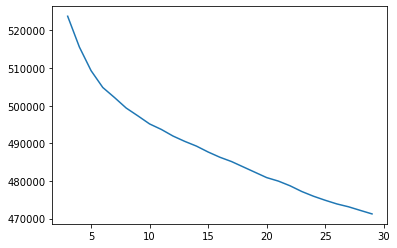

In [40]:
plt.plot(list(elbow.keys()),list(elbow.values()))

## 2.3 Analyse the obtained clusters:

### 2.3.1 Identify the kind of products in the cluster (e.g., chips, tea, coffee) using a visualization called word cloud.

In [112]:
dataset['Description']=dfn['Discription']

In [113]:
dataset

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Datetime,cluster,Description
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,"[good, quality, dog, food]","[bought, several, vitality, canned, dog, food,...",2011-04-27,14,good quality dog food bought several vitality ...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,[advertised],"[product, arrived, labeled, jumbo, salted, pea...",2012-09-07,13,advertised product arrived labeled jumbo salte...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"[delight, say]","[confection, around, century, light, pillowy, ...",2008-08-18,3,delight say confection around century light pi...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,"[cough, medicine]","[looking, secret, ingredient, robitussin, beli...",2011-06-13,8,cough medicine looking secret ingredient robit...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,"[great, taffy]","[great, taffy, great, price, wide, assortment,...",2012-10-21,3,great taffy great taffy great price wide assor...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
568449,568450,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,0,0,5,1299628800,[without],"[great, sesame, chicken, good, better, restura...",2011-03-09,3,without great sesame chicken good better restu...
568450,568451,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,0,0,2,1331251200,[disappointed],"[disappointed, flavor, chocolate, note, especi...",2012-03-09,8,disappointed disappointed flavor chocolate not...
568451,568452,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",2,2,5,1329782400,"[perfect, maltipoo]","[star, small, give, one, training, session, tr...",2012-02-21,14,perfect maltipoo star small give one training ...
568452,568453,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",1,1,5,1331596800,"[favorite, training, reward, treat]","[best, treat, training, rewarding, dog, good, ...",2012-03-13,10,favorite training reward treat best treat trai...


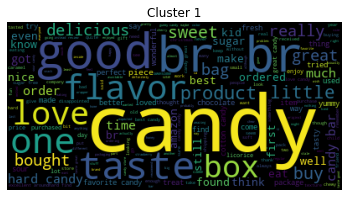

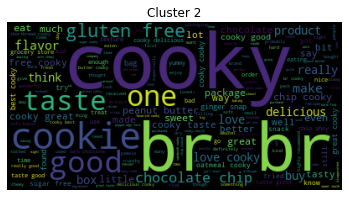

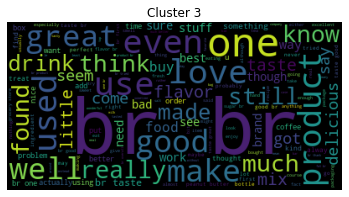

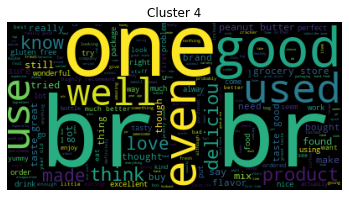

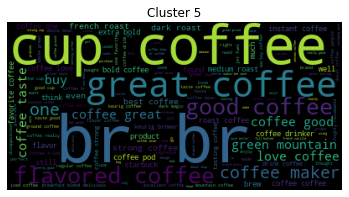

...

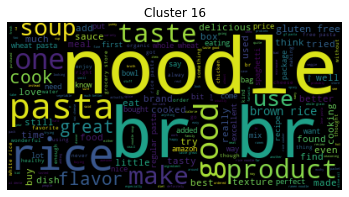

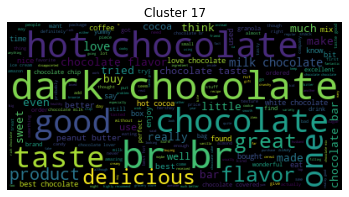

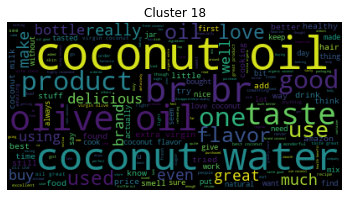

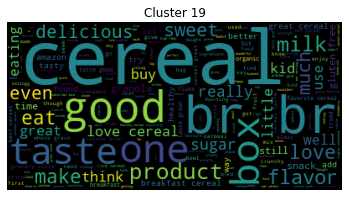

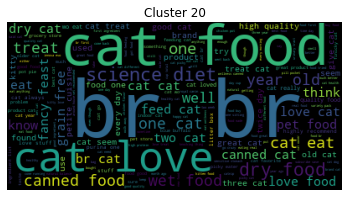

In [118]:
from wordcloud import WordCloud
for i in range(20):
    wl_space_split = " ".join(dataset[dataset.cluster==i].Description)
    my_wordcloud = WordCloud().generate(wl_space_split)
    plt.imshow(my_wordcloud)
    plt.title(f'Cluster {i+1}')
    plt.axis("off")
    plt.show()

### 2.3.2 Provide the number of product in each cluster

In [55]:
cluster = kmeans.predict(reduced)

In [56]:
dataset['cluster']=cluster

In [57]:
products_per_cluster={}
for cluster in range(0,20):
    products_per_cluster[cluster]=len(
        dataset[dataset.cluster==cluster].ProductId.unique())

In [58]:
products_per_cluster

{0: 4077,
 1: 2146,
 2: 19615,
 3: 42104,
 4: 4902,
 5: 5982,
 6: 654,
 7: 3233,
 8: 14465,
 9: 12507,
 10: 3849,
 11: 1349,
 12: 1702,
 13: 19643,
 14: 2953,
 15: 2951,
 16: 4306,
 17: 1960,
 18: 1562,
 19: 2217}

### 2.3.3 Compute the reviews' score distribution in each cluster. Once you get them, test if their mean differences are statistically significant!

In [101]:
score_distribution={}
for cluster in range(0,20):
    score_distribution[cluster]=dataset[dataset.cluster==cluster].groupby(dataset.Score).Id.count()

<AxesSubplot:ylabel='Score'>

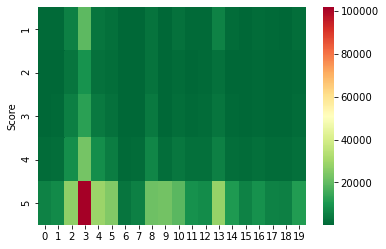

In [102]:
import seaborn as sns
sns.heatmap(pd.DataFrame(score_distribution),cmap='RdYlGn_r')

In [131]:
score_per_cluster={}
for cluster in range(0,20):
    score_per_cluster[cluster]=dataset[
        dataset.cluster==cluster].Score.mean()

In [132]:
score_per_cluster

{0: 4.223468803663423,
 1: 4.283146264468607,
 2: 3.9866756723566255,
 3: 4.07087607196906,
 4: 4.200784396862413,
 5: 4.364482615320681,
 6: 4.268120212139069,
 7: 4.3776312452447375,
 8: 4.0915321115206895,
 9: 4.791025944326157,
 10: 4.276477264666241,
 11: 4.3128036475072875,
 12: 4.286232741617357,
 13: 4.046257544385215,
 14: 4.311808707883127,
 15: 4.353225443919982,
 16: 4.212453156529259,
 17: 4.215451215451216,
 18: 4.343229543808834,
 19: 4.217022738988487}

### 2.3.4 Get the number of unique users writing reviews in each cluster 

In [76]:
user_per_cluster={}
for cluster in range(0,20):
    user_per_cluster[cluster]=len(dataset[dataset.cluster==cluster].UserId.unique())

In [77]:
user_per_cluster

{0: 7315,
 1: 5835,
 2: 23697,
 3: 99862,
 4: 22692,
 5: 19424,
 6: 2867,
 7: 6327,
 8: 21750,
 9: 18271,
 10: 11723,
 11: 3638,
 12: 6385,
 13: 31247,
 14: 6801,
 15: 7366,
 16: 9290,
 17: 6383,
 18: 6098,
 19: 6900}

# 3. Algorithmic question
You are given an array with A with n integer numbers.

Let s = min{ A[1], ..., A[n] } and b = max { A[1], ..., A[n] }.  
Let r = b - s  
Prove that we can sort A in time O(n + r).  

In [ ]:
def countingSort(arr, maxValue):
    bucketLen = maxValue+1
    bucket = [0]*bucketLen
    sortedIndex =0
    arrLen = len(arr)
    for i in range(arrLen):
        if not bucket[arr[i]]:
            bucket[arr[i]]=0
        bucket[arr[i]]+=1
    for j in range(bucketLen):
        while bucket[j]>0:
            arr[sortedIndex] = j
            sortedIndex+=1
            bucket[j]-=1
    return arr

In [ ]:
countingSort([1,3,2,5,8,9,6,7], 9)

> Counting-Sort pesudo code:  
countingSort(array, size)  
  max <- find largest element in array  
  initialize count array with all zeros  
  for j <- 0 to size  
    find the total count of each unique element and  store the count at jth index in count array  
  for i <- 1 to max  
    find the cumulative sum and store it in count array itself  
  for j <- size down to 1  
    restore the elements to array  
decrease count of each element restored by 1  


As we can see the pseudo code of Counting Sort method, we can see that:
Overall complexity = O(max)+O(size)+O(max)+O(size) = O(max+size)=O(b+n).
So if the minimum s equal to 0, wen can sort A in time O(n+b-s) = O(n+r).  
And if the minimum is not 0, such as bigger than 0 or smaller than 0, we can change the array's minimum to 0 by minusing or adding a value.

